In [1]:
# Solving the acoustic wave equation in 1D with zero Dirichlet boundary conditions
# Comparison of 6th order FD stencil and 4th order optimized FD stencil
# Integrated RMS deviation from analytical solution will be evaluated 

In [2]:
# Import modules
%matplotlib notebook

import matplotlib.pyplot as plt
from numpy import sin, cos, pi, linspace, array, zeros, trapz, abs, shape
from scipy.integrate import quad
from devito import TimeFunction, Grid, SpaceDimension, Operator, Constant, Eq
from sympy import solve, init_printing, latex

init_printing(use_latex=True)

In [3]:
# Global constants
L = 10. # Define length of domain as a global variable
k = 100 # Number of terms in the Fourier sine series
l = 4001 # Define number of points in domain

x_vals = linspace(0, L, l) # x axis for calling u(x, t) at given t

In [4]:
# Calculate exact solution

def square_init(x): # Square function to base Fourier series off of
    if x >= 0 and x < L/4.:
        return 1.
    elif x >= L/4. and x < L/2.:
        return -1.
    else:
        return 0.

def D_n_inner(x, n): # Inner part of D_n to allow for scipy.integrate.quad to be used
    return square_init(x)*sin(n*pi*x/L)
    
def D_n_calc(n): # Define function to calculate d_n for a given n
    if n % 2 == 0:
        return (4./L)*quad(D_n_inner, 0, L/2., args=(n))[0]
    else:
        return 0.

def u(x, t): # Analytic solution calculator
    u_temp = 0.
    
    for n in range(1, 2*k+1):
        u_temp += D_n_calc(n)*sin(n*pi*x/L)*cos(n*pi*t/L)
        
    return u_temp

In [5]:
# Conventional FD solution using Devito stencil

# Set up conventional FD parameters
so_dev = 4 # 4th order accurate in space
to_dev = 2 # 2nd order accurate in time


extent = (L,) # Grid is L long with l grid points
shape = (l,)

# dt is defined using Courant condition (c = 1)
# dt = 0.2*(L/(shape[0]-1)) # Timestep is half critical dt (0.0025)
dt = 5e-4
t_end = 4*L # Standing wave will cycle twice(?) in time L
ns = int(t_end/dt) # Number of timesteps = total time/timestep size

In [6]:
# Define x as spatial dimention for Sympy
x = SpaceDimension(name='x', spacing=Constant(name='h_x', value=extent[0]/(shape[0]-1)))
grid = Grid(extent=extent, shape=shape, dimensions=(x,))
time = grid.time_dim

# Set up function and stencil
u_dev = TimeFunction(name="u_dev", grid=grid, space_order=so_dev, time_order=to_dev, save=ns+1)
stencil_dev = Eq(u_dev.forward, solve(u_dev.dx2 - u_dev.dt2, u_dev.forward)[0])

bc = [Eq(u_dev[time+1,0], 0.0)] # Specify boundary conditions
bc += [Eq(u_dev[time+1,-1], 0.0)]

In [7]:
# Functions for initalizing standing square wave
def b_n_inner(x, n): # Inner part of b_n to allow for scipy.integrate.quad to be used
    return square_init(x)*sin(2.*n*pi*x/L)

def b_n_calc(n):
    return (4./L)*quad(b_n_inner, 0, L/2., args=(n))[0]
    
def u_init(x):
    u_temp = 0.
    for n in range(1, k+1):
        u_temp += b_n_calc(n)*sin(2.*n*pi*x/L)
        
    return u_temp

# Initialize wavefield
u_dev.data[:] = 0.1*u_init(linspace(0, L, u_dev.data.shape[1]))

In [8]:
# Create operator
op_dev = Operator([stencil_dev] + bc)

# Apply operator
op_dev.apply(time_M=ns-1, dt=dt)

Operator `Kernel` run in 0.52 s


PerformanceSummary([('section0',
  PerfEntry(time=0.5165379999999851, gflopss=0.0, gpointss=0.0, oi=0.0, ops=0, itershapes=[]))])

In [9]:
# Optimized FD solution

# Set up optimized FD parameters
so_opt = 4 # 6th order accurate in space
to_opt = 2 # 2nd order accurate in time
time = grid.time_dim
h_x = grid.spacing[0]

In [10]:
# Set up function and stencil
u_opt = TimeFunction(name="u_dev", grid=grid, space_order=so_opt, time_order=to_opt, save=ns+1)

# Optimized stencil coefficients
a_0 = -2.81299833
a_1 = 1.56808208
a_2 = -0.17723283
a_3 = 0.01564992

stencil_opt = Eq(u_opt.forward, solve((a_3*u_opt[time, x - 3]
                                      + a_2*u_opt[time, x - 2]
                                      + a_1*u_opt[time, x - 1]
                                      + a_0*u_opt[time, x]
                                      + a_1*u_opt[time, x + 1]
                                      + a_2*u_opt[time, x + 2]
                                      + a_3*u_opt[time, x + 3])/h_x**2
                                      - u_opt.dt2, u_opt.forward)[0])
bc = [Eq(u_opt[time+1,0], 0.0)] # Specify boundary conditions
bc += [Eq(u_opt[time+1,-1], 0.0)]

In [11]:
# Initialize wavefield
u_opt.data[:] = 0.1*u_init(linspace(0, L, u_opt.data.shape[1]))

In [12]:
# Create operator
op_opt = Operator([stencil_opt] + bc)

# Apply operator
op_opt.apply(time_M=ns-1, dt=dt)

Operator `Kernel` run in 0.45 s


PerformanceSummary([('section0',
  PerfEntry(time=0.4470239999996605, gflopss=0.0, gpointss=0.0, oi=0.0, ops=0, itershapes=[]))])

<IPython.core.display.Javascript object>


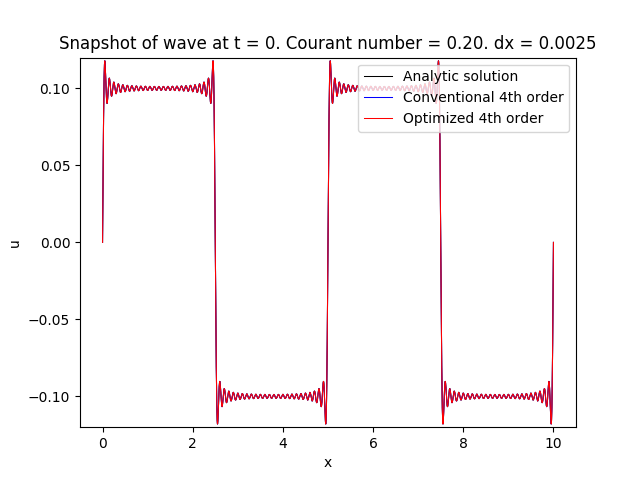

/home/ed/.local/lib/python3.6/site-packages/ipykernel/__main__.py:18: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.


<IPython.core.display.Javascript object>


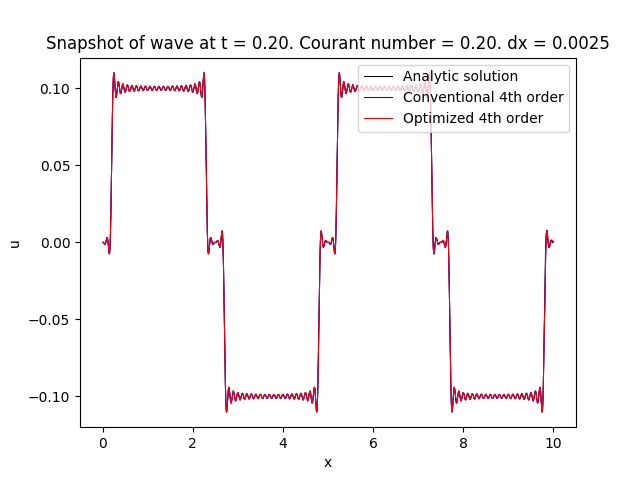

<IPython.core.display.Javascript object>


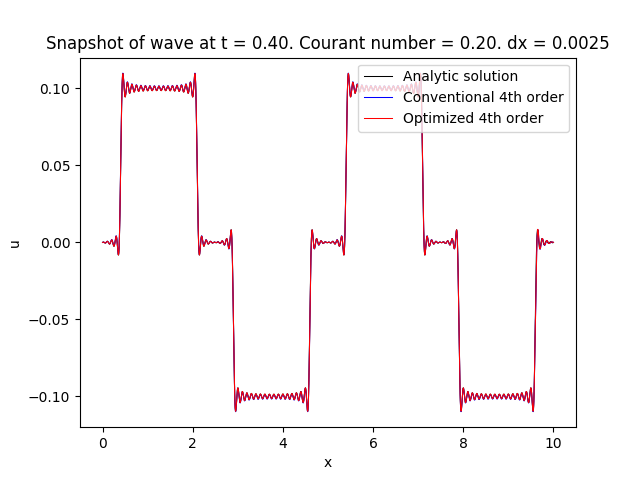

<IPython.core.display.Javascript object>


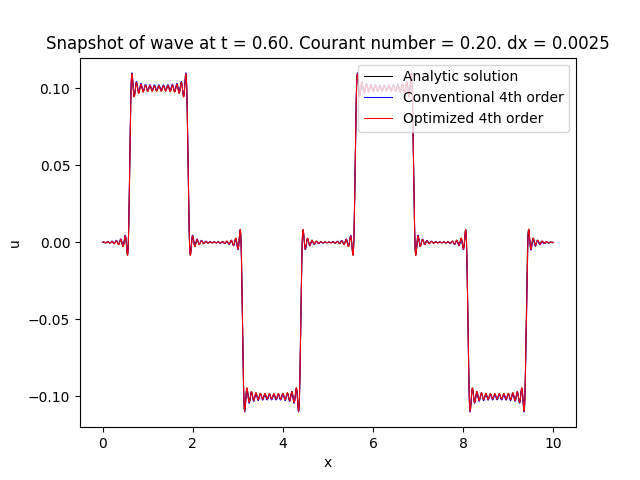

<IPython.core.display.Javascript object>


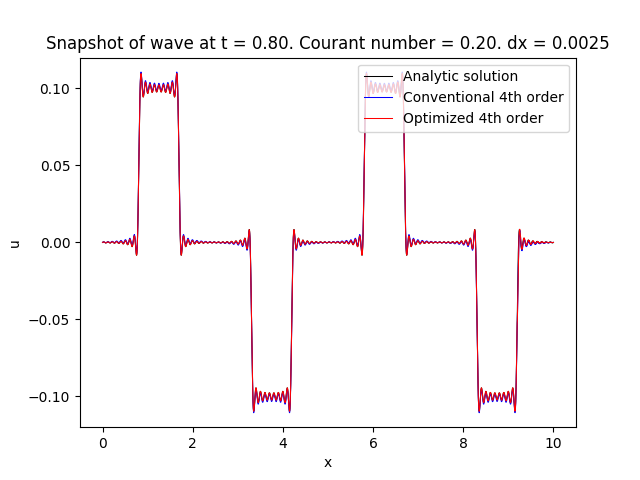

<IPython.core.display.Javascript object>


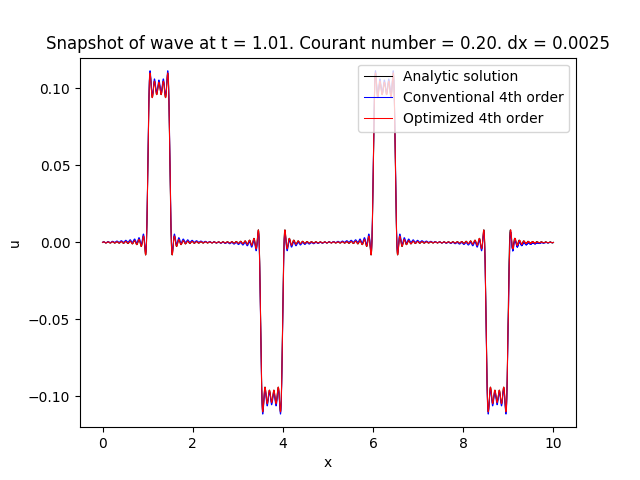

<IPython.core.display.Javascript object>


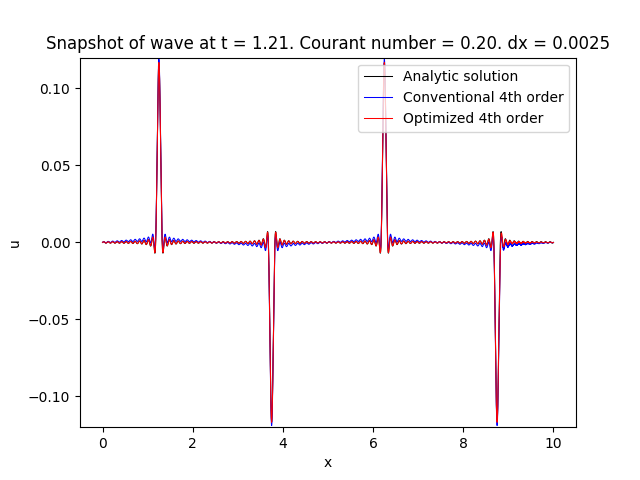

<IPython.core.display.Javascript object>


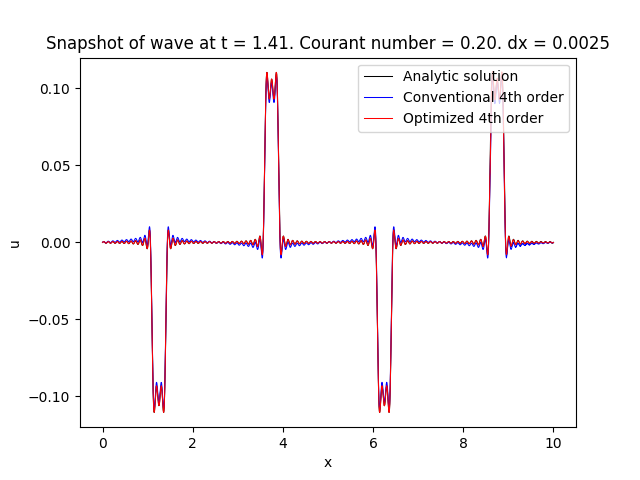

<IPython.core.display.Javascript object>


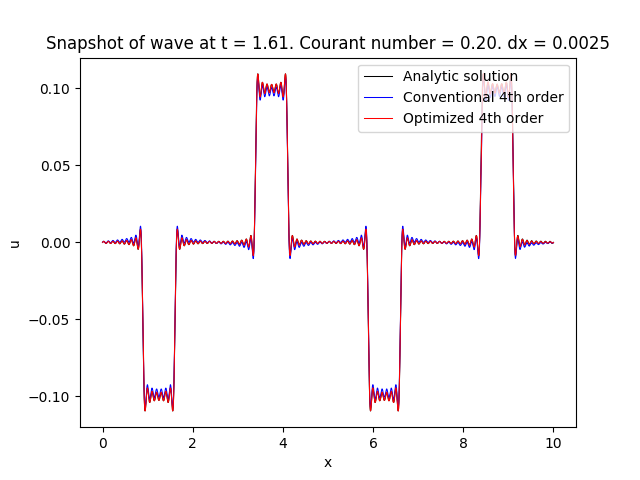

<IPython.core.display.Javascript object>


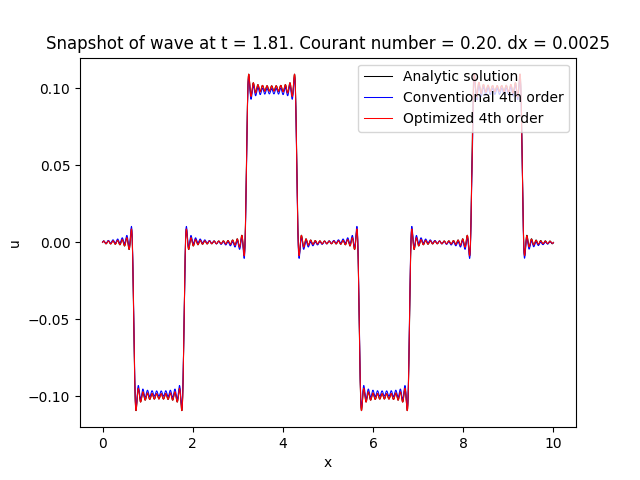

<IPython.core.display.Javascript object>


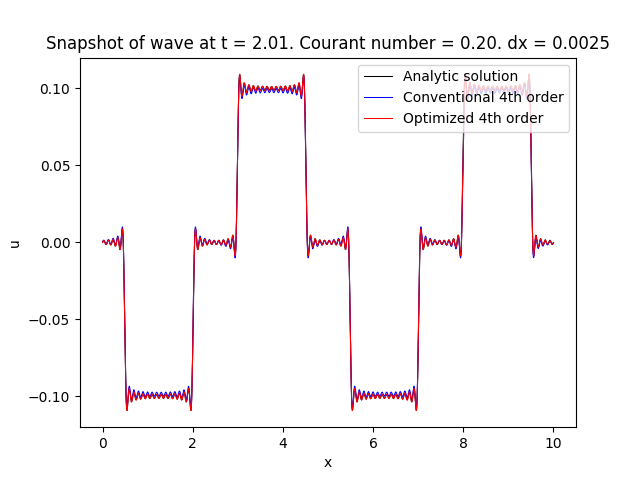

<IPython.core.display.Javascript object>


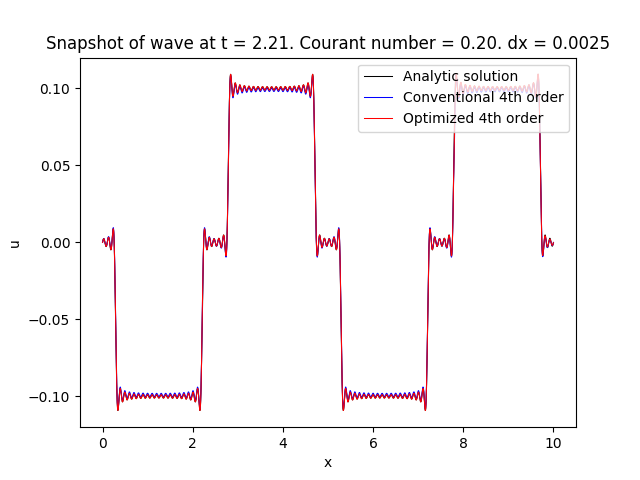

<IPython.core.display.Javascript object>


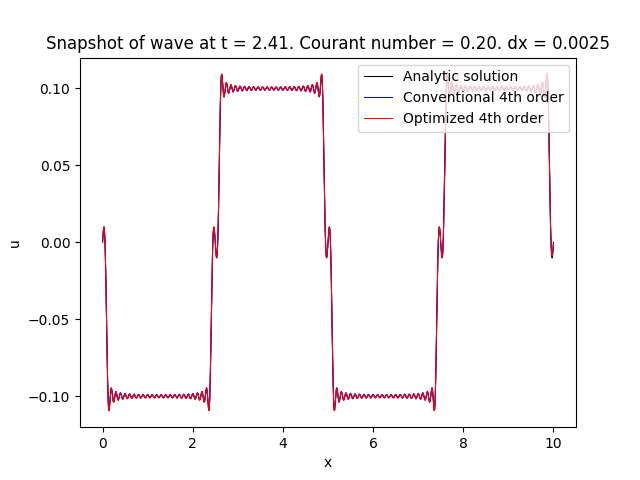

<IPython.core.display.Javascript object>


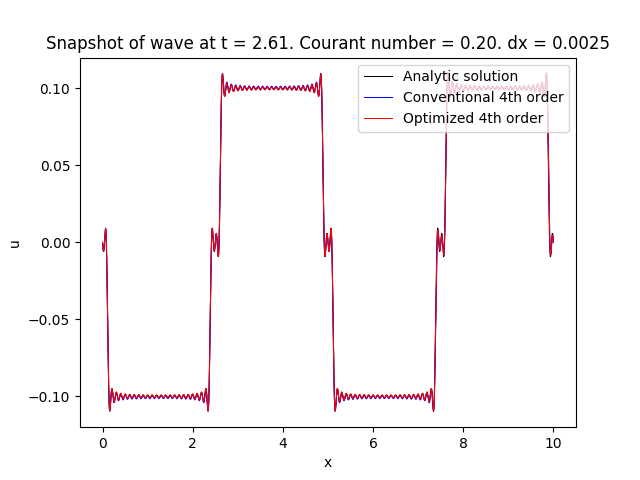

<IPython.core.display.Javascript object>


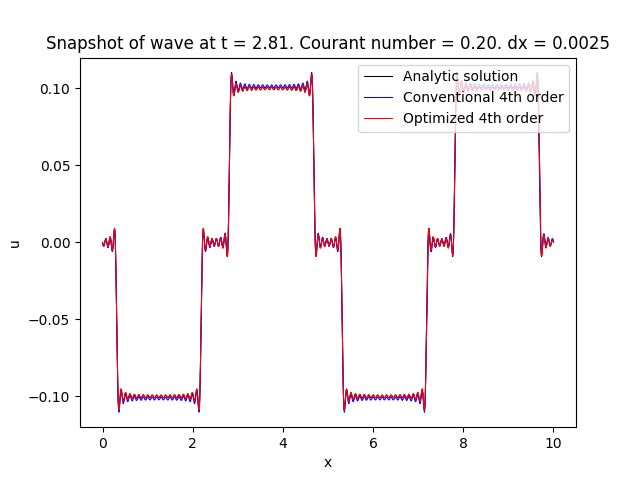

<IPython.core.display.Javascript object>


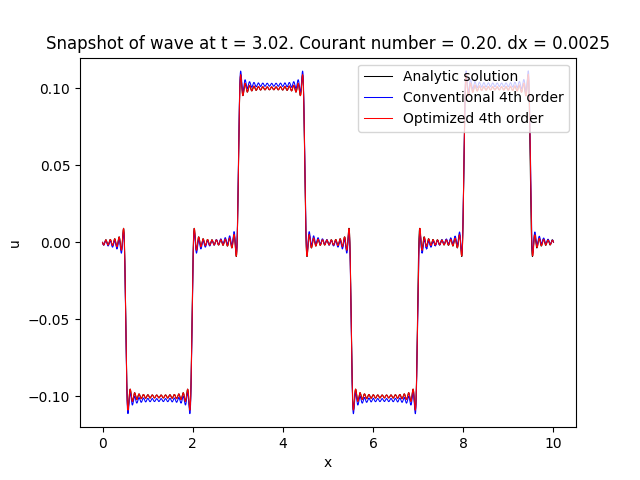

<IPython.core.display.Javascript object>


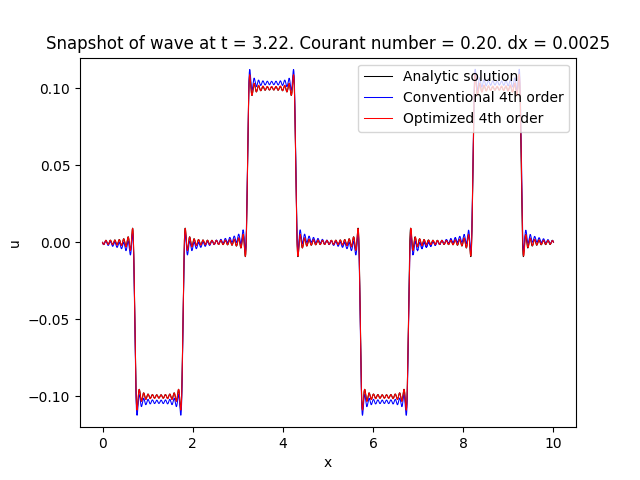

<IPython.core.display.Javascript object>


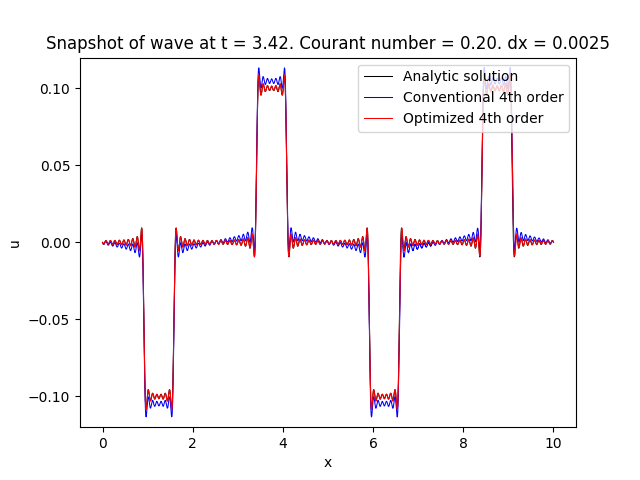

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


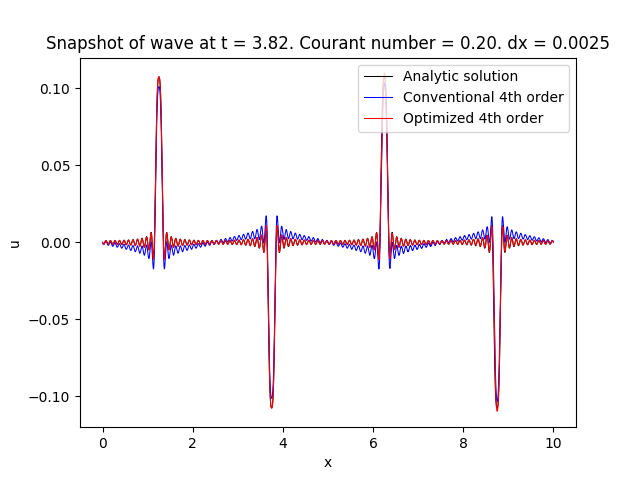

<IPython.core.display.Javascript object>


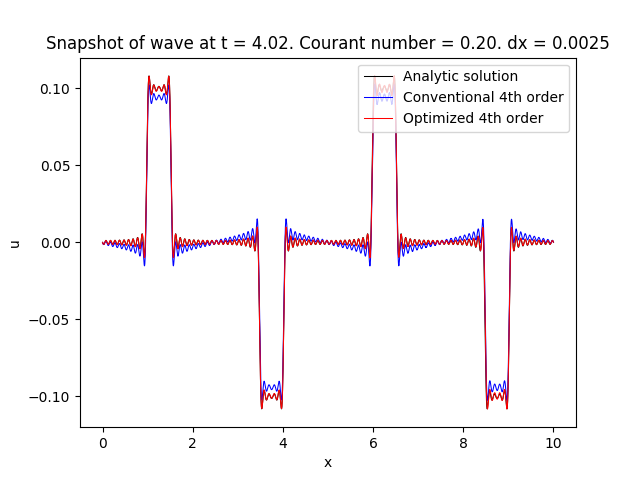

<IPython.core.display.Javascript object>


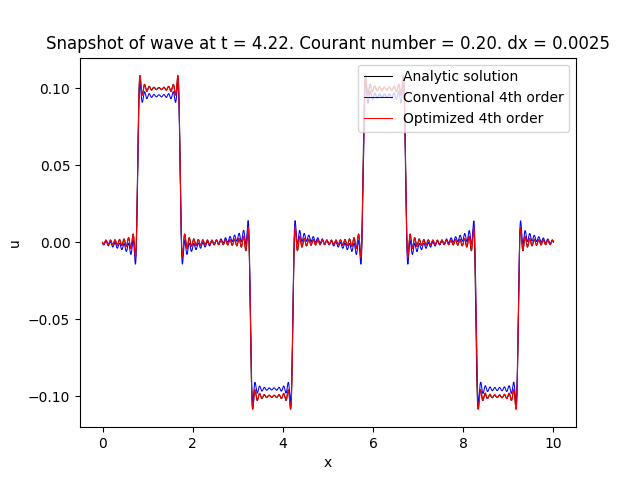

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


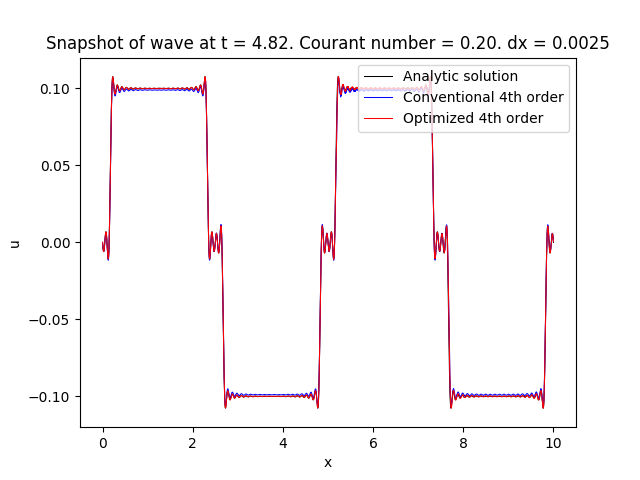

<IPython.core.display.Javascript object>


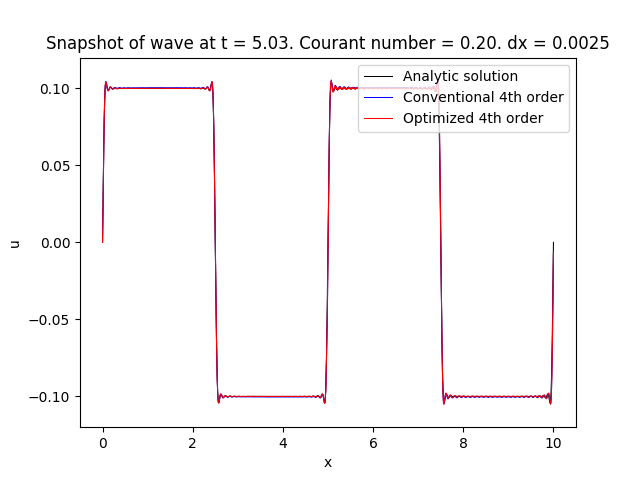

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


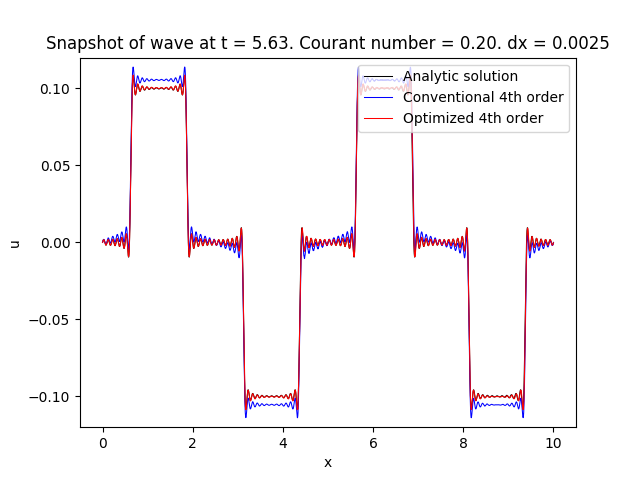

<IPython.core.display.Javascript object>


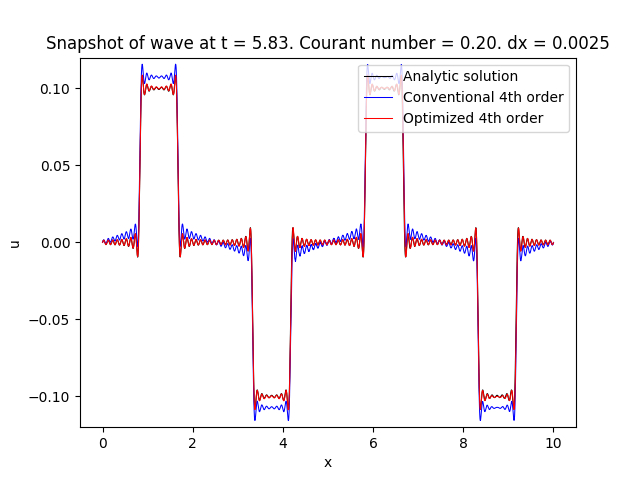

<IPython.core.display.Javascript object>


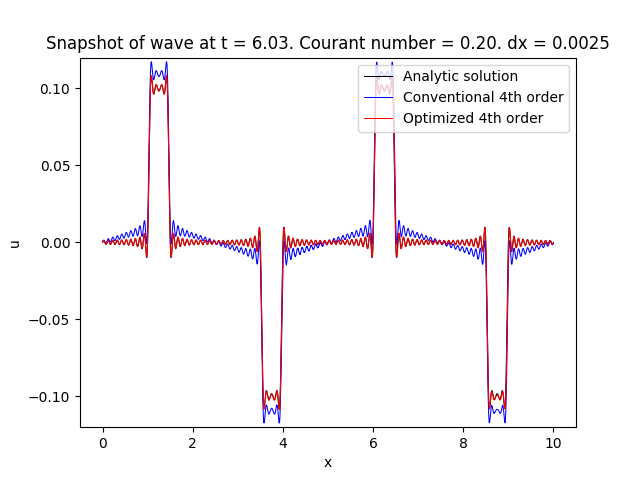

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


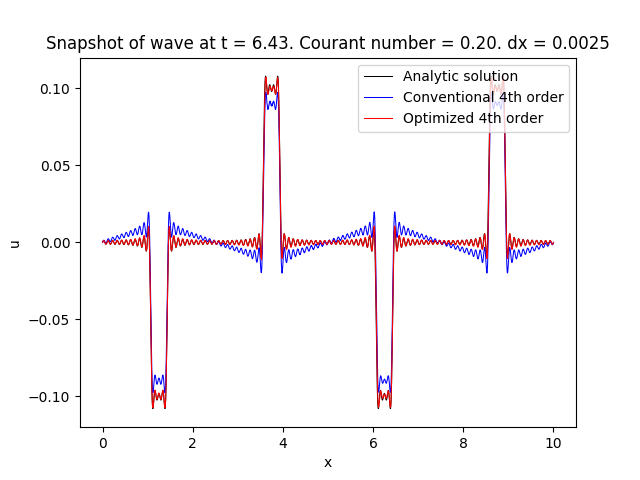

<IPython.core.display.Javascript object>


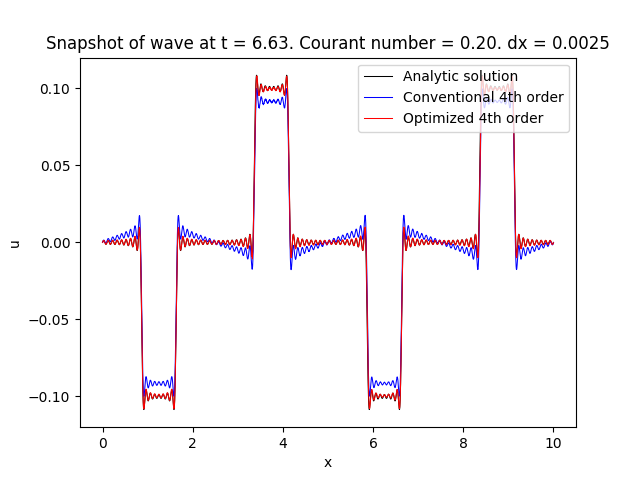

<IPython.core.display.Javascript object>


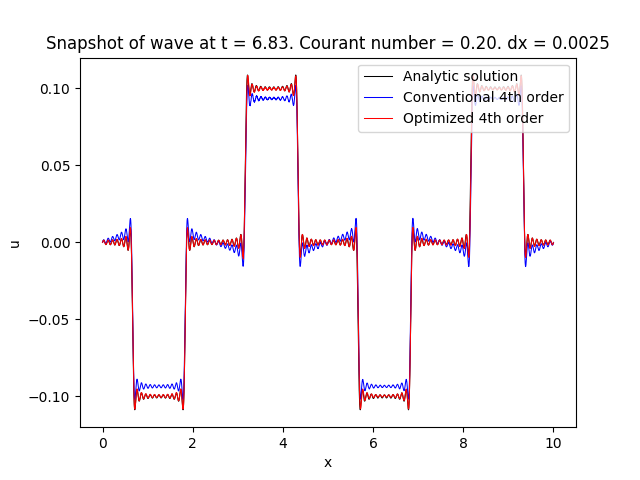

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


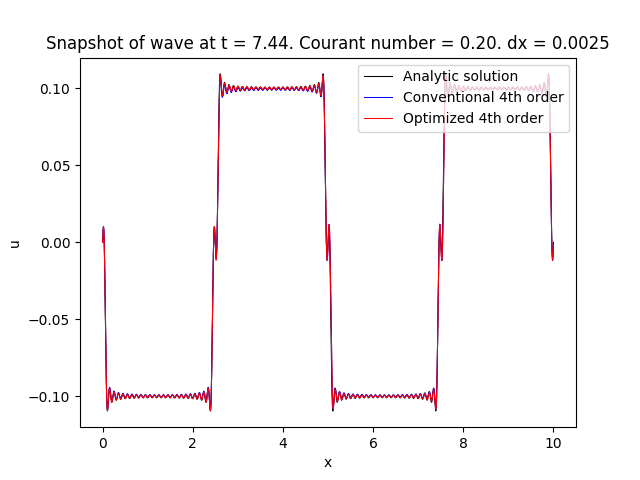

<IPython.core.display.Javascript object>


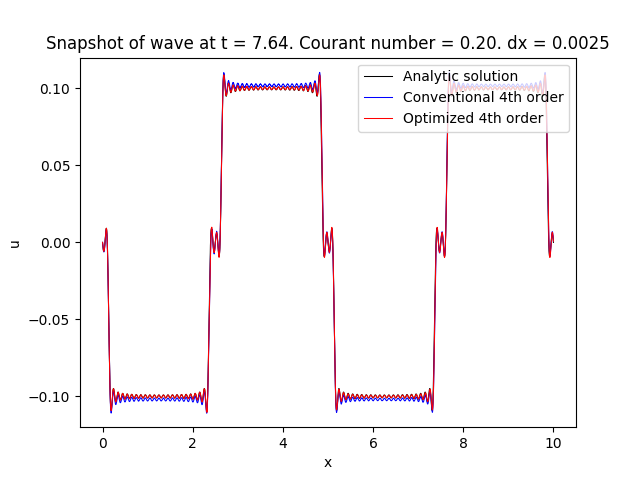

<IPython.core.display.Javascript object>


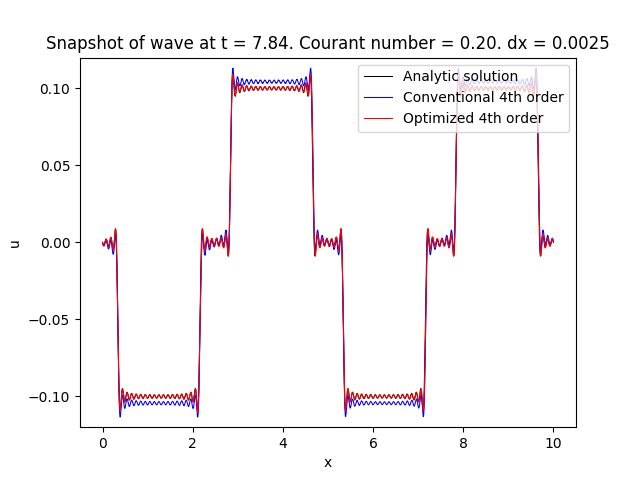

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


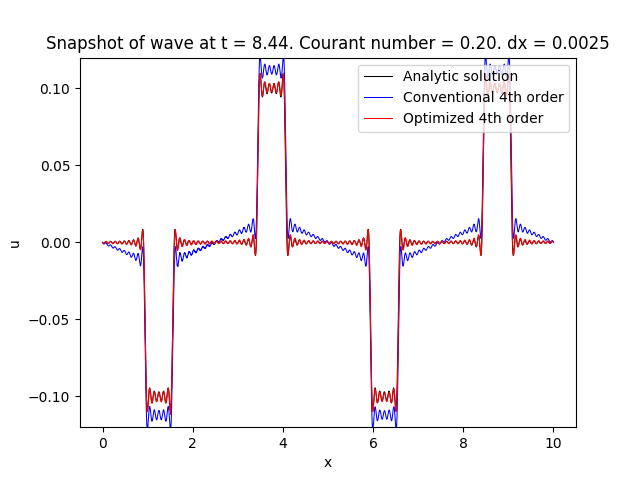

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


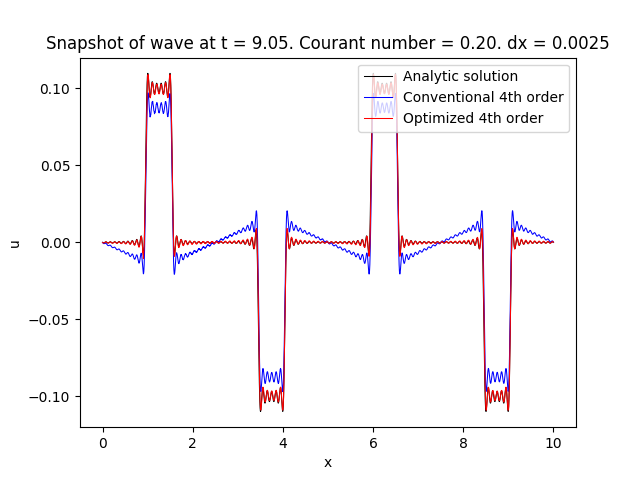

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


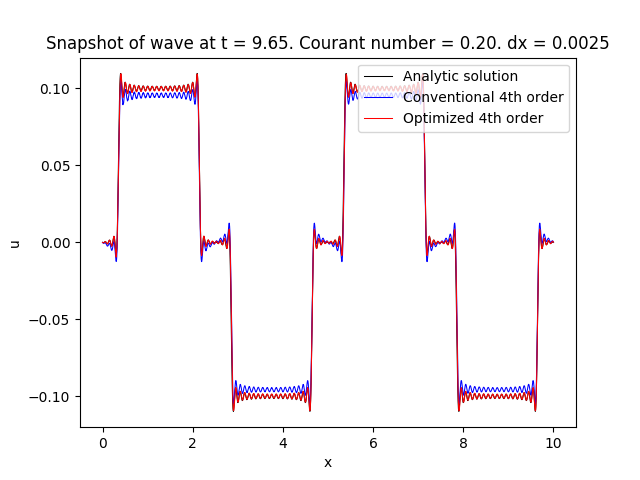

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


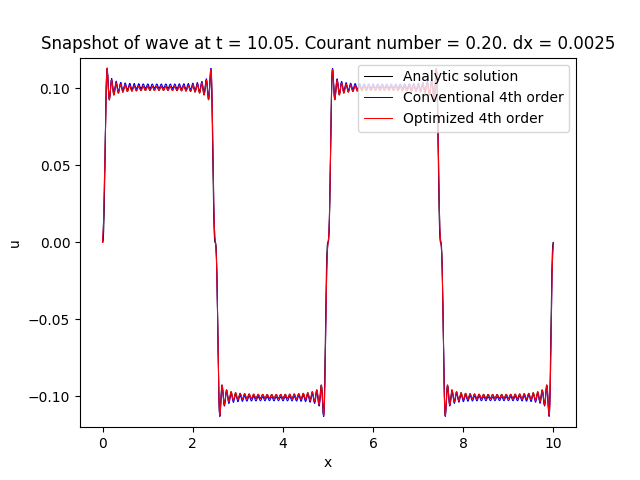

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


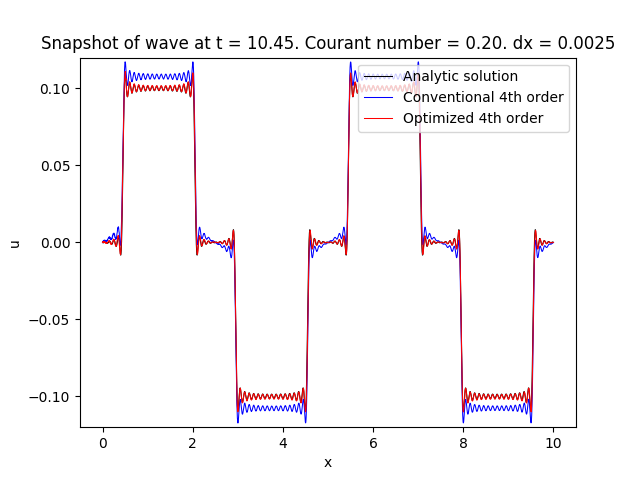

<IPython.core.display.Javascript object>


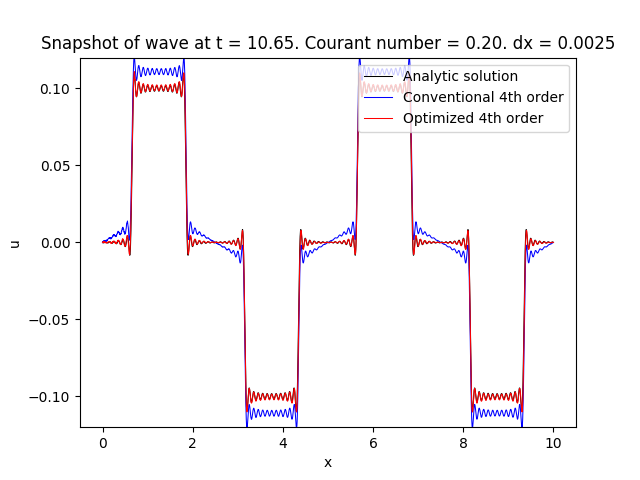

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


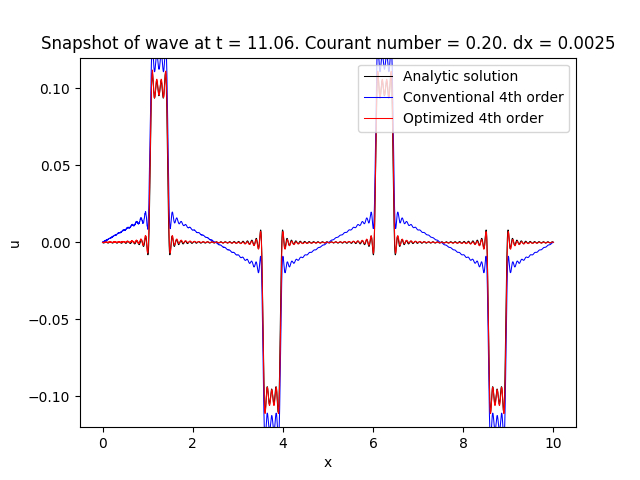

<IPython.core.display.Javascript object>


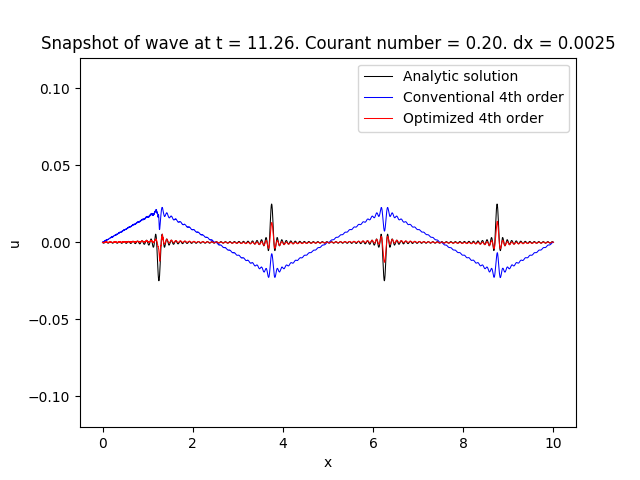

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


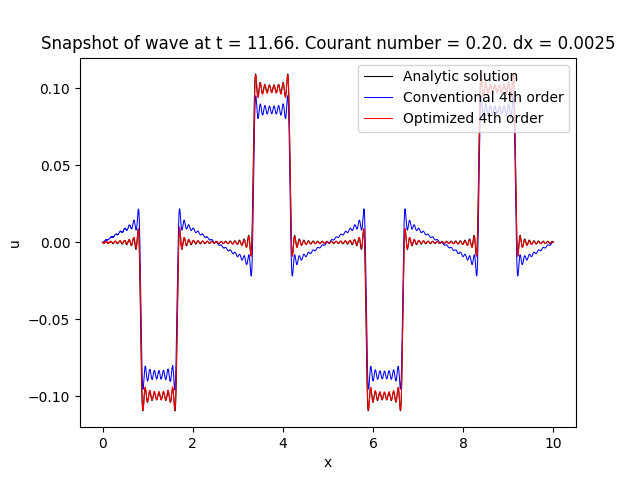

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


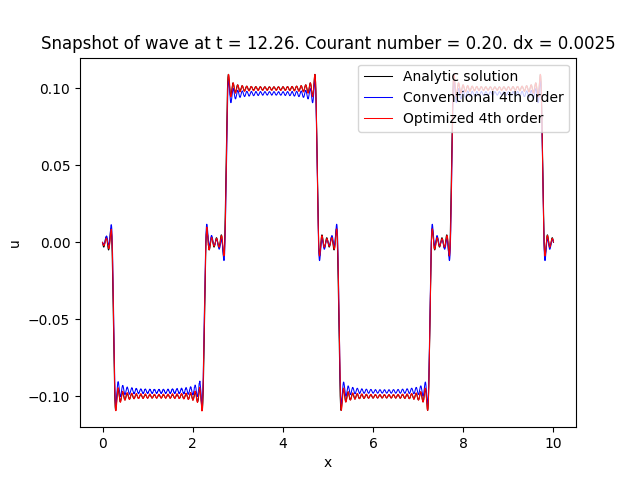

<IPython.core.display.Javascript object>


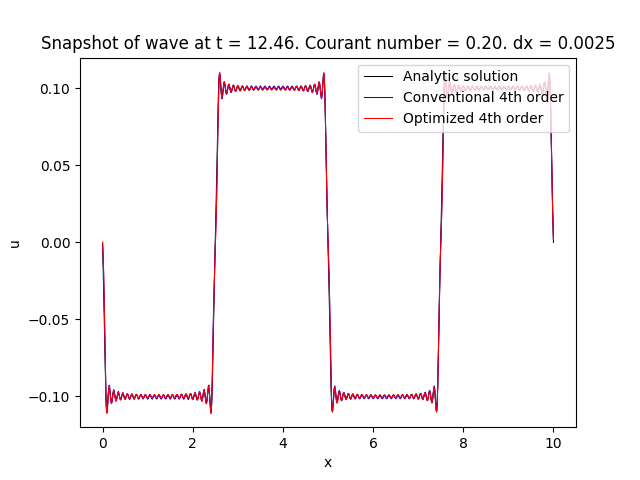

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


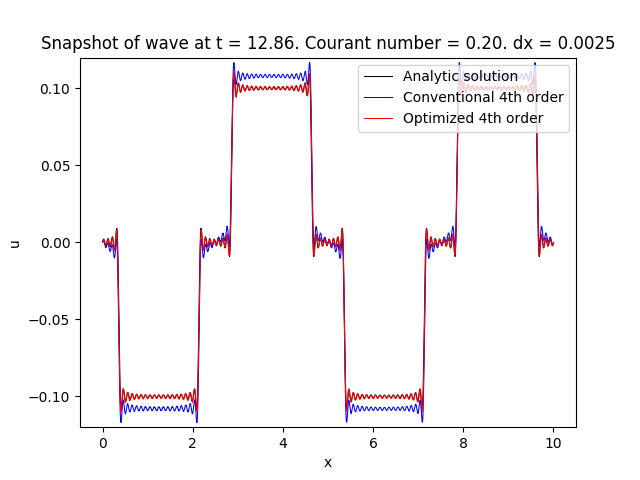

<IPython.core.display.Javascript object>


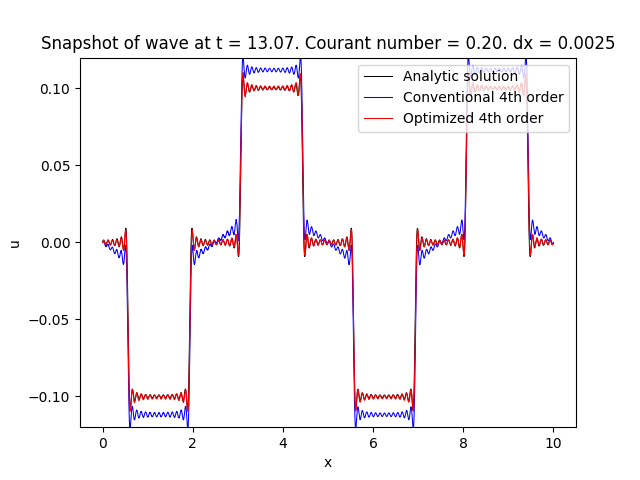

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


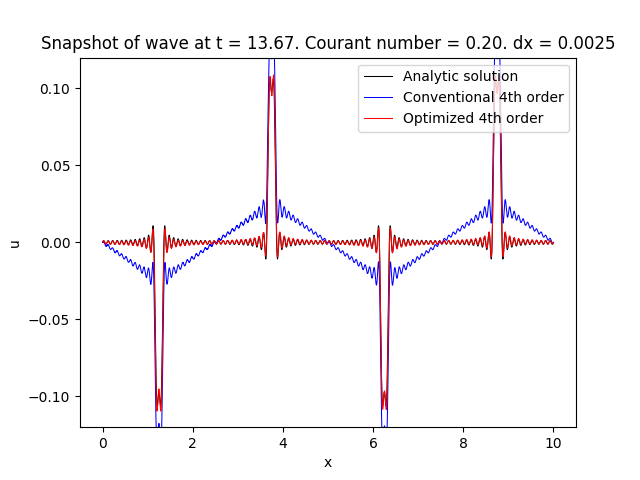

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


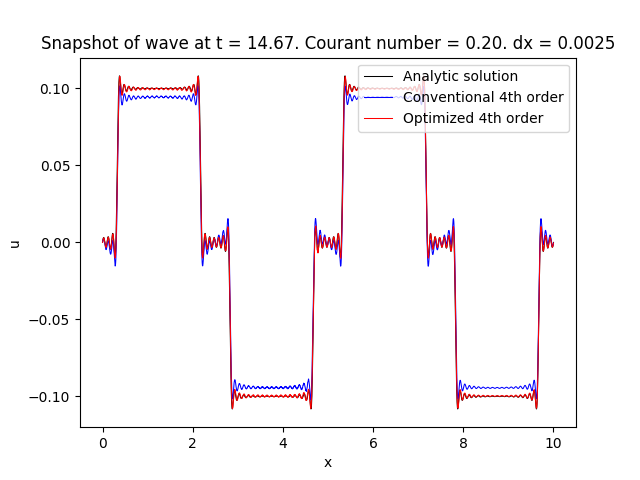

<IPython.core.display.Javascript object>


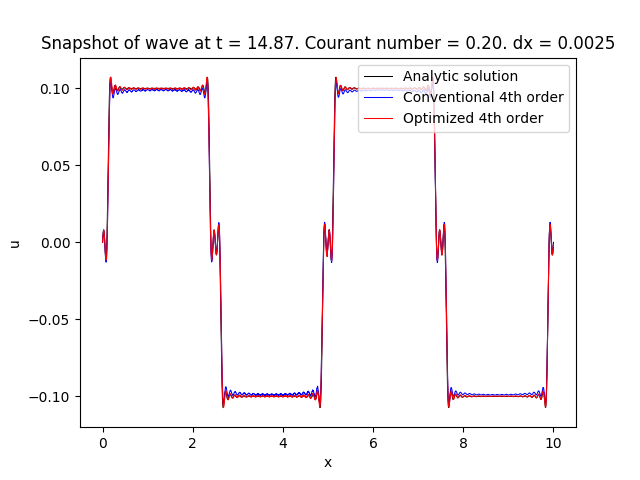

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


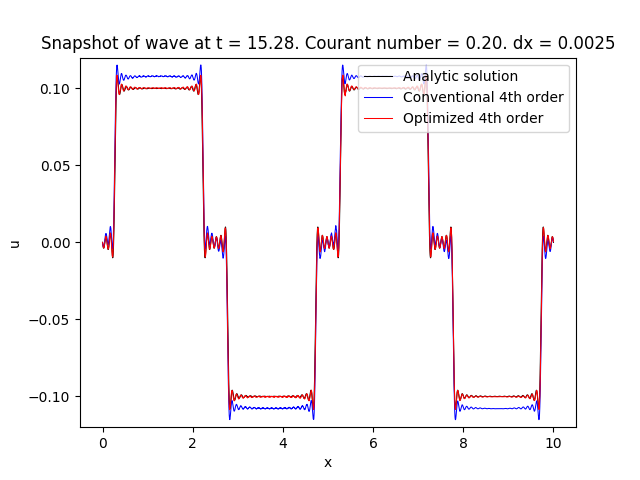

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


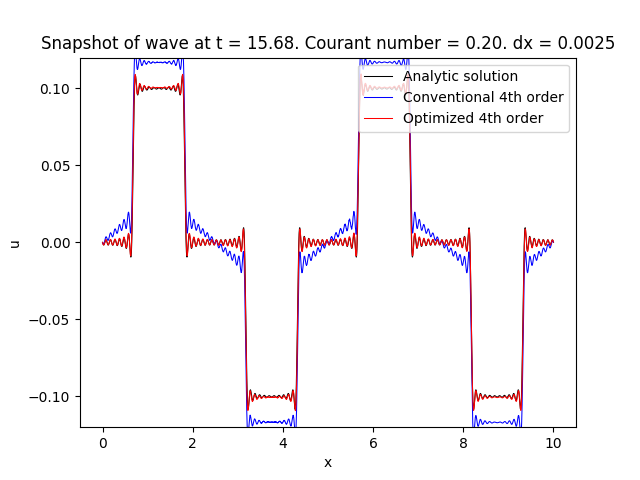

<IPython.core.display.Javascript object>


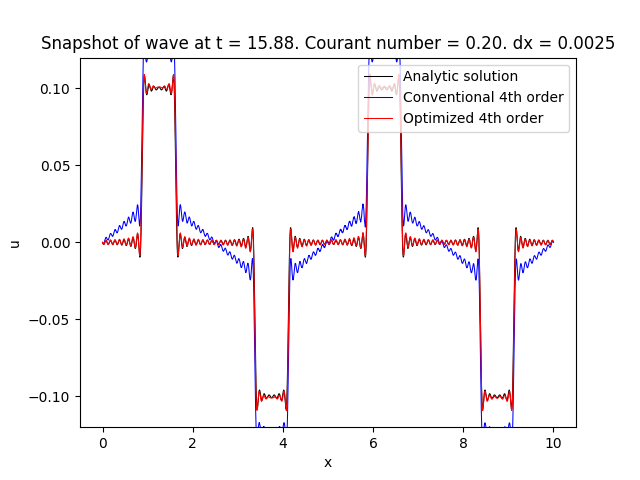

<IPython.core.display.Javascript object>


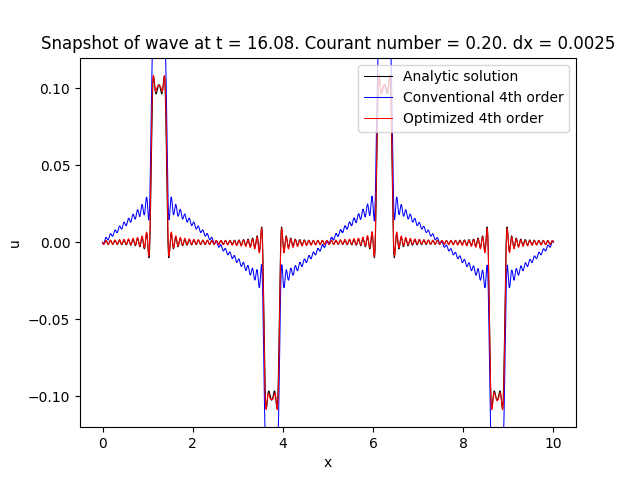

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


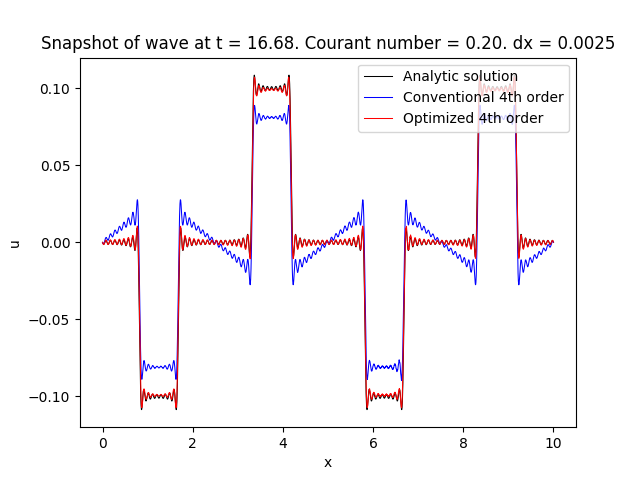

<IPython.core.display.Javascript object>


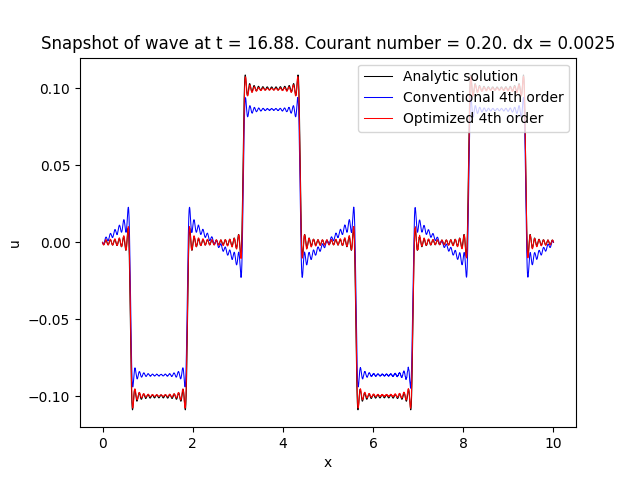

<IPython.core.display.Javascript object>


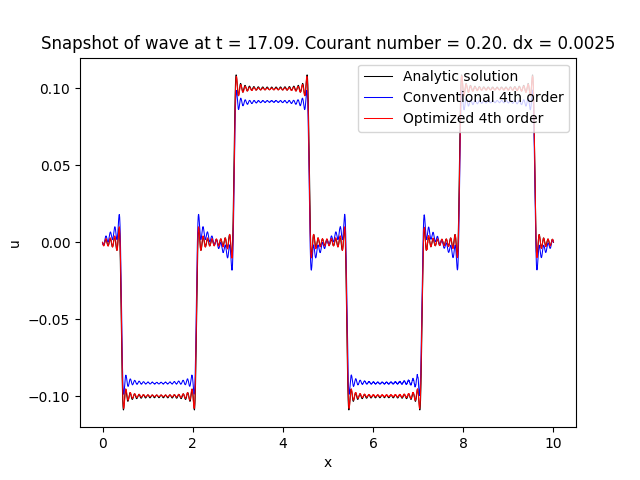

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


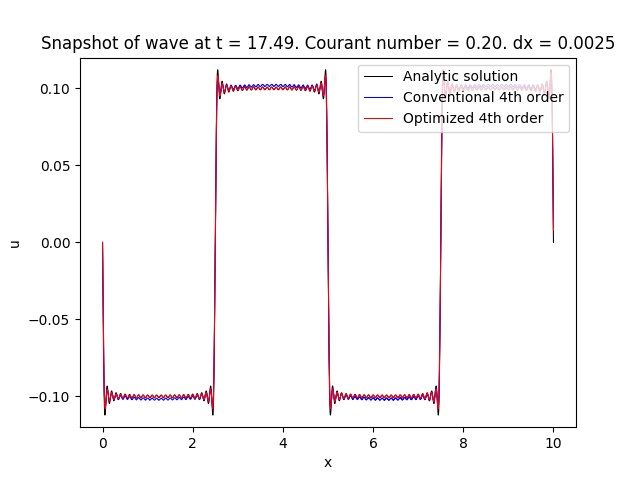

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


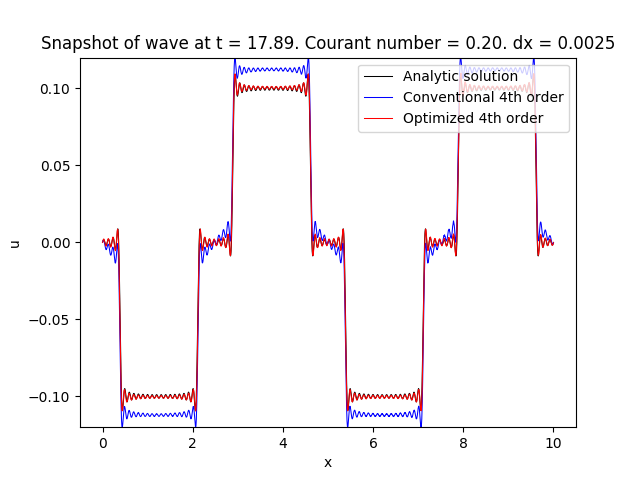

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


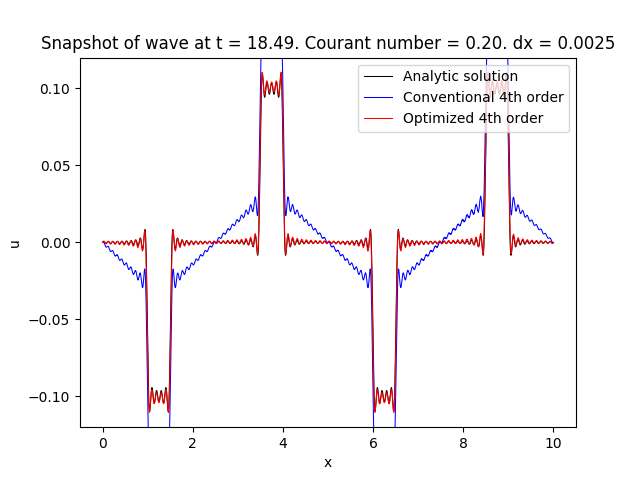

<IPython.core.display.Javascript object>


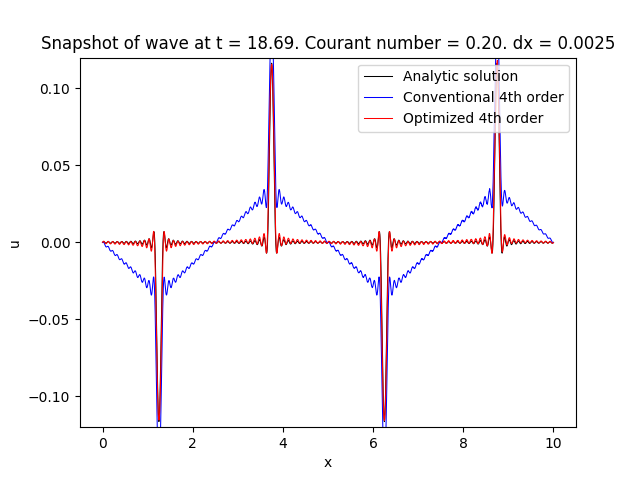

<IPython.core.display.Javascript object>


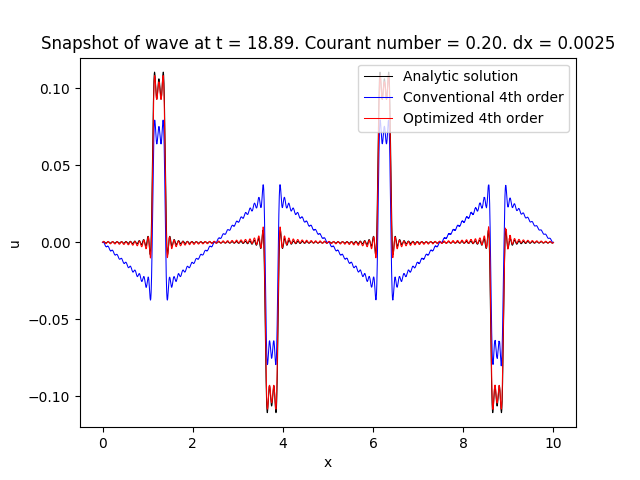

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


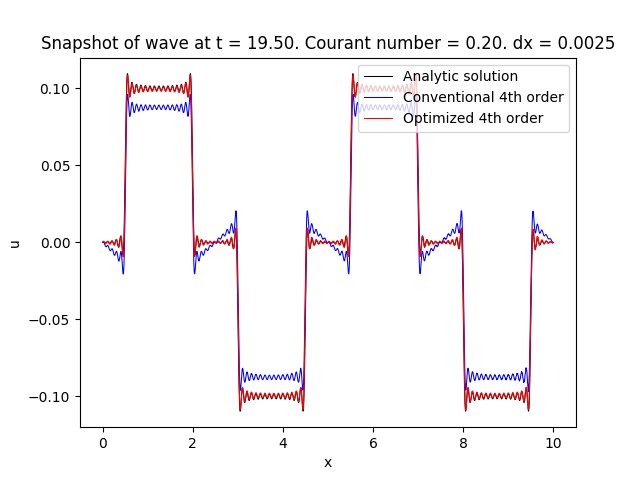

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


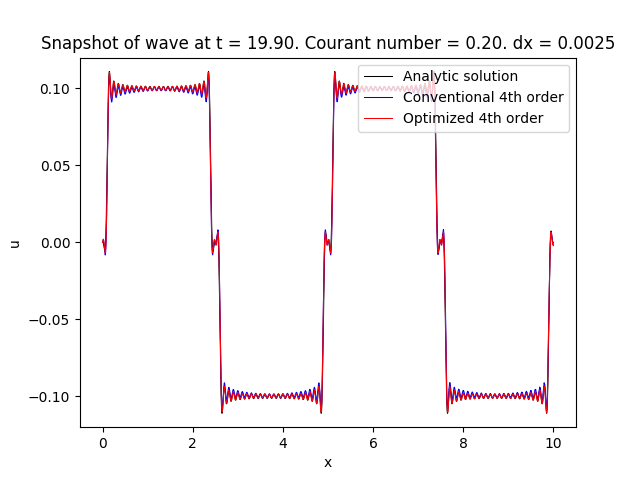

<IPython.core.display.Javascript object>


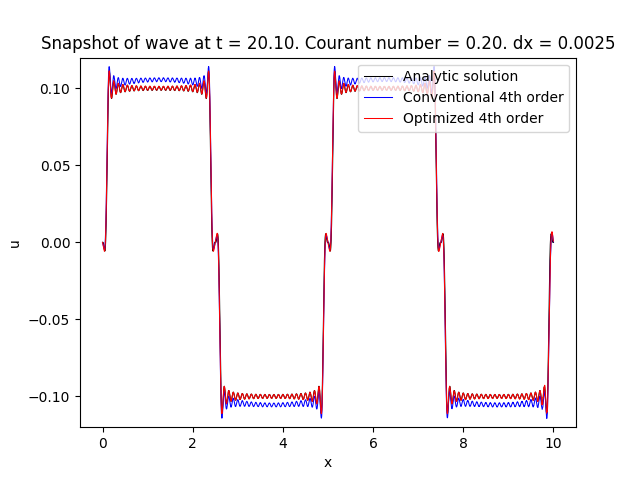

<IPython.core.display.Javascript object>


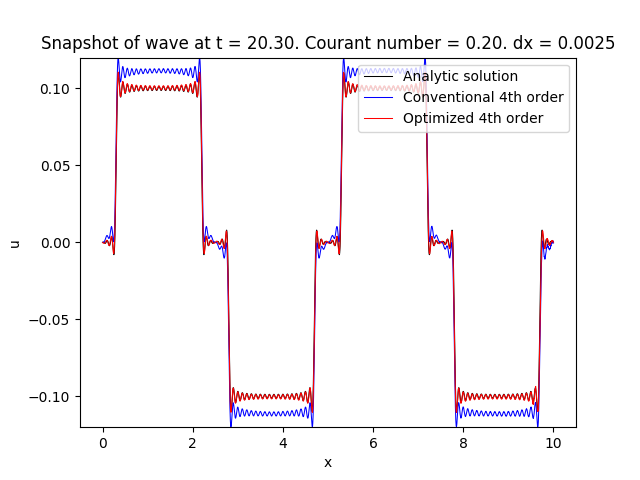

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


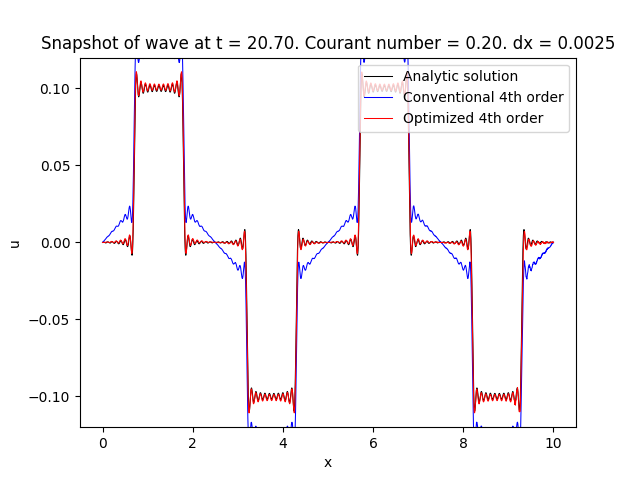

<IPython.core.display.Javascript object>


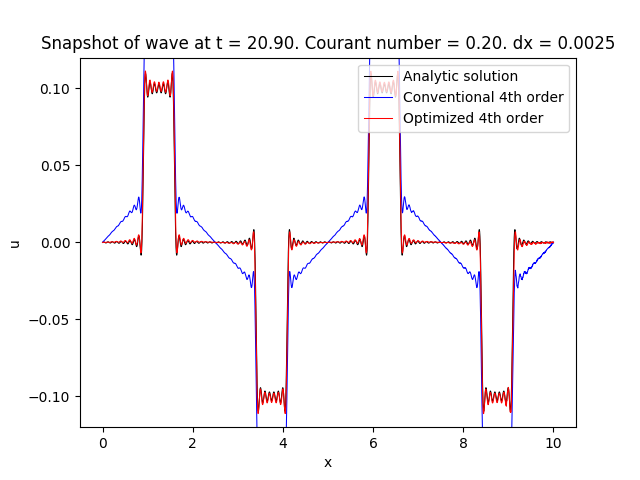

<IPython.core.display.Javascript object>


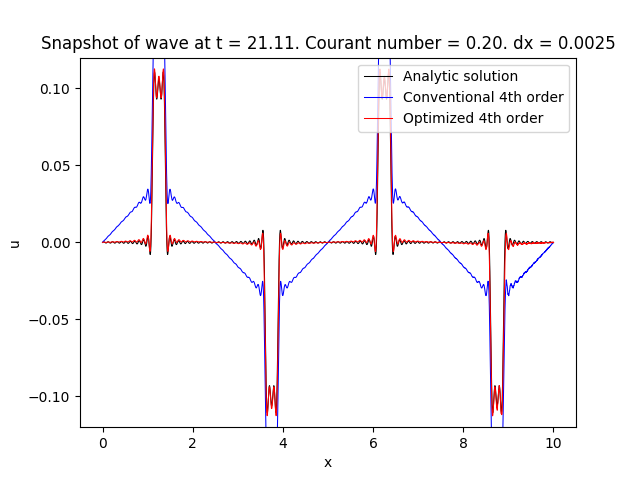

<IPython.core.display.Javascript object>


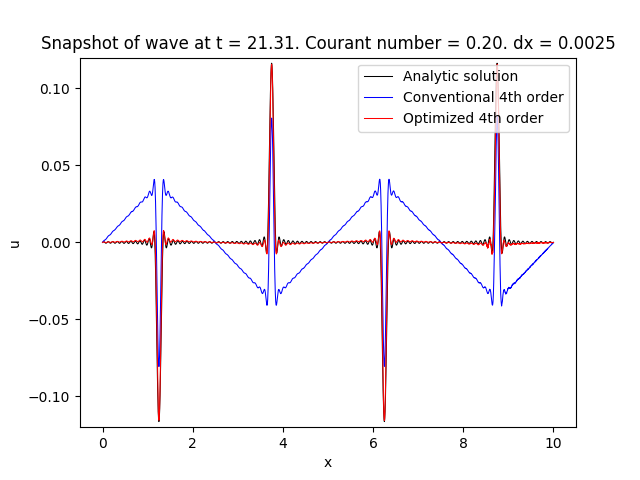

<IPython.core.display.Javascript object>


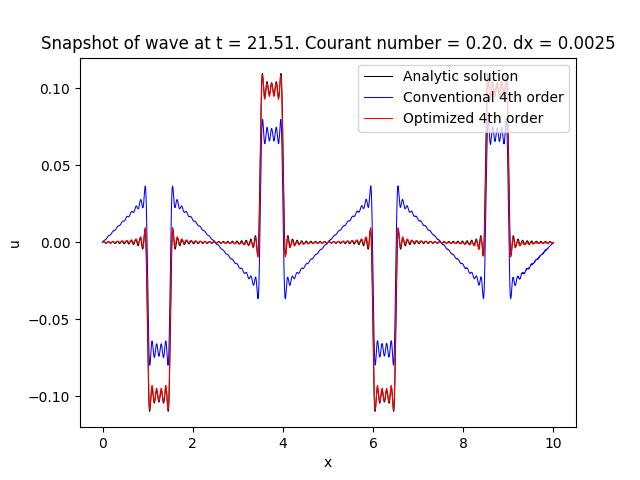

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


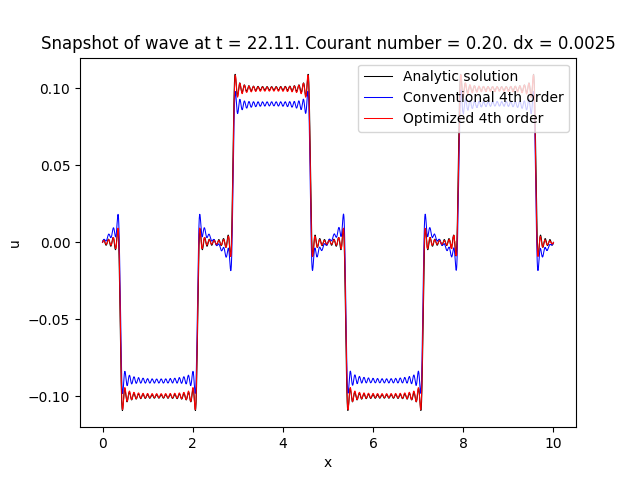

<IPython.core.display.Javascript object>


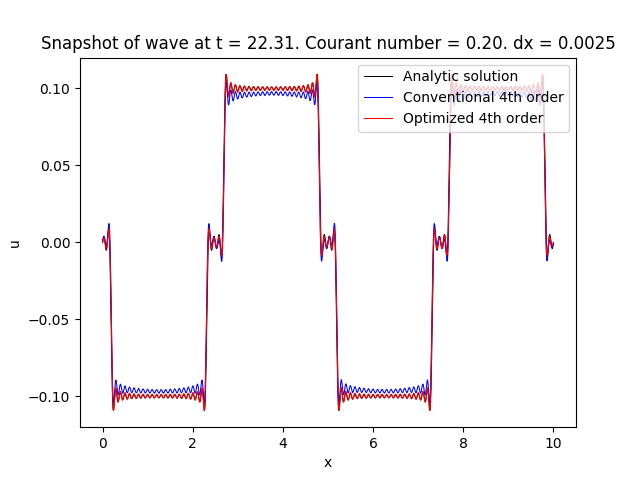

<IPython.core.display.Javascript object>


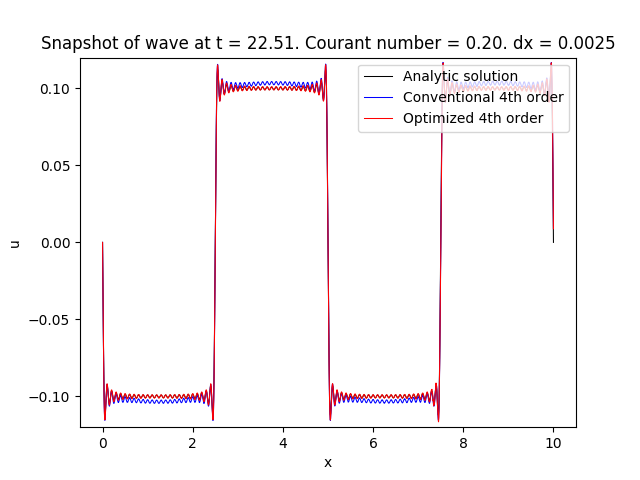

<IPython.core.display.Javascript object>


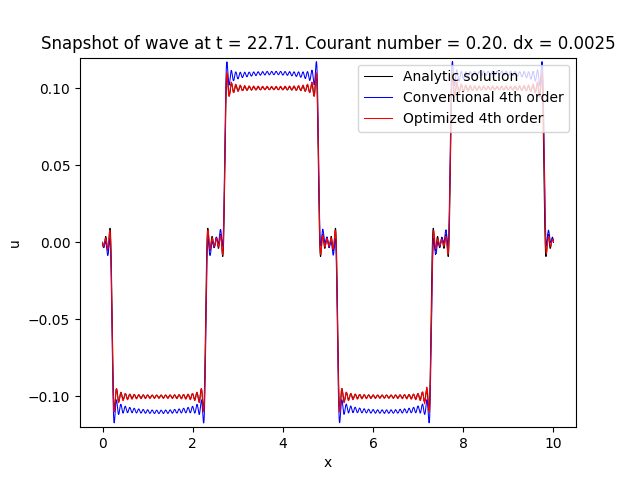

<IPython.core.display.Javascript object>


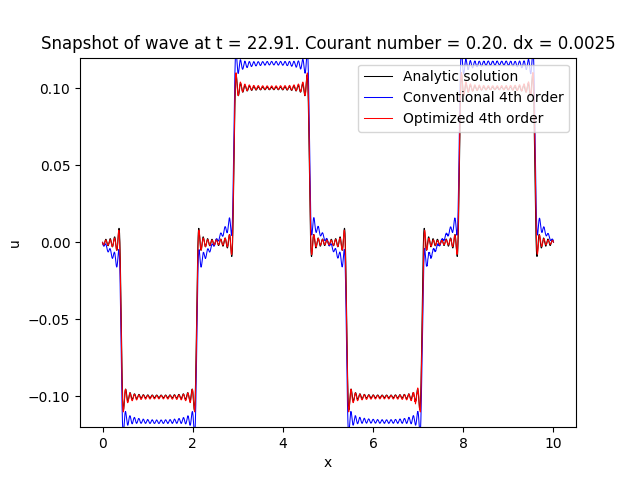

<IPython.core.display.Javascript object>


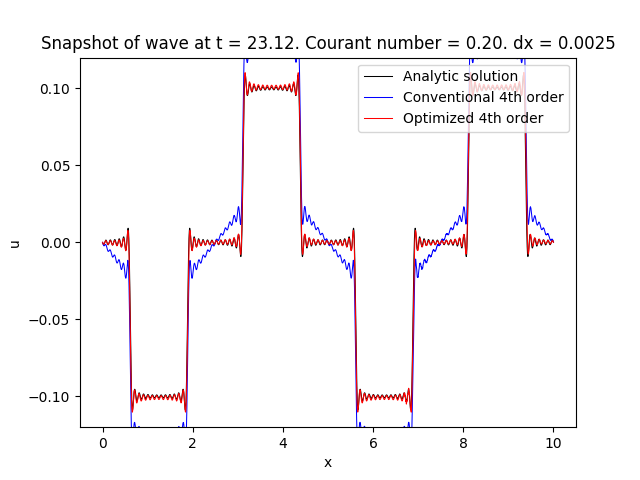

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


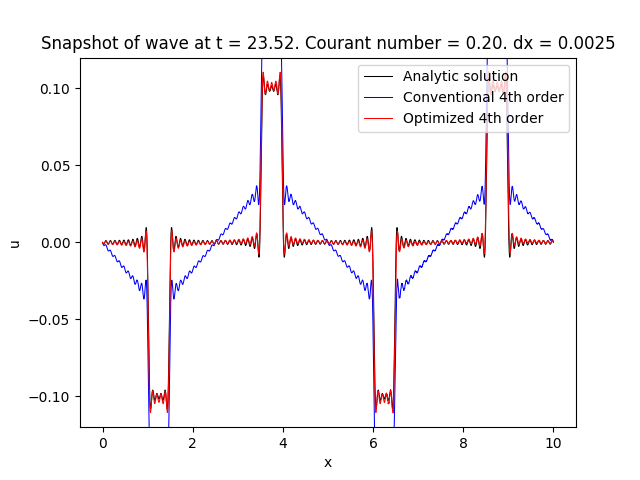

<IPython.core.display.Javascript object>


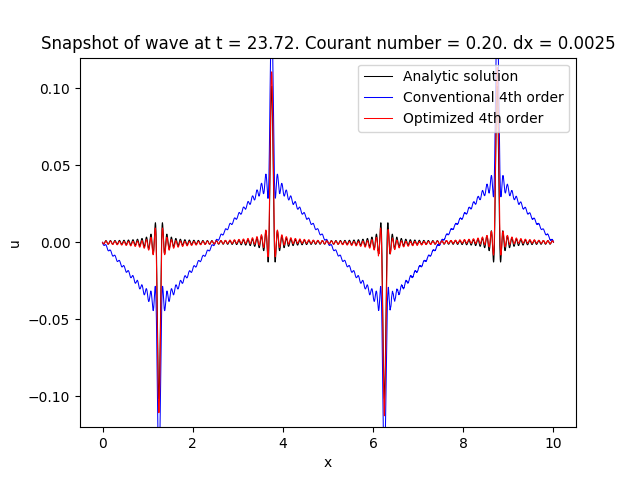

<IPython.core.display.Javascript object>


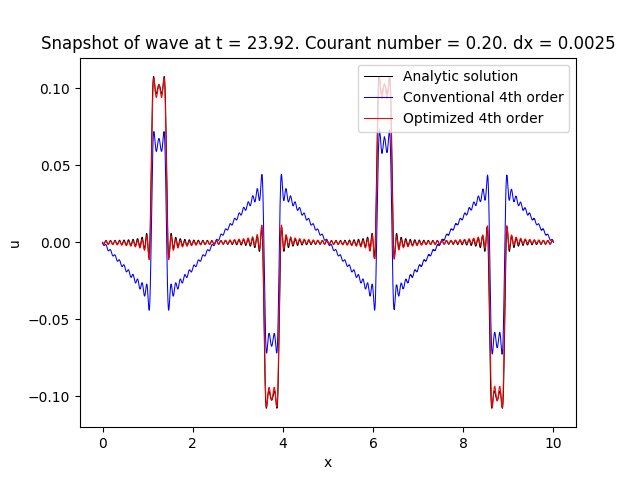

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


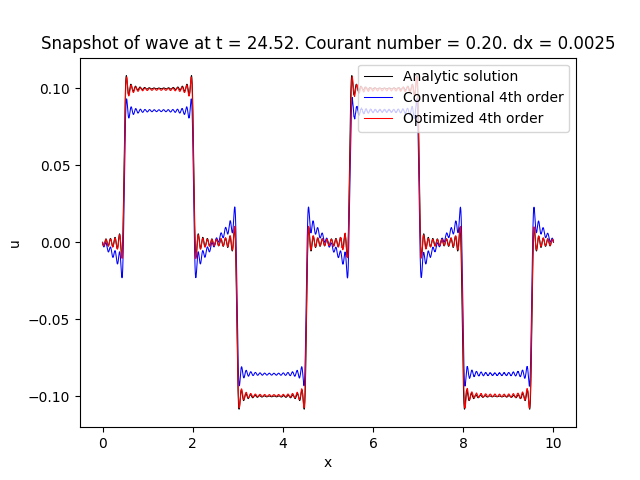

<IPython.core.display.Javascript object>


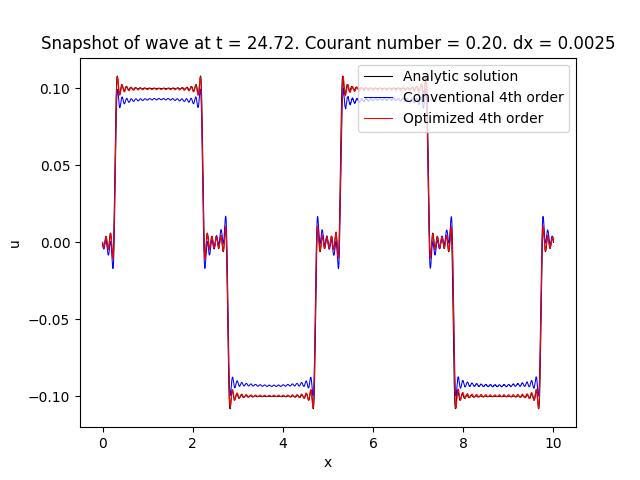

<IPython.core.display.Javascript object>


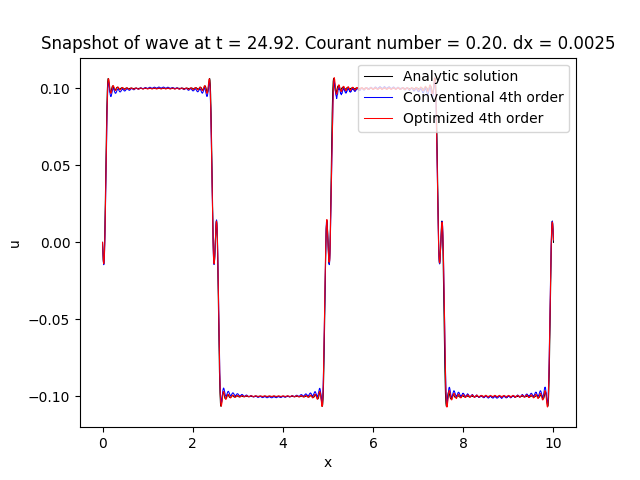

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


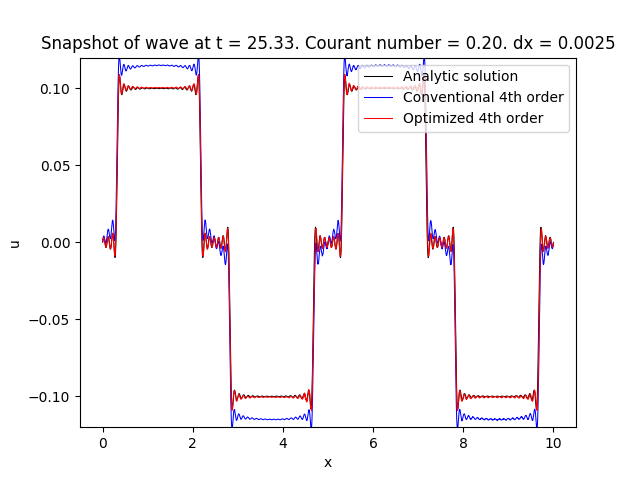

<IPython.core.display.Javascript object>


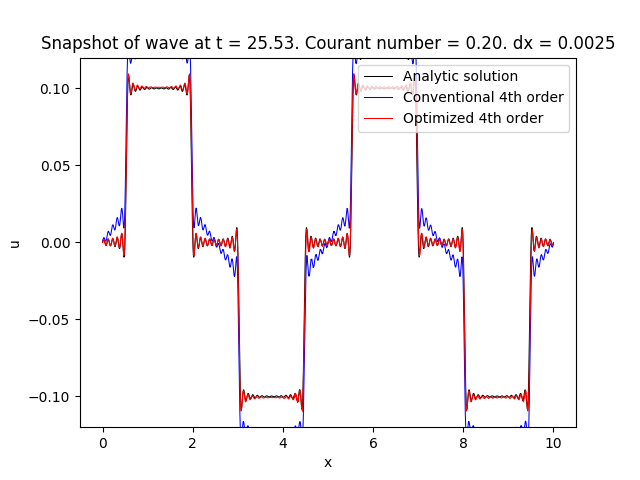

<IPython.core.display.Javascript object>


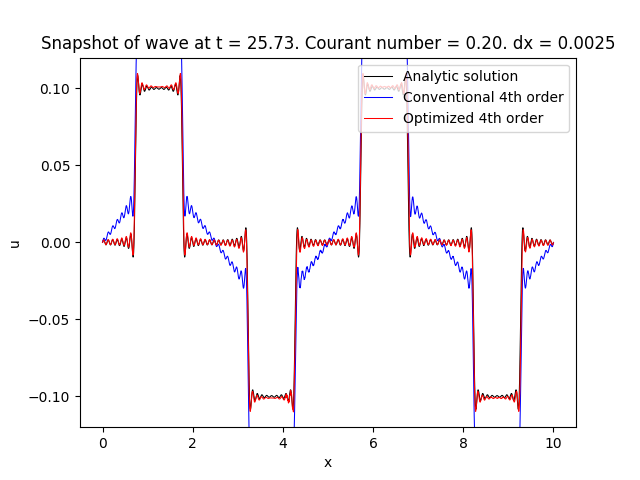

<IPython.core.display.Javascript object>


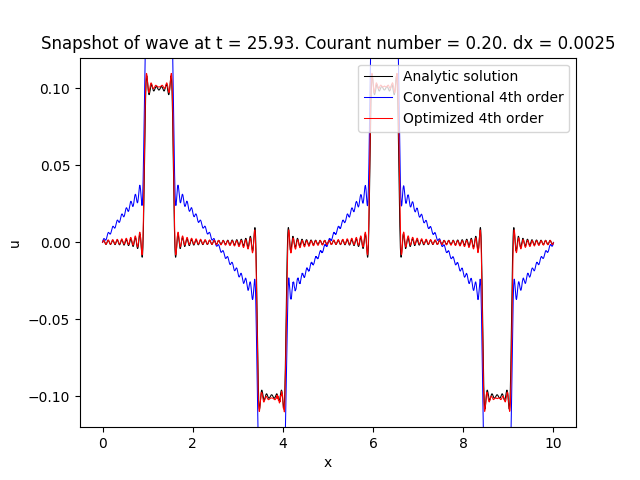

<IPython.core.display.Javascript object>


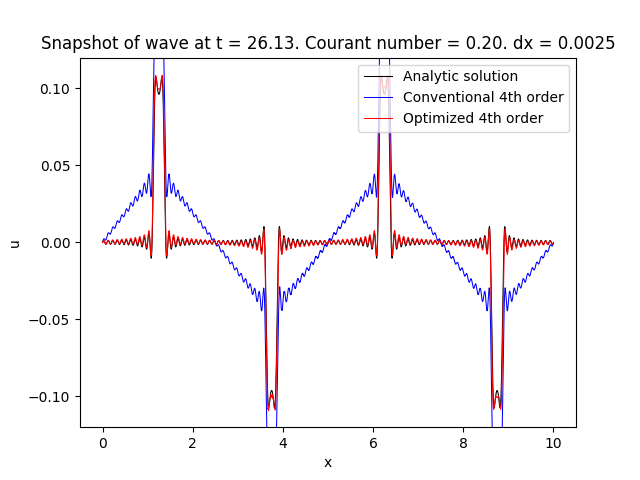

<IPython.core.display.Javascript object>


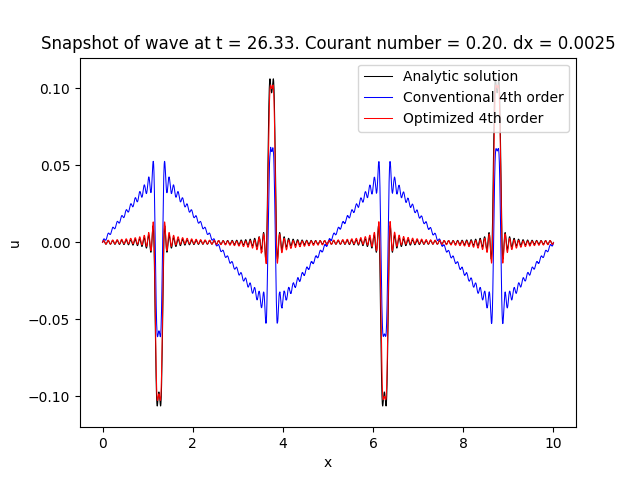

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


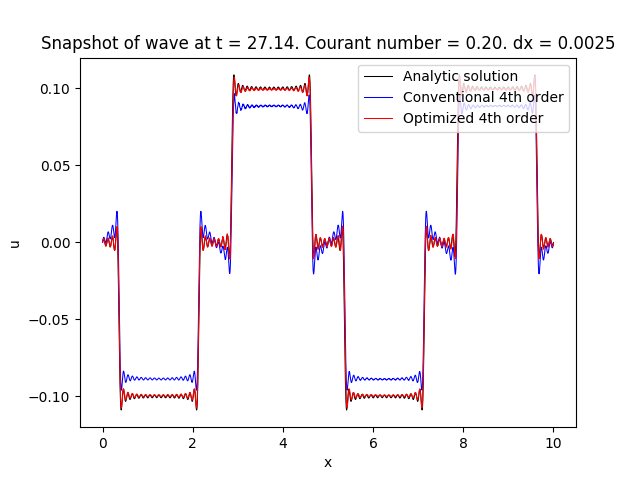

<IPython.core.display.Javascript object>


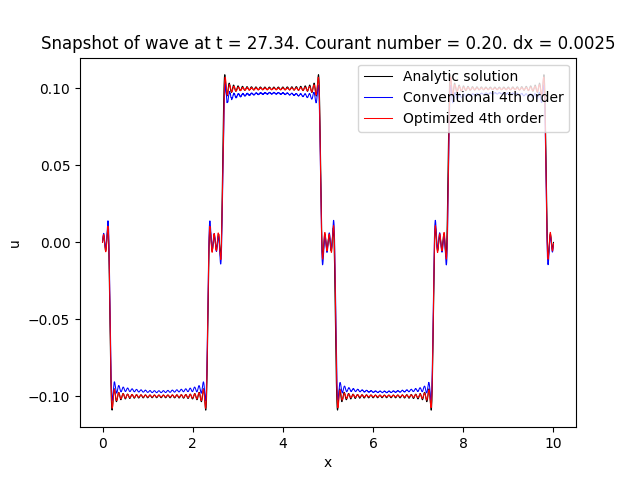

<IPython.core.display.Javascript object>


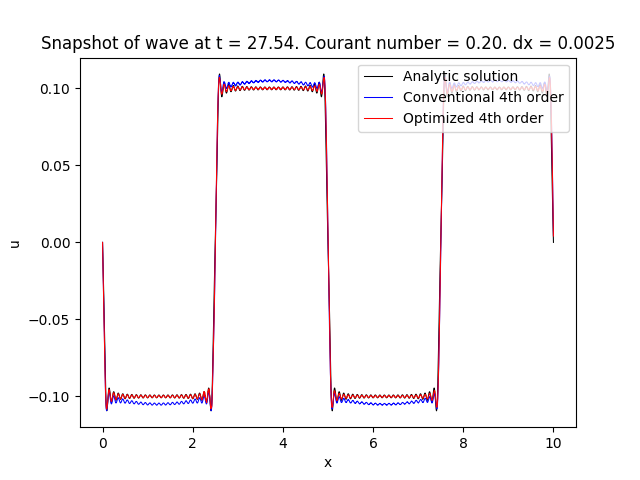

<IPython.core.display.Javascript object>


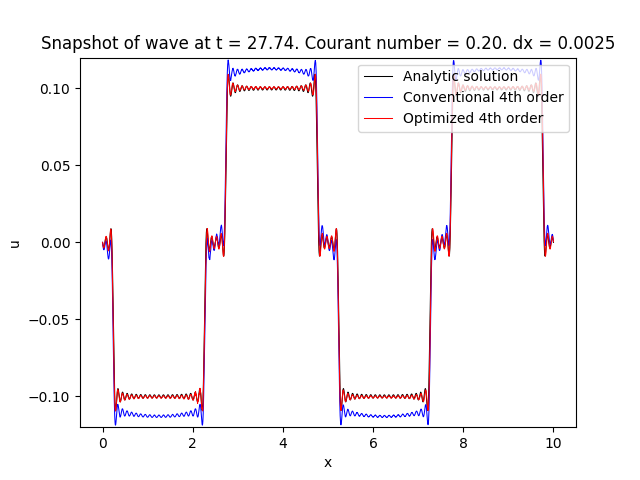

<IPython.core.display.Javascript object>


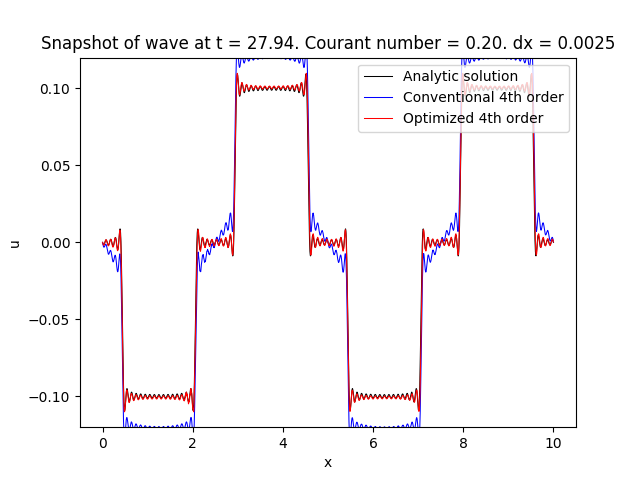

<IPython.core.display.Javascript object>


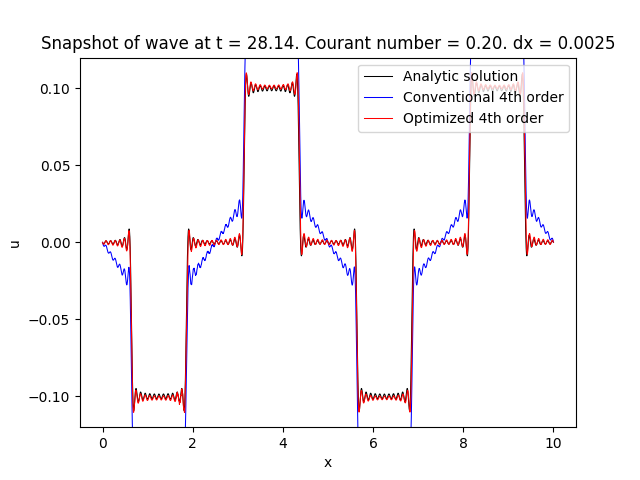

<IPython.core.display.Javascript object>


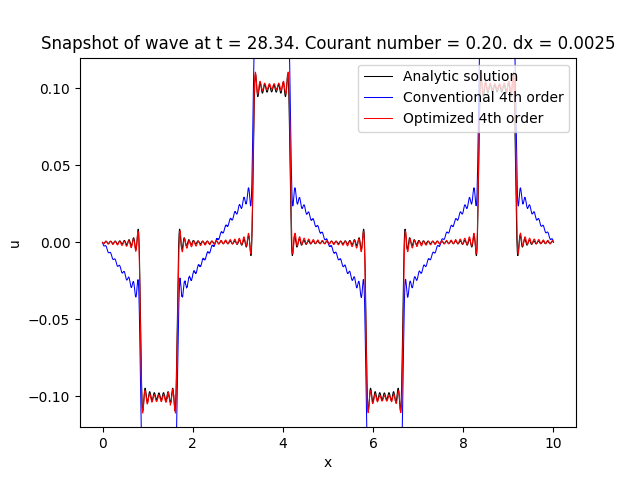

<IPython.core.display.Javascript object>


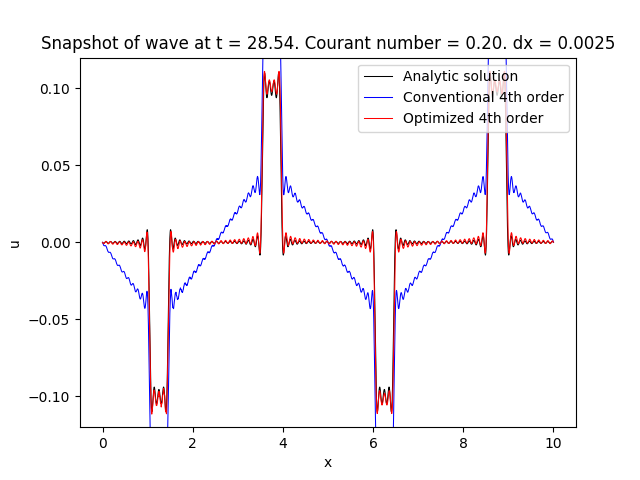

<IPython.core.display.Javascript object>


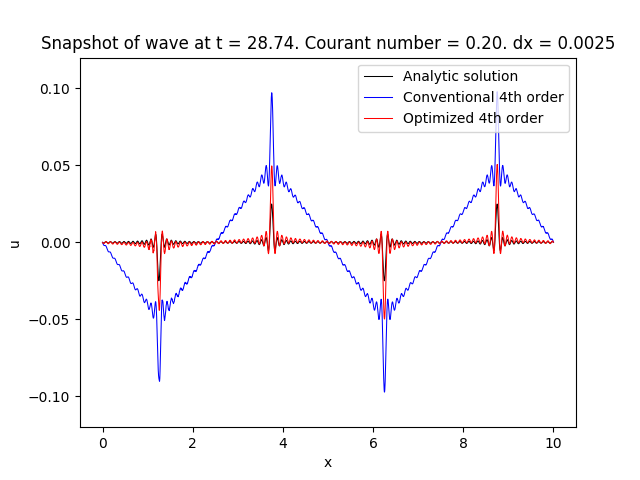

<IPython.core.display.Javascript object>


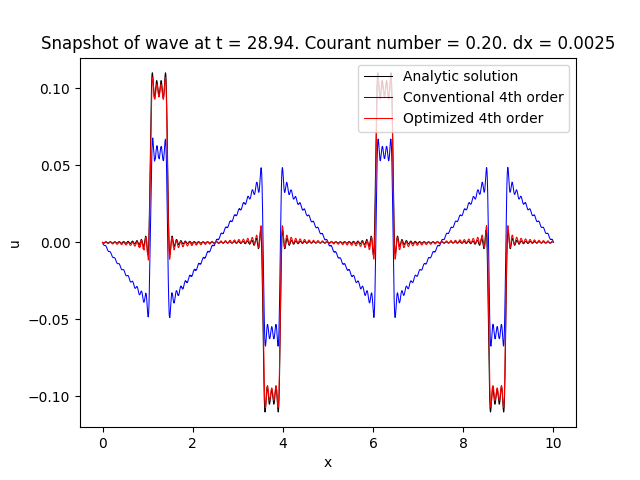

<IPython.core.display.Javascript object>


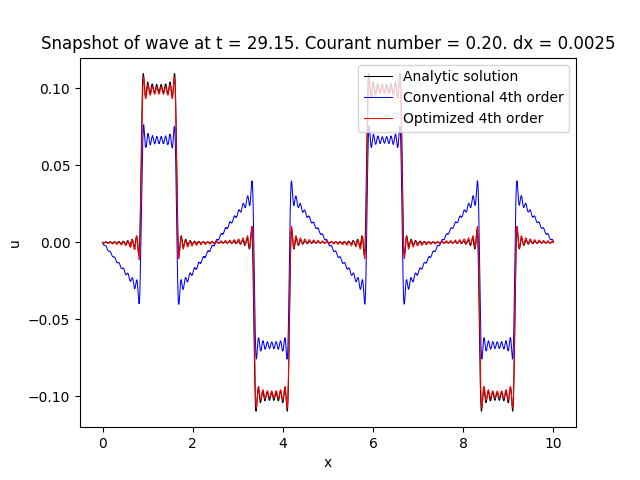

<IPython.core.display.Javascript object>


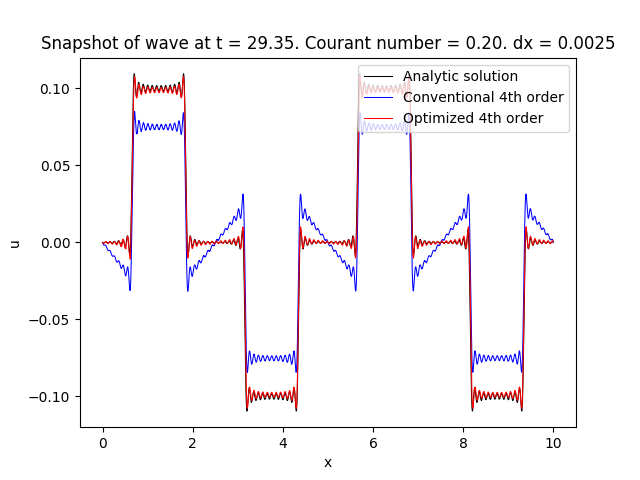

<IPython.core.display.Javascript object>


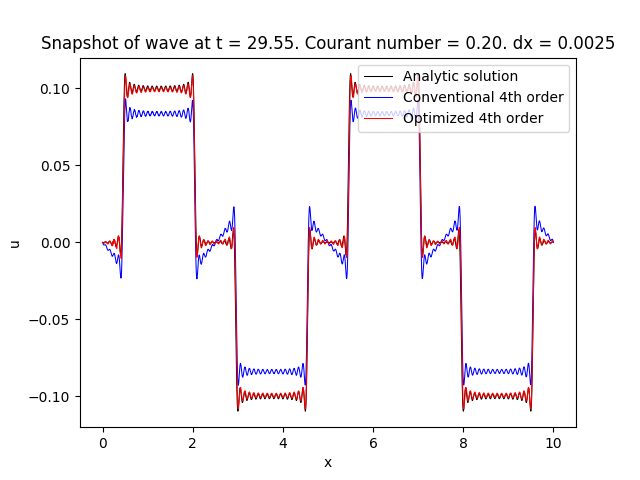

<IPython.core.display.Javascript object>


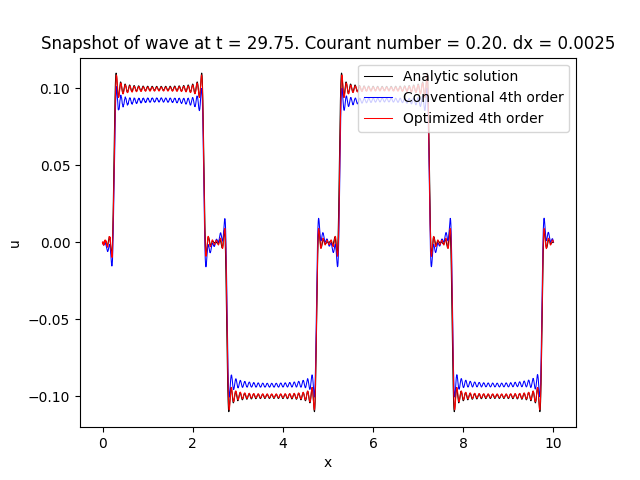

<IPython.core.display.Javascript object>


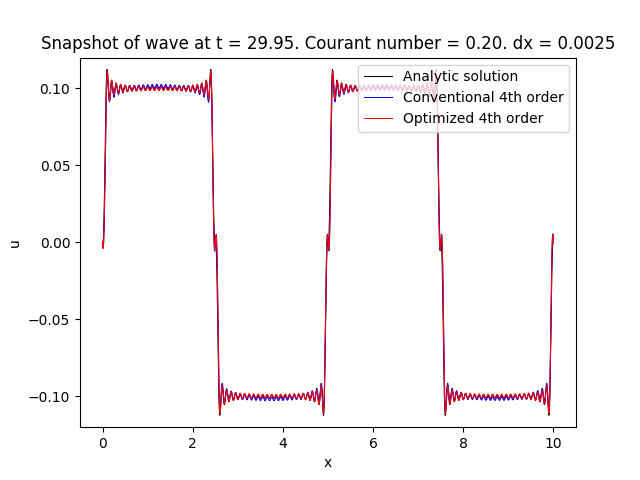

<IPython.core.display.Javascript object>


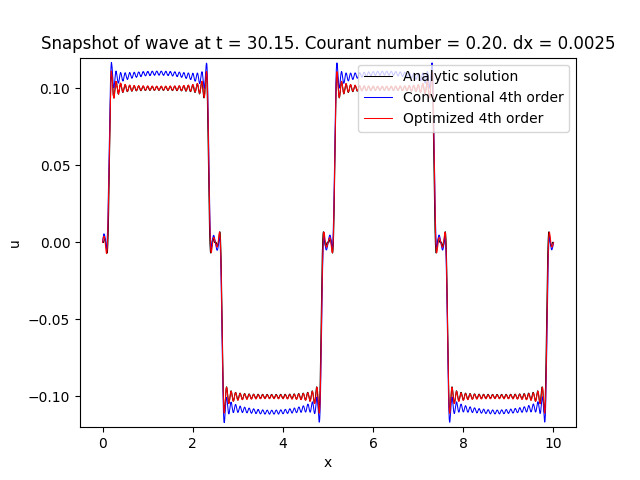

<IPython.core.display.Javascript object>


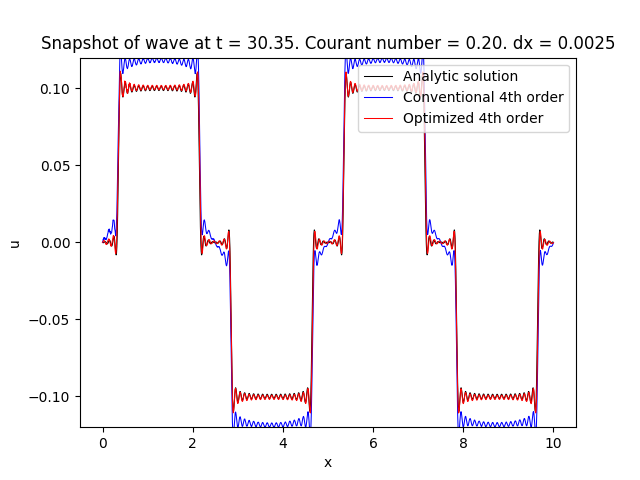

<IPython.core.display.Javascript object>


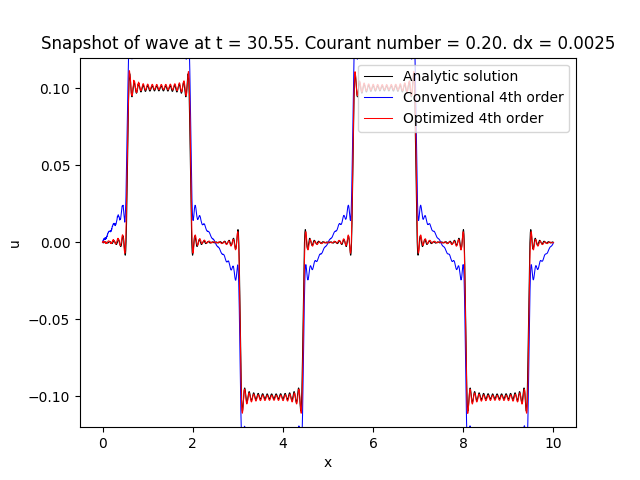

<IPython.core.display.Javascript object>


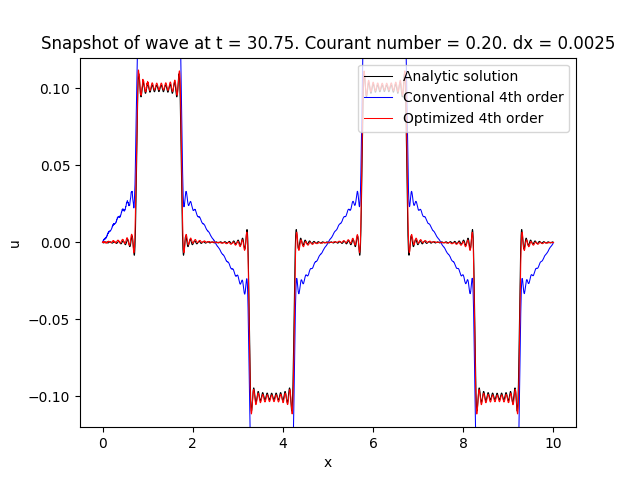

<IPython.core.display.Javascript object>


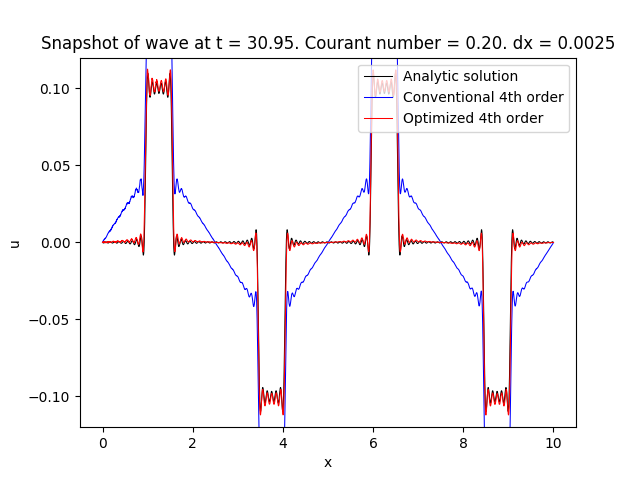

<IPython.core.display.Javascript object>


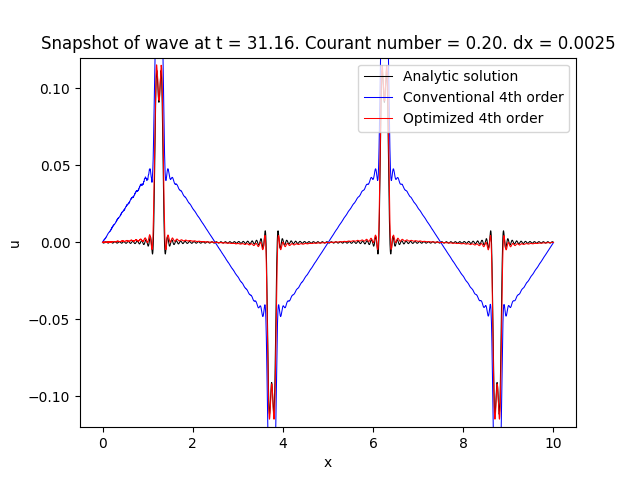

<IPython.core.display.Javascript object>


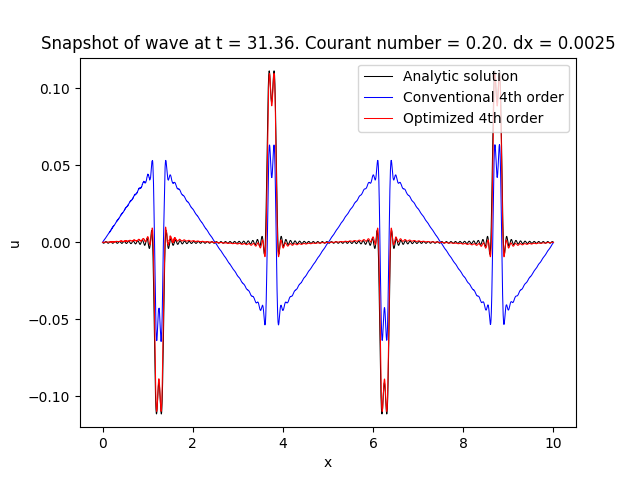

<IPython.core.display.Javascript object>


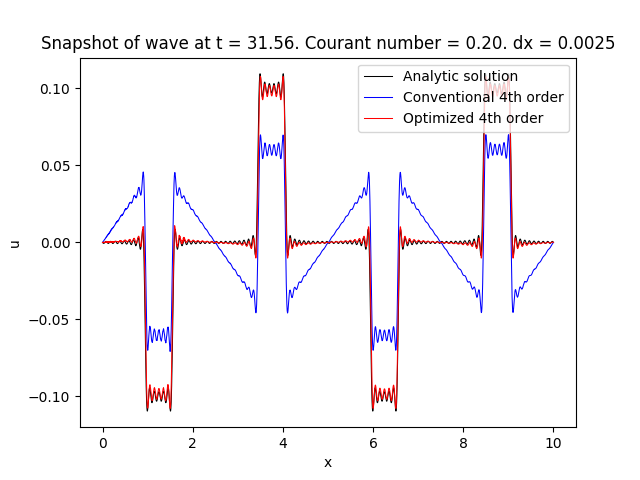

<IPython.core.display.Javascript object>


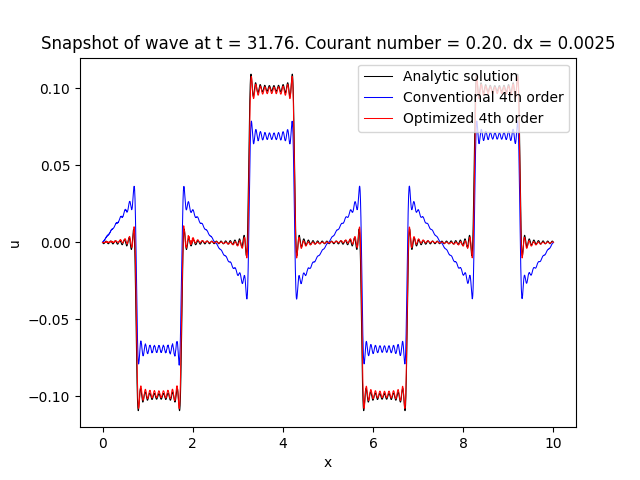

<IPython.core.display.Javascript object>


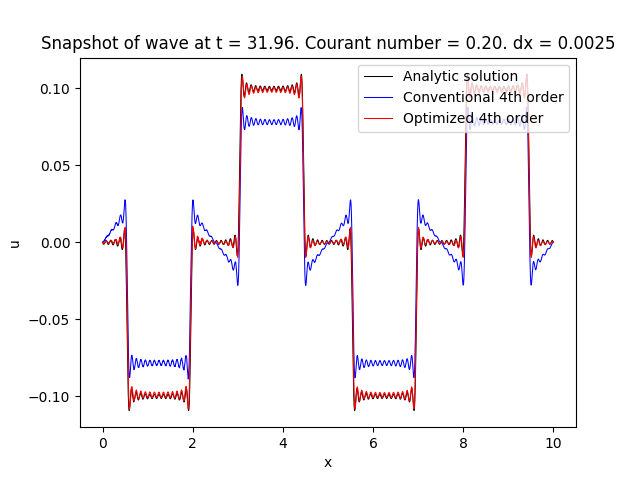

<IPython.core.display.Javascript object>


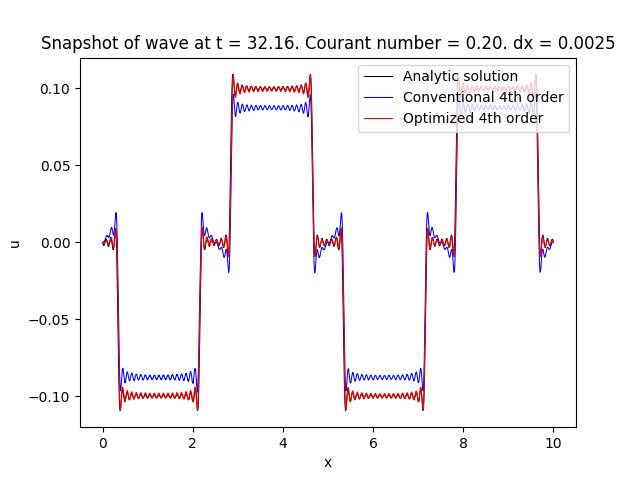

<IPython.core.display.Javascript object>


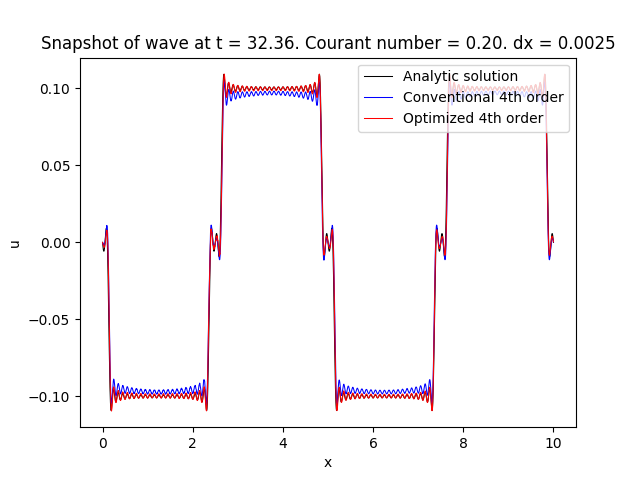

<IPython.core.display.Javascript object>


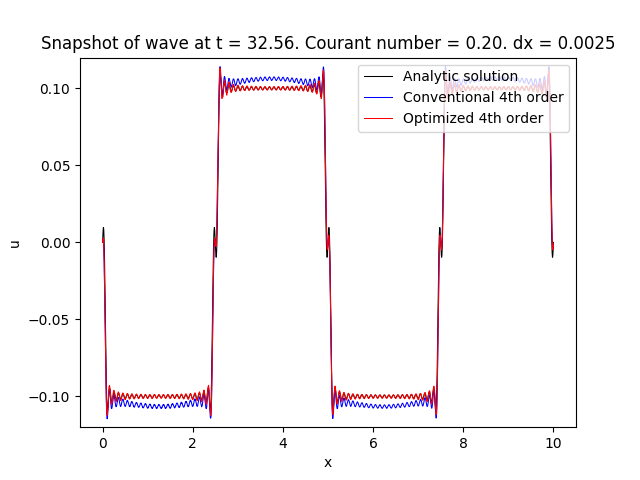

<IPython.core.display.Javascript object>


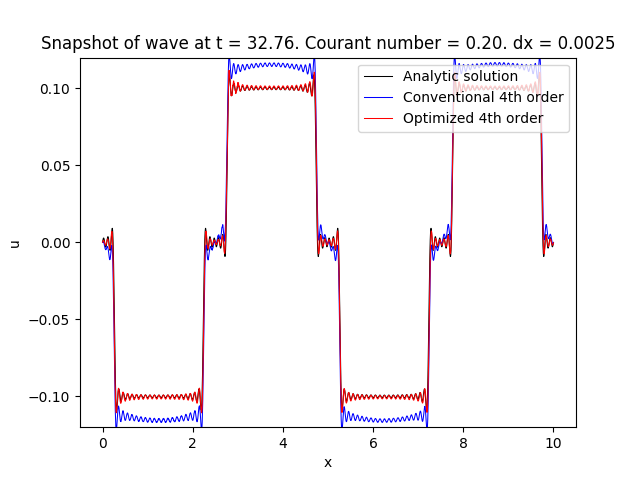

<IPython.core.display.Javascript object>


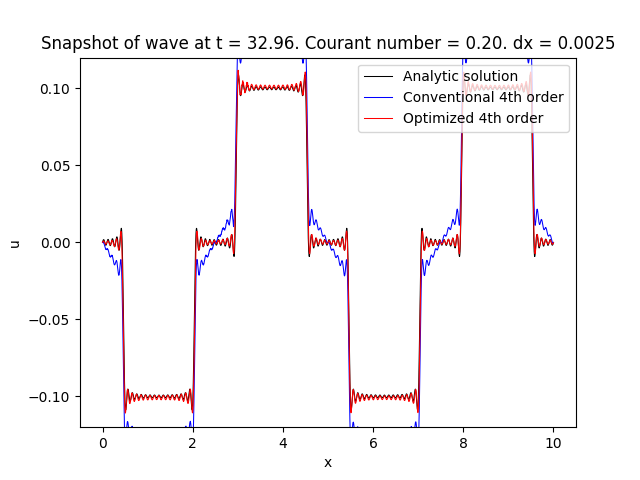

<IPython.core.display.Javascript object>


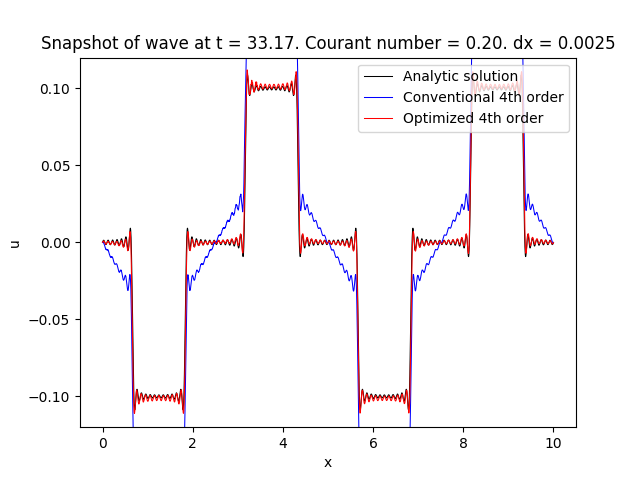

<IPython.core.display.Javascript object>


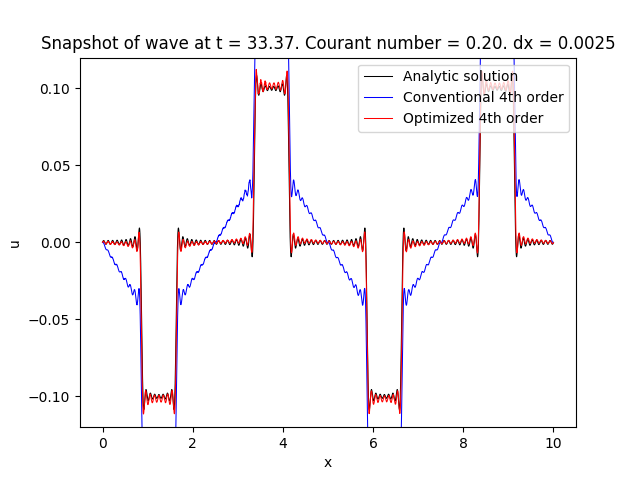

<IPython.core.display.Javascript object>


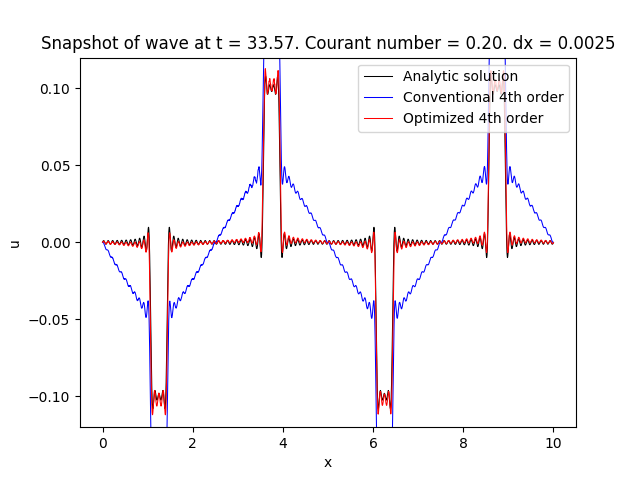

<IPython.core.display.Javascript object>


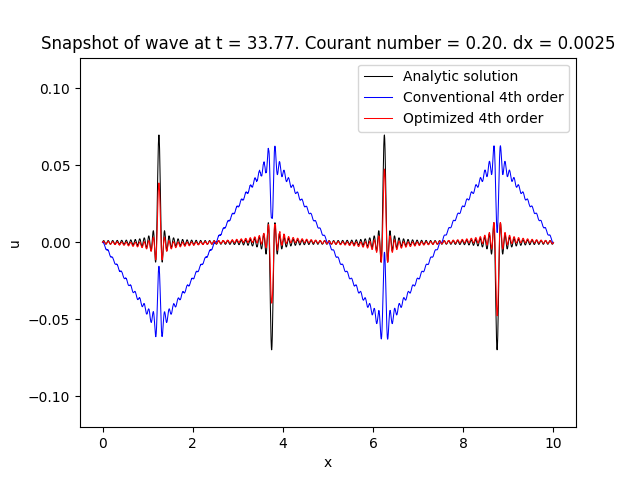

<IPython.core.display.Javascript object>


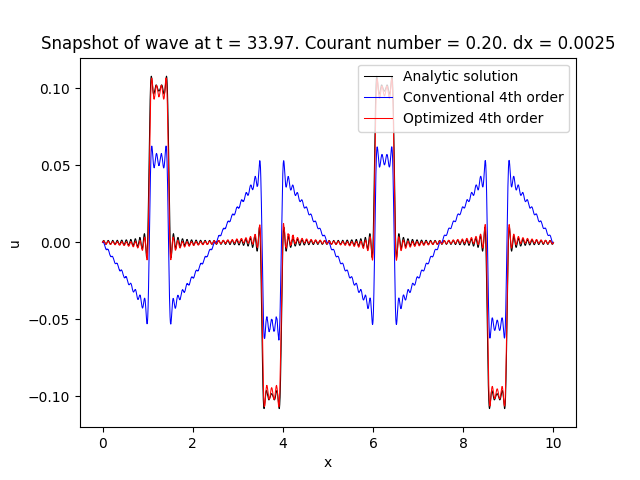

<IPython.core.display.Javascript object>


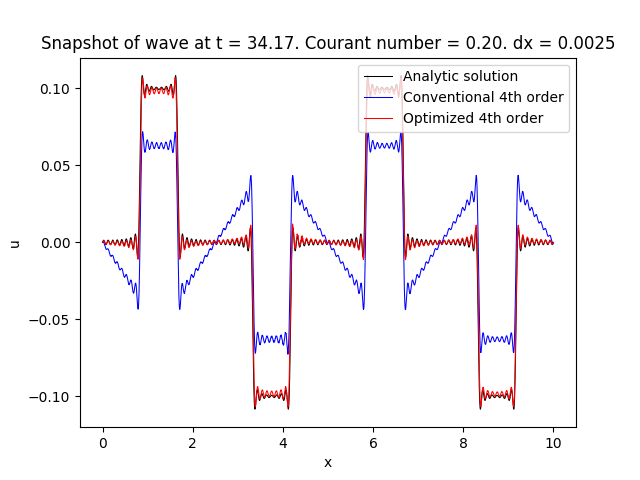

<IPython.core.display.Javascript object>


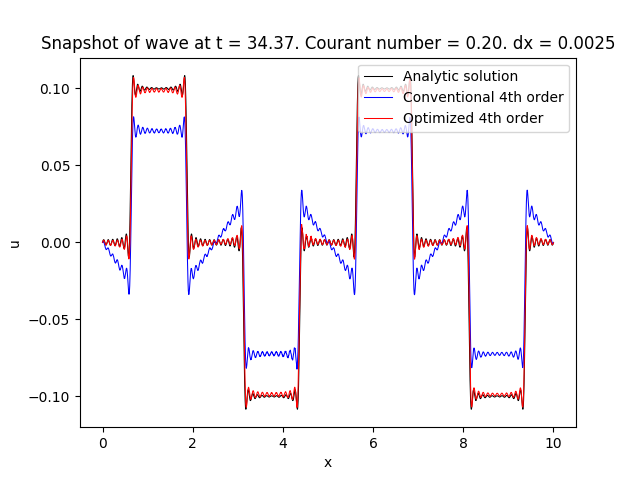

<IPython.core.display.Javascript object>


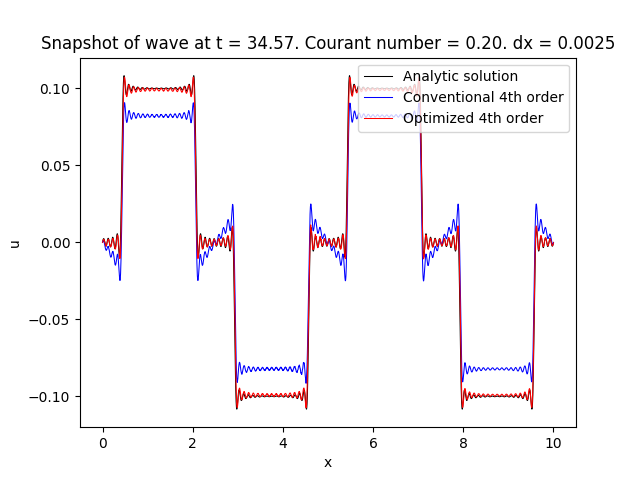

<IPython.core.display.Javascript object>


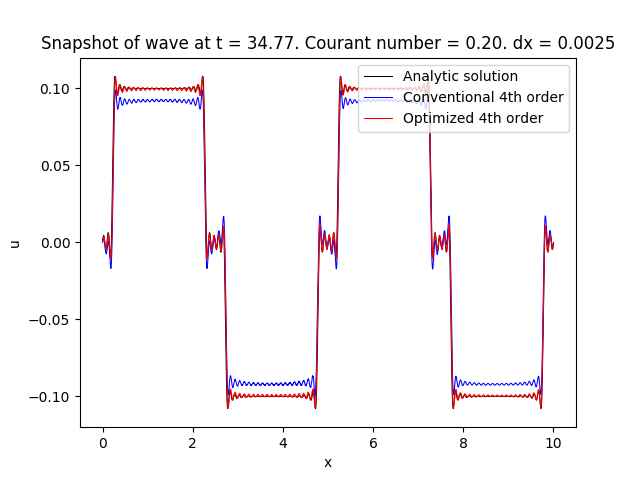

<IPython.core.display.Javascript object>


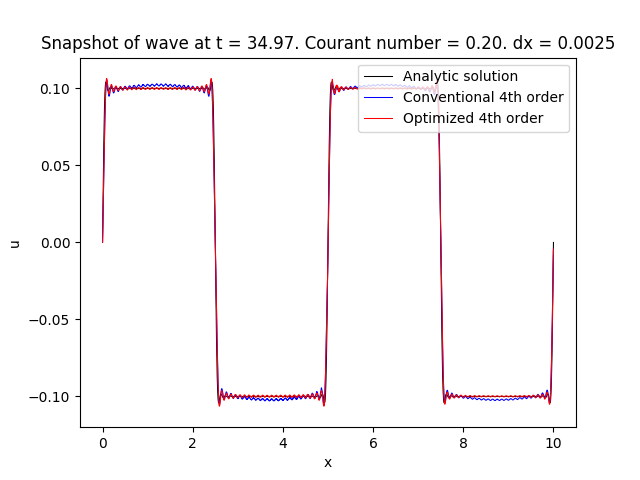

<IPython.core.display.Javascript object>


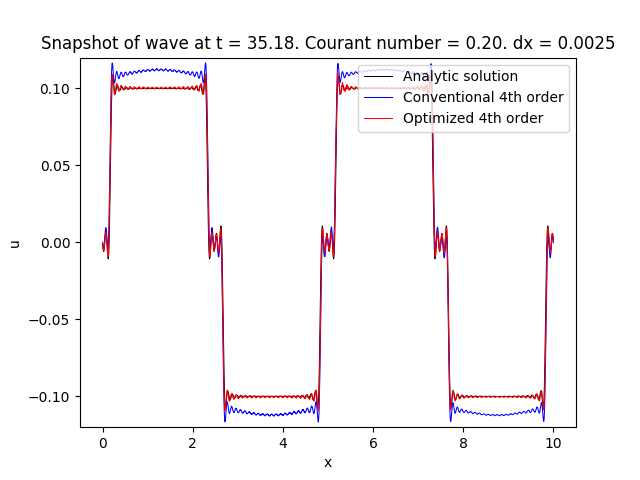

<IPython.core.display.Javascript object>


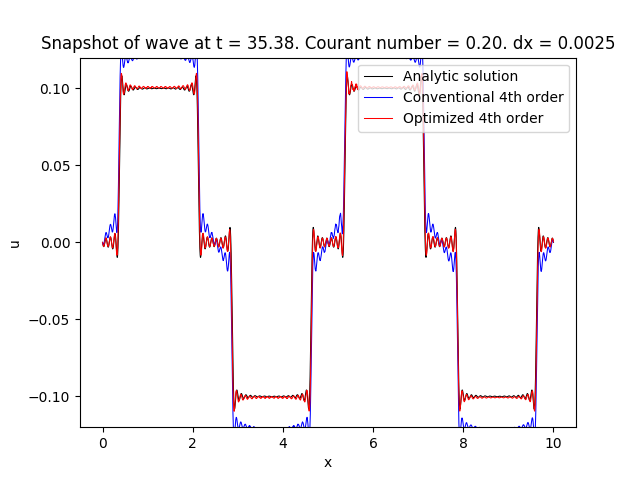

<IPython.core.display.Javascript object>


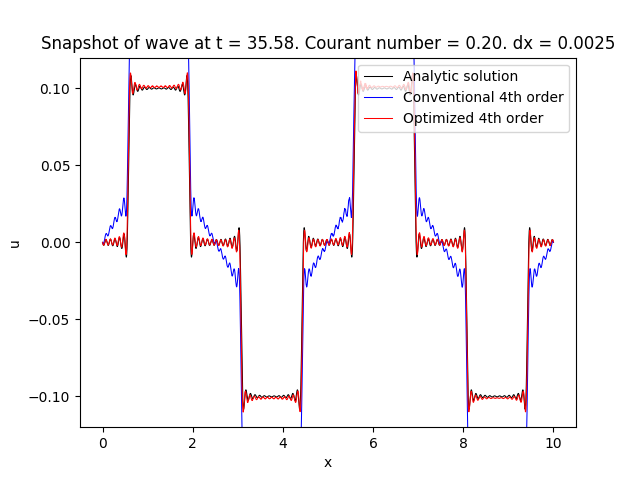

<IPython.core.display.Javascript object>


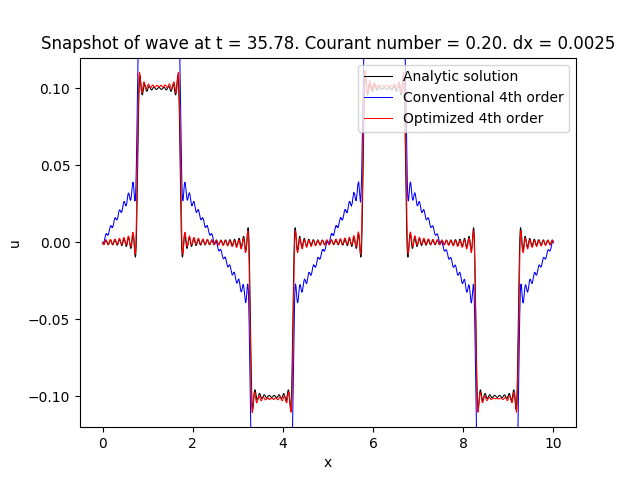

<IPython.core.display.Javascript object>


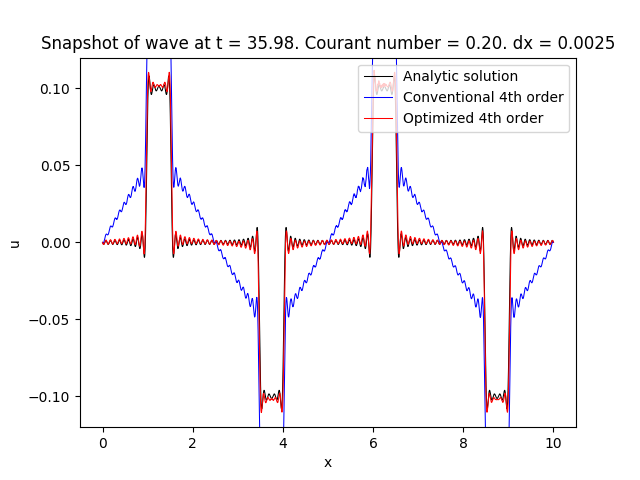

<IPython.core.display.Javascript object>


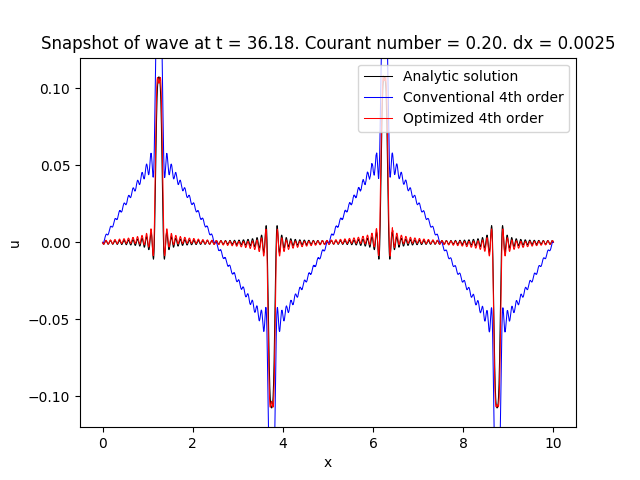

<IPython.core.display.Javascript object>


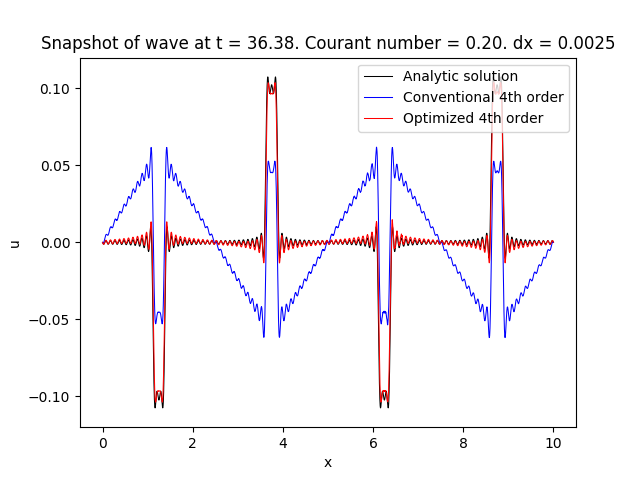

<IPython.core.display.Javascript object>


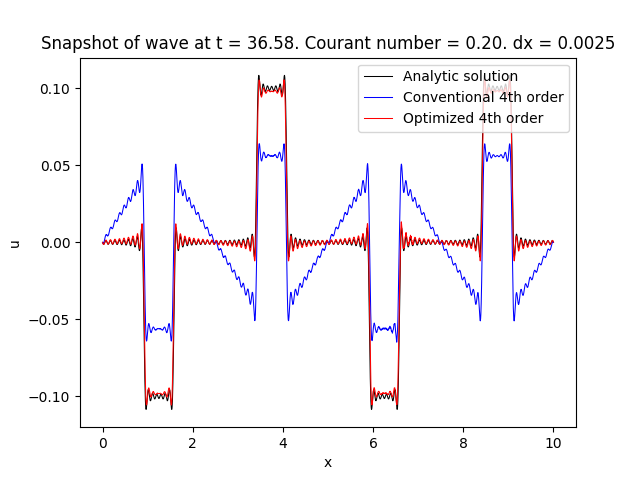

<IPython.core.display.Javascript object>


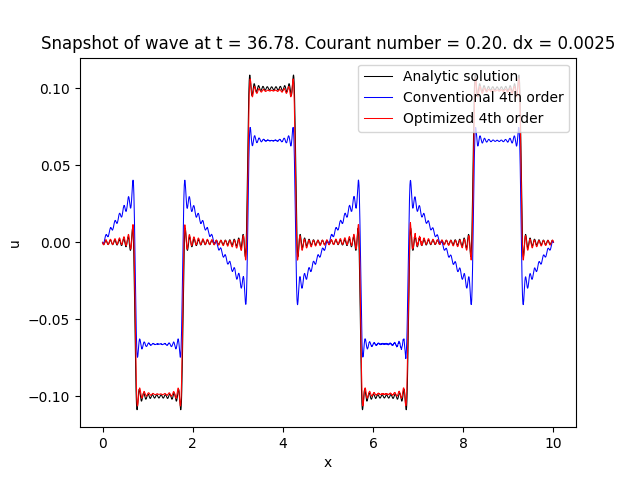

<IPython.core.display.Javascript object>


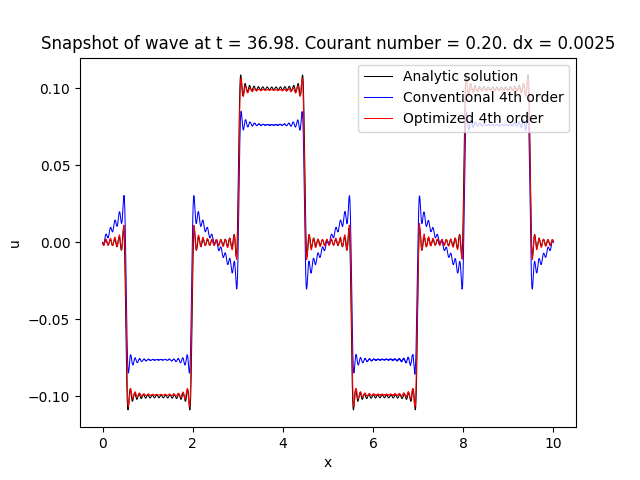

<IPython.core.display.Javascript object>


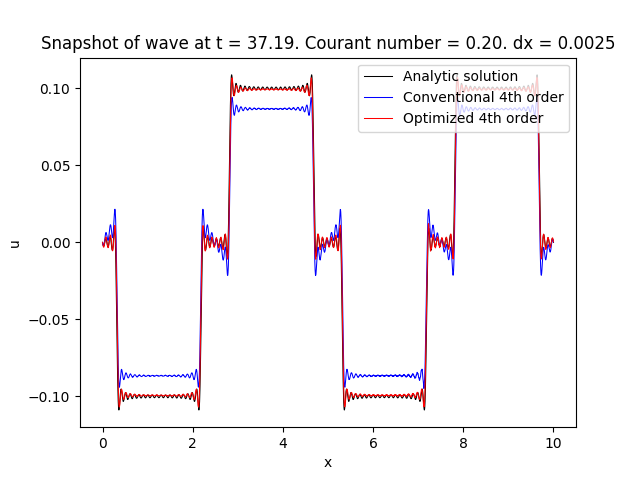

<IPython.core.display.Javascript object>


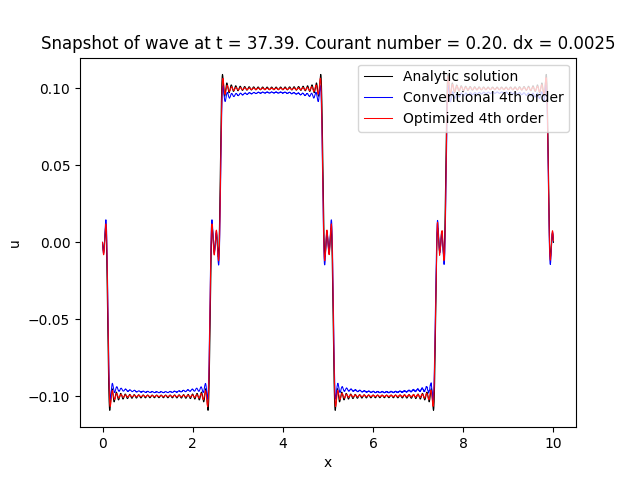

<IPython.core.display.Javascript object>


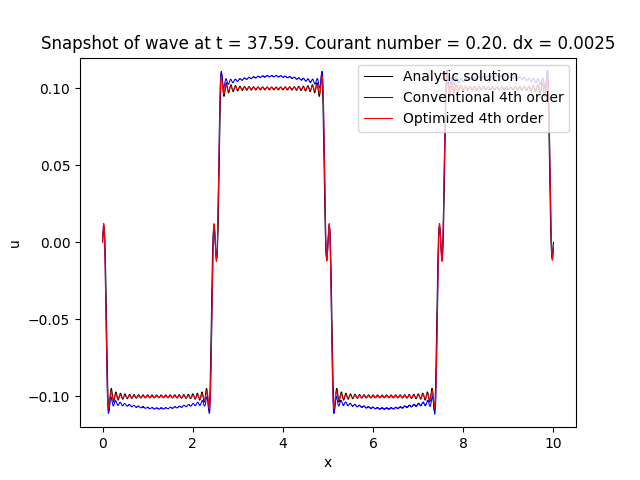

<IPython.core.display.Javascript object>


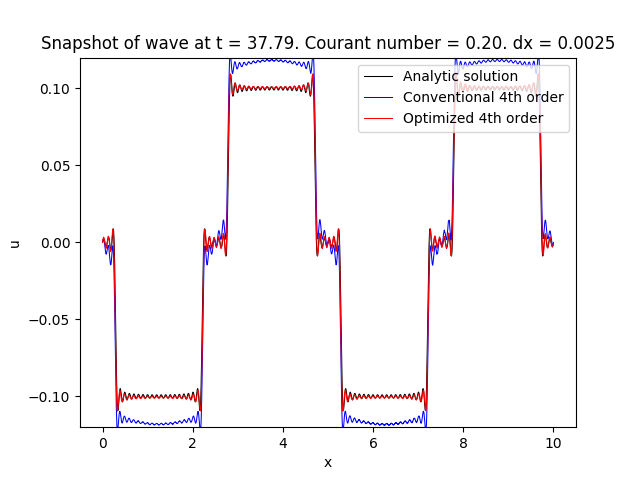

<IPython.core.display.Javascript object>


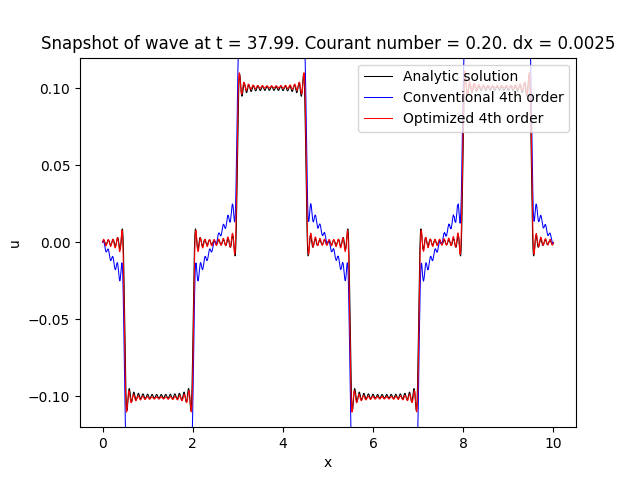

<IPython.core.display.Javascript object>


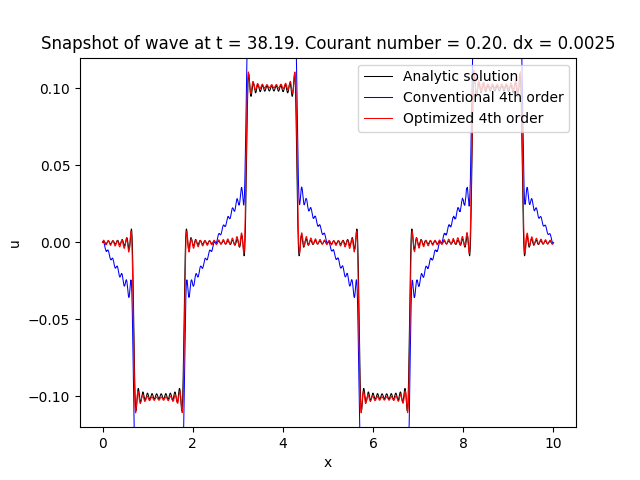

<IPython.core.display.Javascript object>


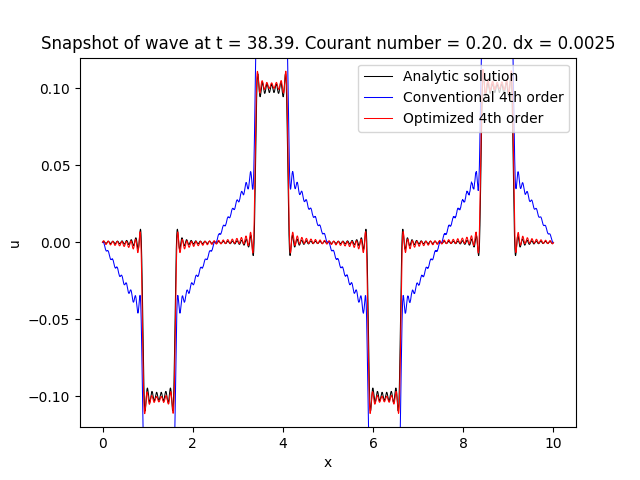

<IPython.core.display.Javascript object>


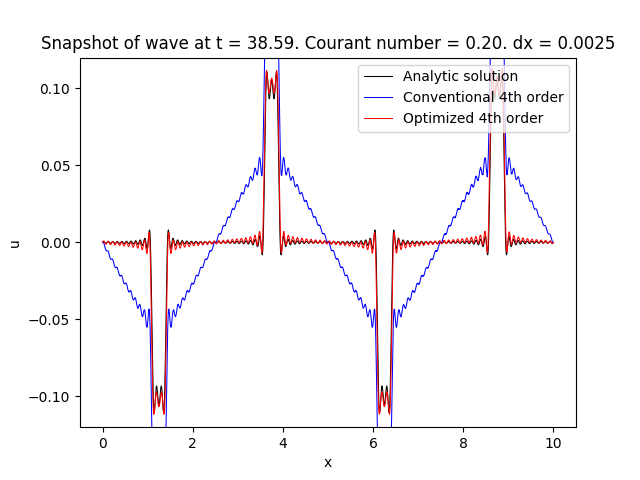

<IPython.core.display.Javascript object>


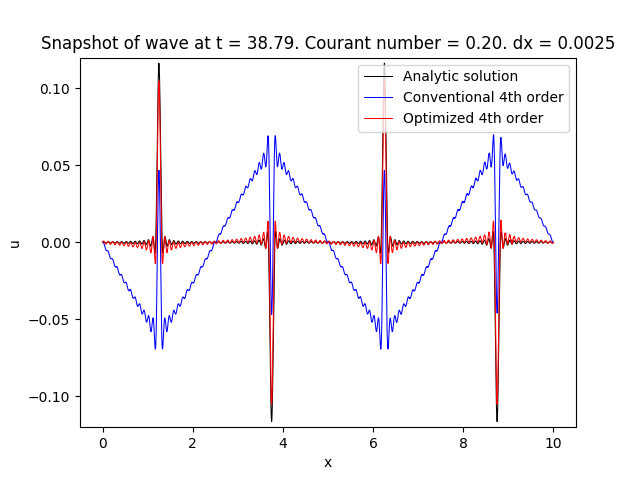

<IPython.core.display.Javascript object>


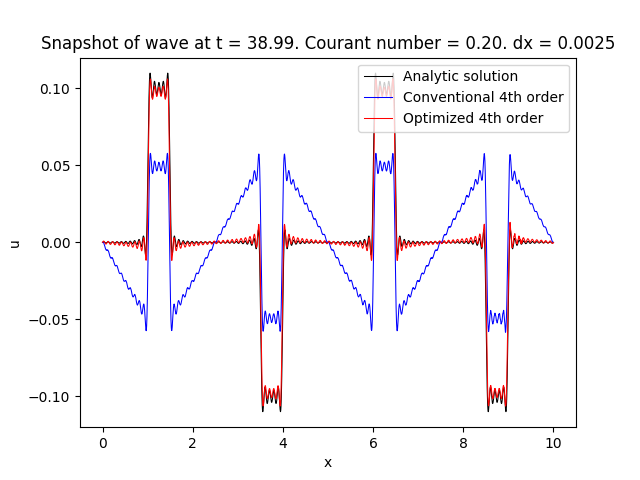

<IPython.core.display.Javascript object>


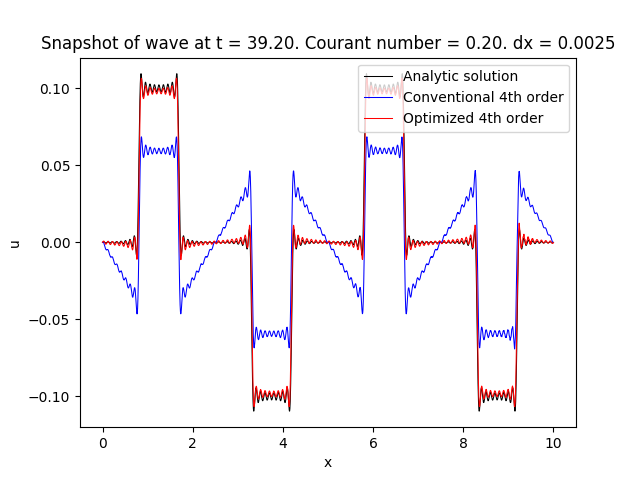

<IPython.core.display.Javascript object>


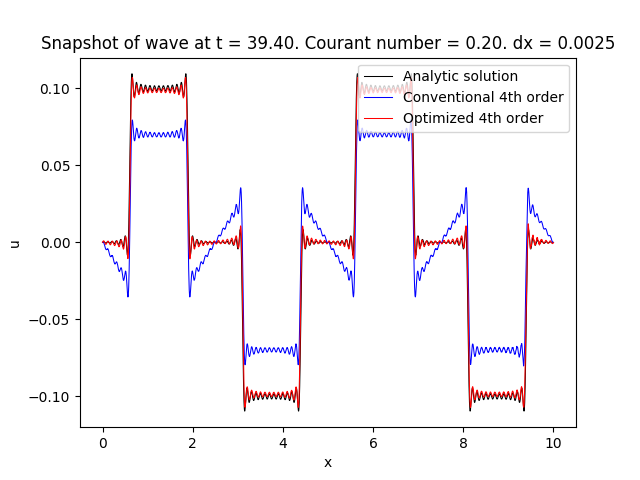

<IPython.core.display.Javascript object>


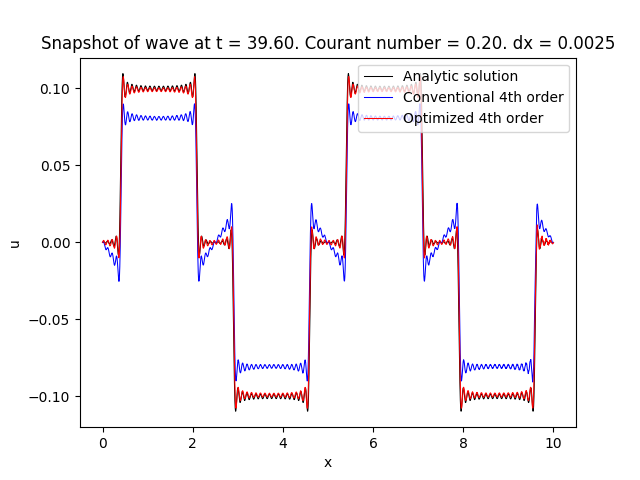

<IPython.core.display.Javascript object>


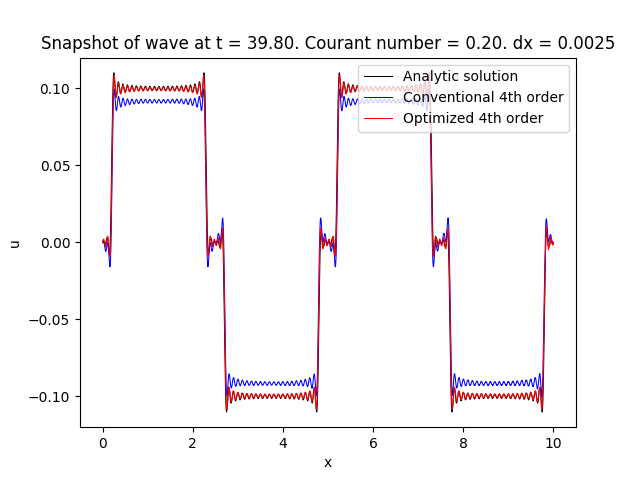

<IPython.core.display.Javascript object>


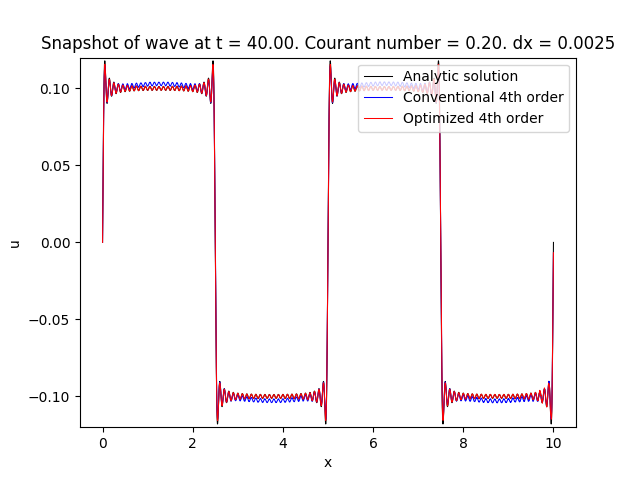

In [22]:
fig = plt.figure()
plt.plot(x_vals, 0.1*u(x_vals, 0), 'k-', 
            label='Analytic solution', linewidth=0.75)

plt.plot(x_vals, u_dev.data[1], 'b-', 
            label='Conventional 4th order', linewidth=0.75)

plt.plot(x_vals, u_opt.data[1], 'r-', 
            label='Optimized 4th order', linewidth=0.75)
plt.ylim(-0.12, 0.12)
plt.title("Snapshot of wave at t = 0. Courant number = %.2f. dx = %.4f" % (dt/(L/(shape[0]-1)), L/l))
plt.xlabel("x")
plt.ylabel("u")
plt.legend(loc=1)
plt.savefig("Figures/Dx_0.0025/Wavefield_Snapshots/time0.00.png", dpi=200)
plt.show()

for i in linspace(0, t_end, t_end*5.):
    if i == 0:
        continue
    fig = plt.figure()
    plt.plot(x_vals, 0.1*u(x_vals, float(i)), 'k-', 
            label='Analytic solution', linewidth=0.75)

    plt.plot(x_vals, u_dev.data[int(i*u_dev.data.shape[0]/t_end)-1], 'b-', 
            label='Conventional 4th order', linewidth=0.75)

    plt.plot(x_vals, u_opt.data[int(i*u_dev.data.shape[0]/t_end)-1], 'r-', 
            label='Optimized 4th order', linewidth=0.75)
    plt.ylim(-0.12, 0.12)
    plt.title("Snapshot of wave at t = %.2f. Courant number = %.2f. dx = %.4f" % (float(i), dt/(L/(shape[0]-1)), L/l))
    plt.xlabel("x")
    plt.ylabel("u")
    plt.legend(loc=1)
    plt.savefig("Figures/Dx_0.0025/Wavefield_Snapshots/time%.2f.png" % (i), dpi=200)
    plt.show()


/home/ed/.local/lib/python3.6/site-packages/ipykernel/__main__.py:8: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.


<IPython.core.display.Javascript object>


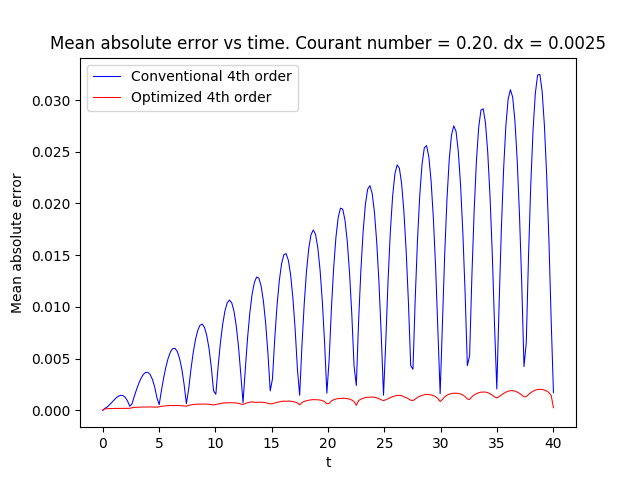

In [23]:
# Plot mean absolute error vs time
from numpy import mean

time_list = [0]
err_dev_list = [mean(abs(0.1*u(x_vals, 0)-u_dev.data[1]))]
err_opt_list = [mean(abs(0.1*u(x_vals, 0)-u_opt.data[1]))]

for i in linspace(0, t_end, t_end*5.):
    if i == 0:
        continue
    time_list.append(i)
    err_dev_list.append(mean(abs(0.1*u(x_vals, float(i))-u_dev.data[int(i*u_dev.data.shape[0]/t_end)-1])))
    err_opt_list.append(mean(abs(0.1*u(x_vals, float(i))-u_opt.data[int(i*u_opt.data.shape[0]/t_end)-1])))
    
fig = plt.figure()
plt.plot(time_list, err_dev_list, 'b-', 
            label='Conventional 4th order', linewidth=0.75)

plt.plot(time_list, err_opt_list, 'r-', 
            label='Optimized 4th order', linewidth=0.75)
plt.title("Mean absolute error vs time. Courant number = %.2f. dx = %.4f" % (dt/(L/(shape[0]-1)), L/l))
plt.xlabel("t")
plt.ylabel("Mean absolute error")
plt.legend(loc=0)
plt.savefig("Figures/Dx_0.0025/mean_absolute_error", dpi=200)
plt.show()

/home/ed/.local/lib/python3.6/site-packages/ipykernel/__main__.py:3: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.
  app.launch_new_instance()


<IPython.core.display.Javascript object>


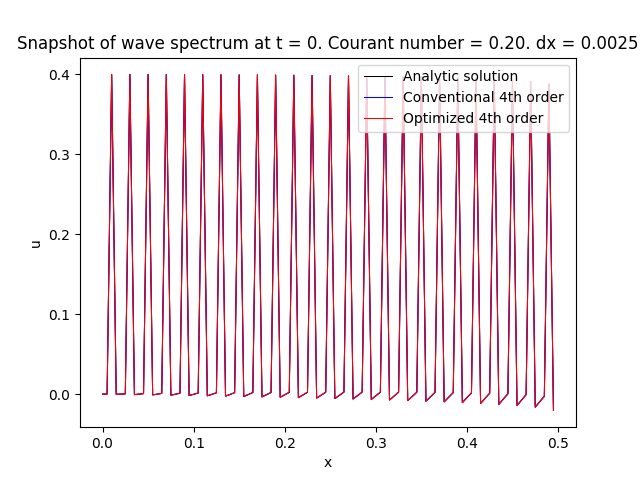

/home/ed/anaconda3/envs/devito/lib/python3.6/site-packages/numpy/core/numeric.py:492: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/home/ed/.local/lib/python3.6/site-packages/ipykernel/__main__.py:21: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.


<IPython.core.display.Javascript object>


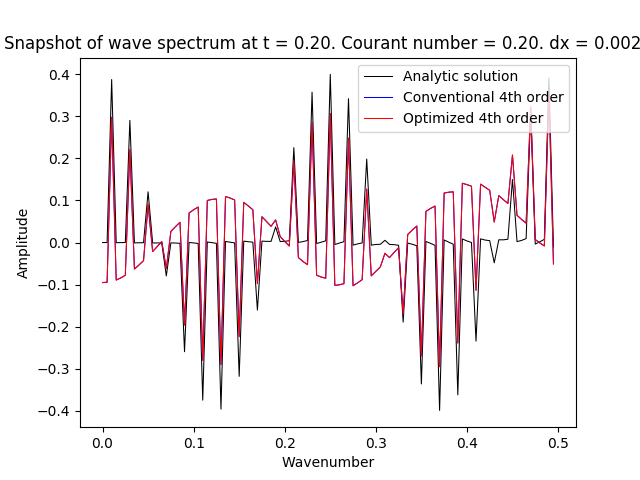

<IPython.core.display.Javascript object>


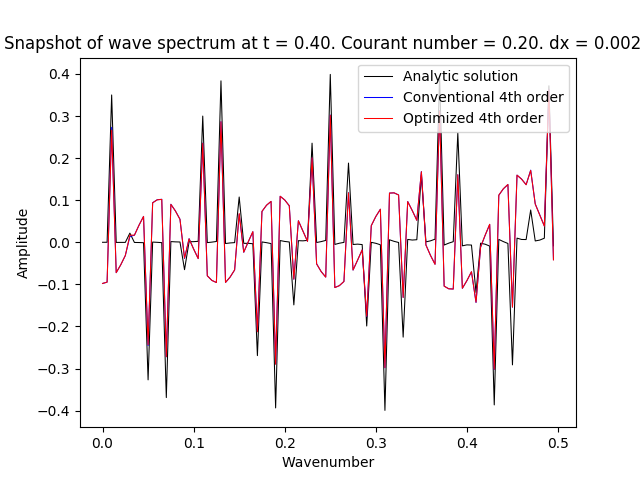

<IPython.core.display.Javascript object>


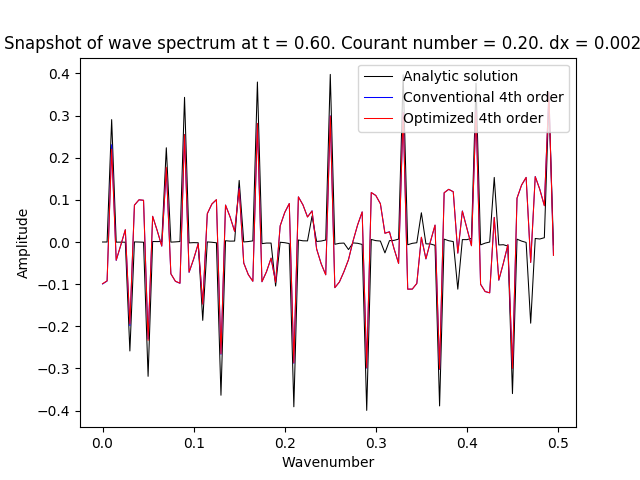

<IPython.core.display.Javascript object>


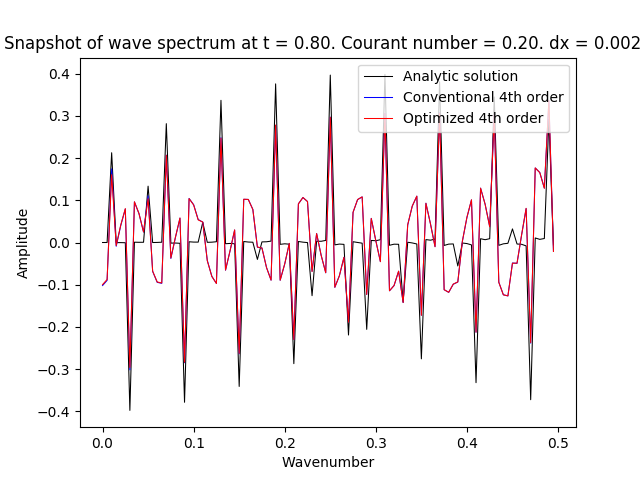

<IPython.core.display.Javascript object>


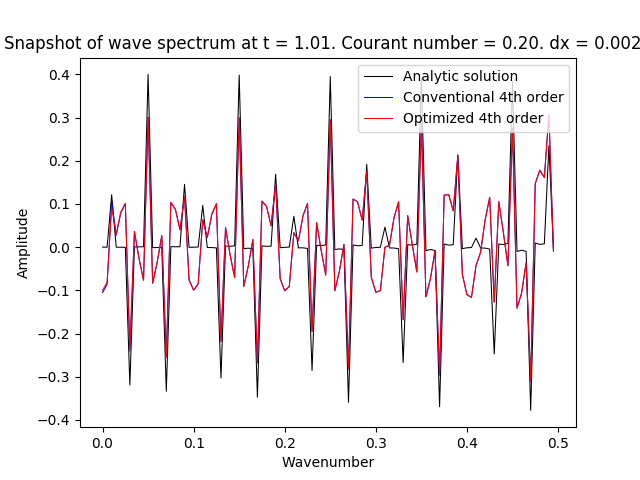

<IPython.core.display.Javascript object>


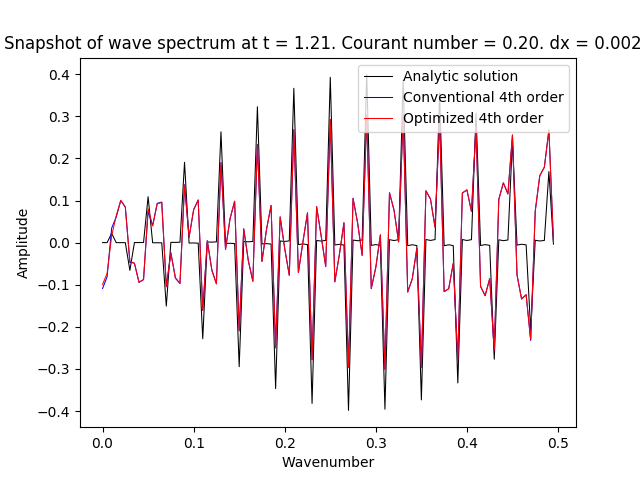

<IPython.core.display.Javascript object>


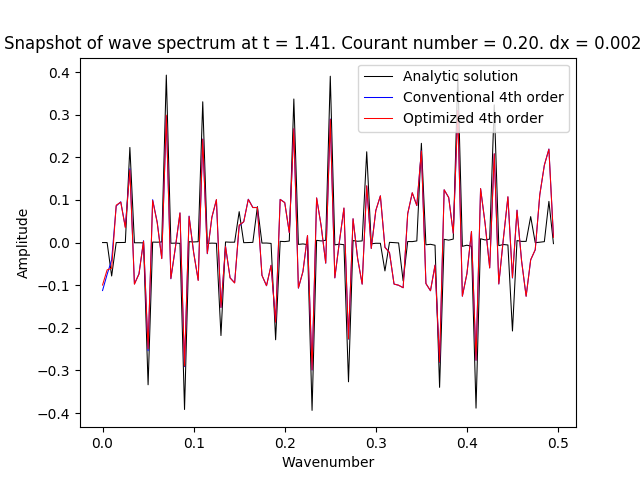

<IPython.core.display.Javascript object>


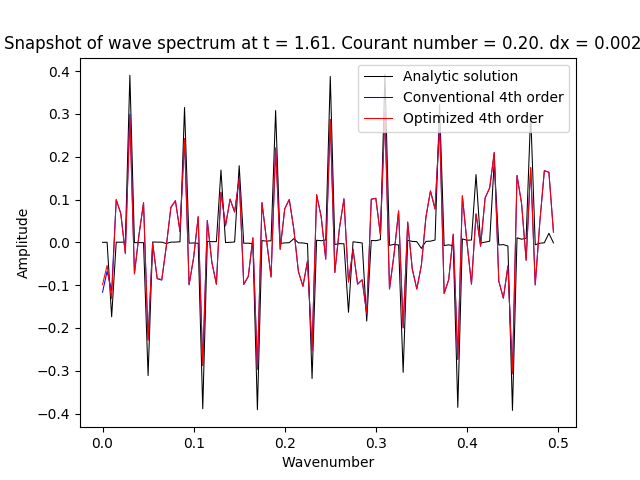

<IPython.core.display.Javascript object>


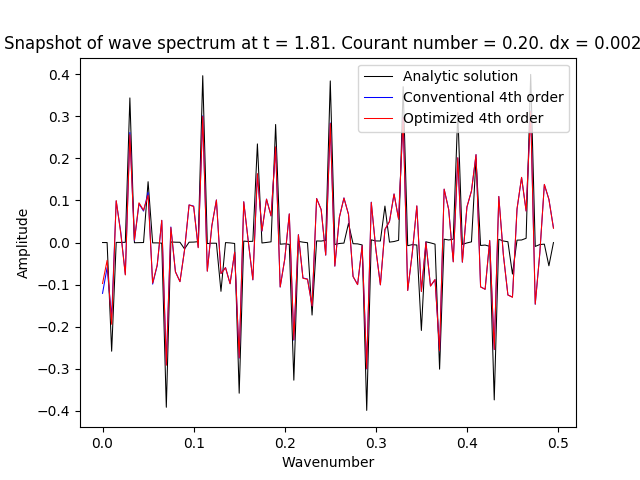

<IPython.core.display.Javascript object>


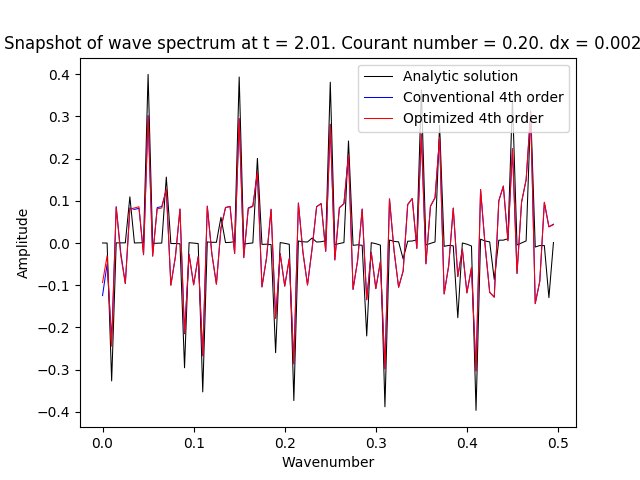

<IPython.core.display.Javascript object>


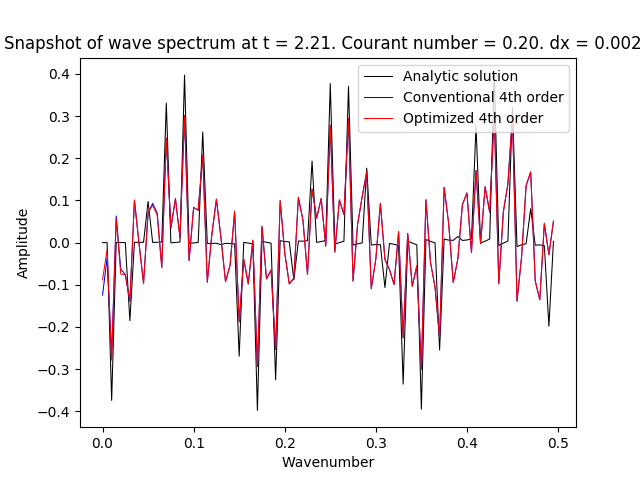

<IPython.core.display.Javascript object>


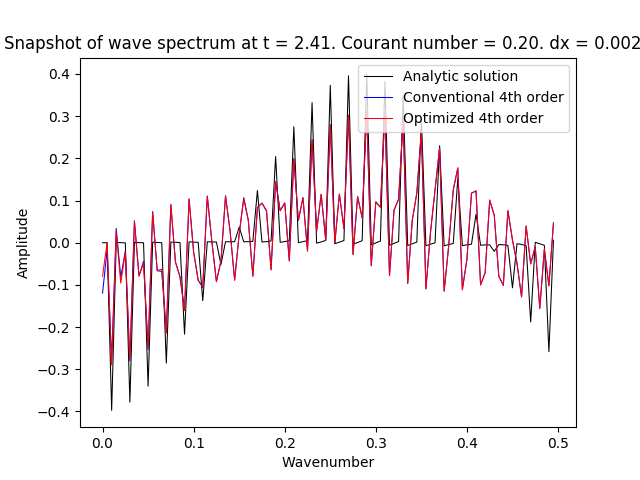

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


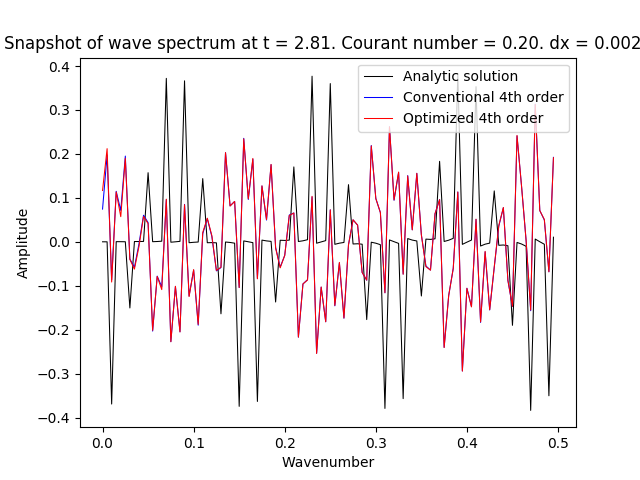

<IPython.core.display.Javascript object>


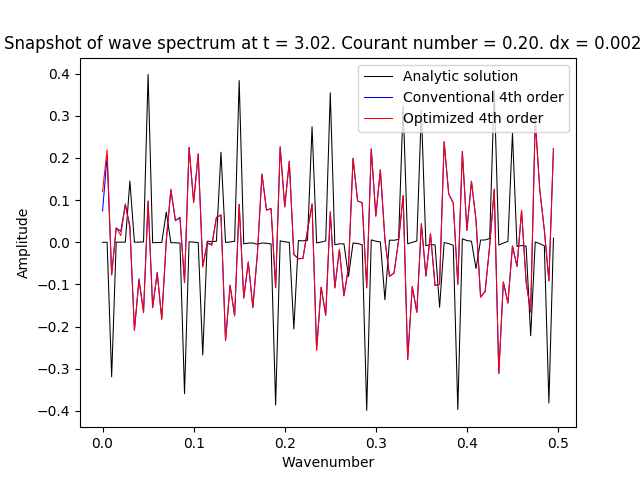

<IPython.core.display.Javascript object>


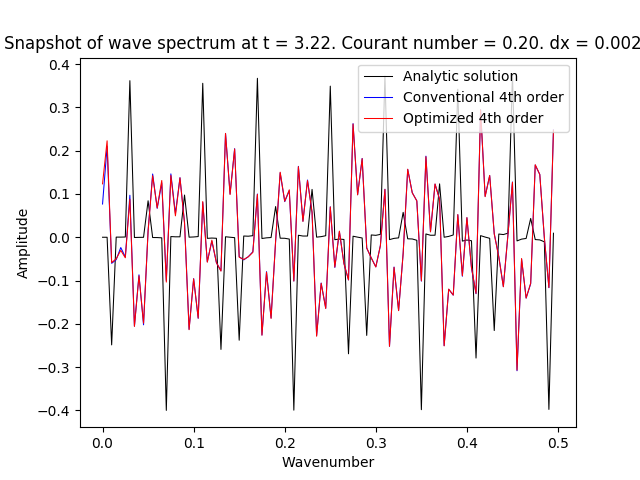

<IPython.core.display.Javascript object>


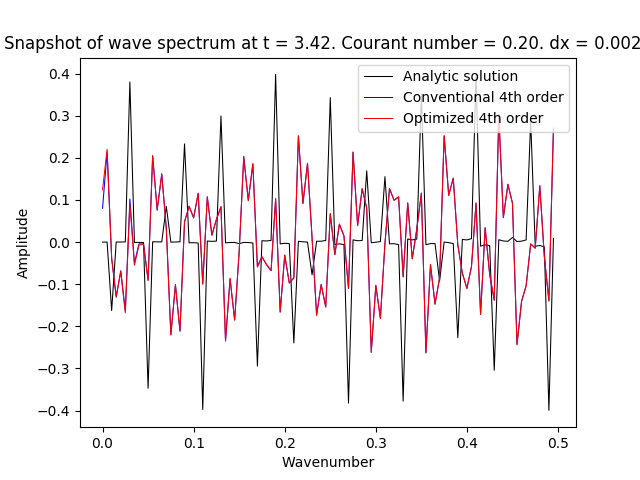

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


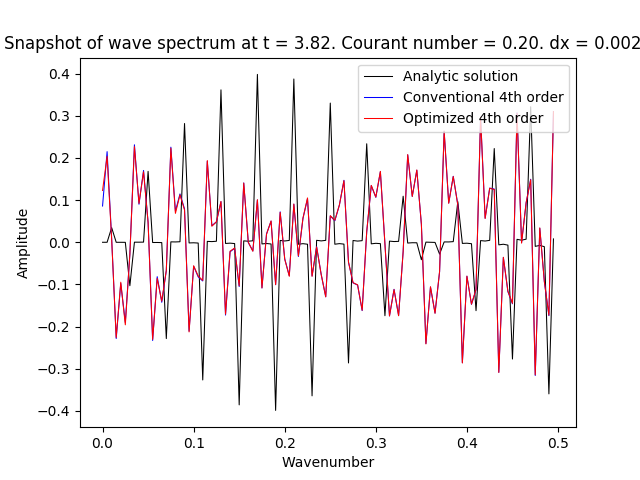

/home/ed/.local/lib/python3.6/site-packages/matplotlib/pyplot.py:513: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


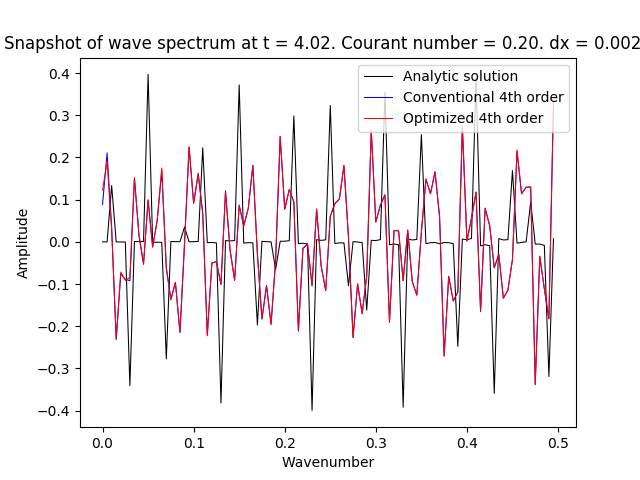

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


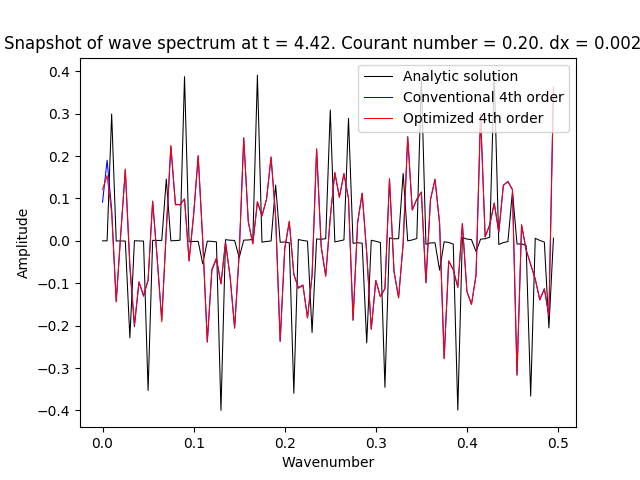

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


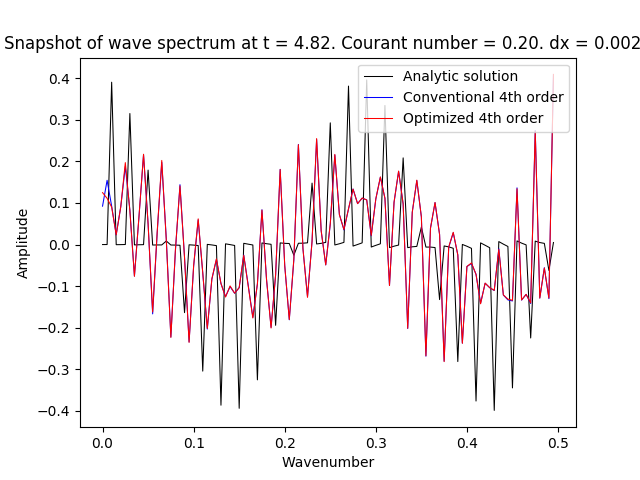

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


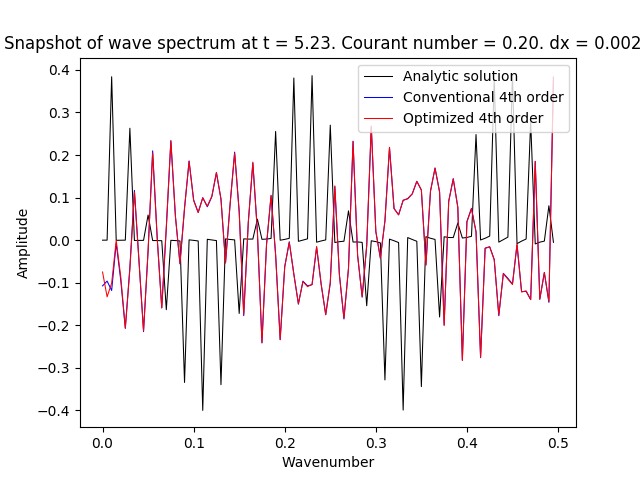

<IPython.core.display.Javascript object>


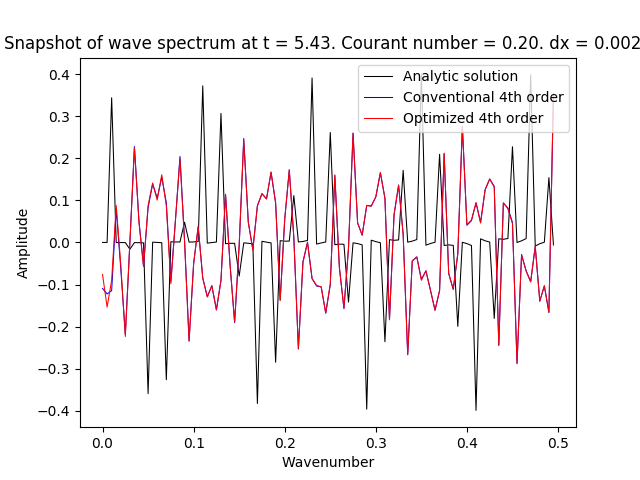

<IPython.core.display.Javascript object>


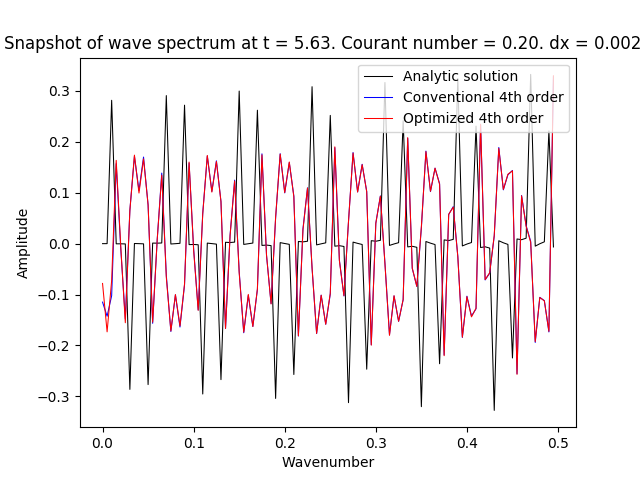

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


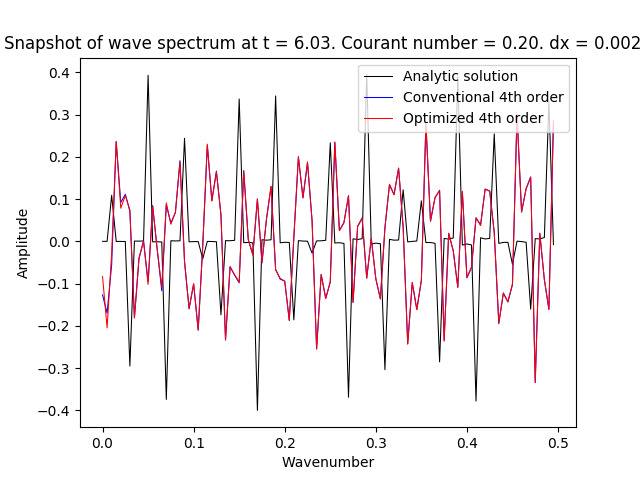

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


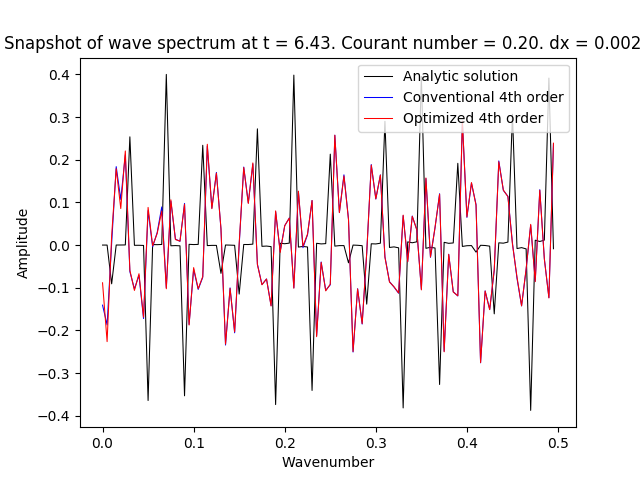

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


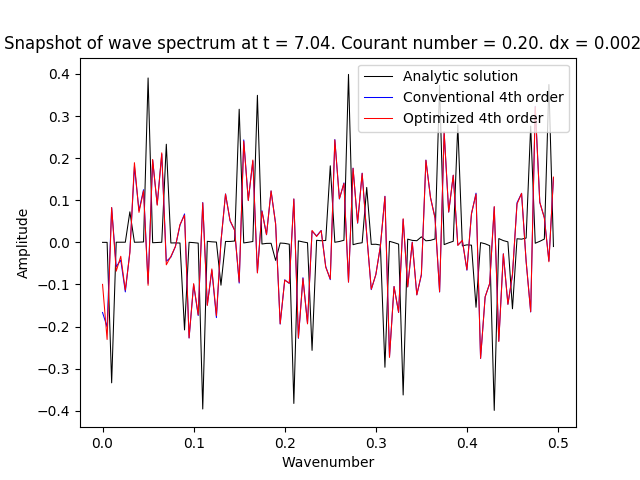

<IPython.core.display.Javascript object>


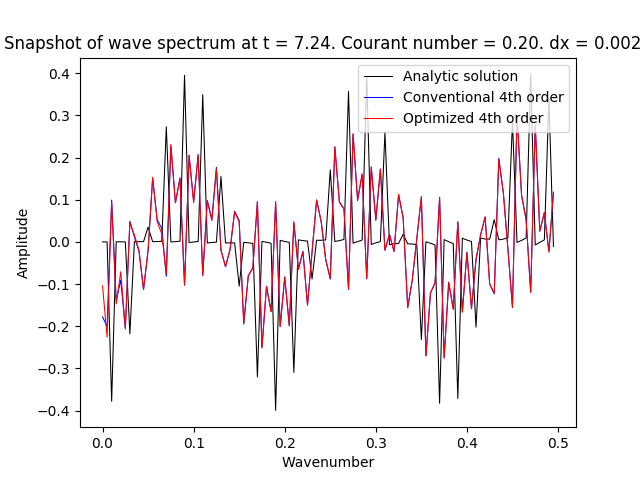

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


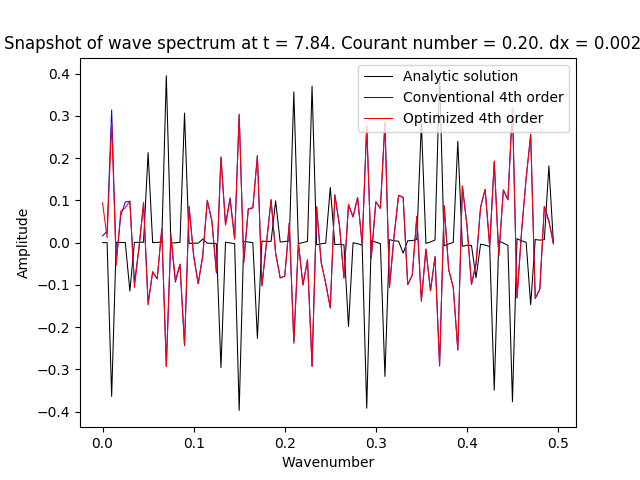

<IPython.core.display.Javascript object>


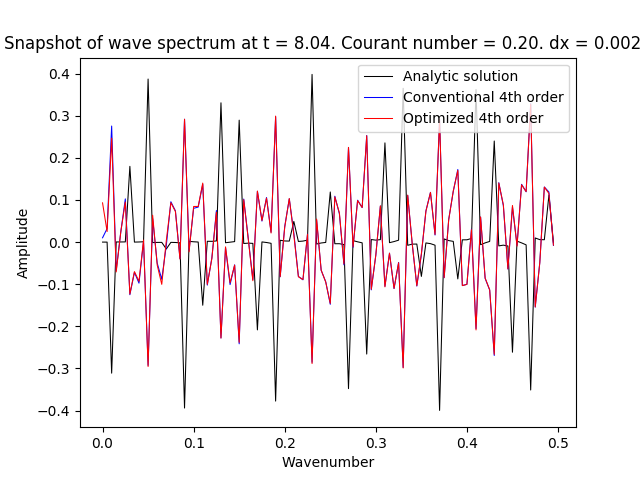

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


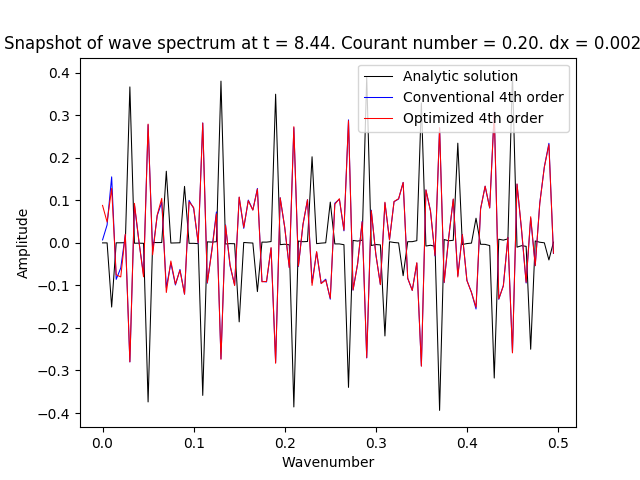

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


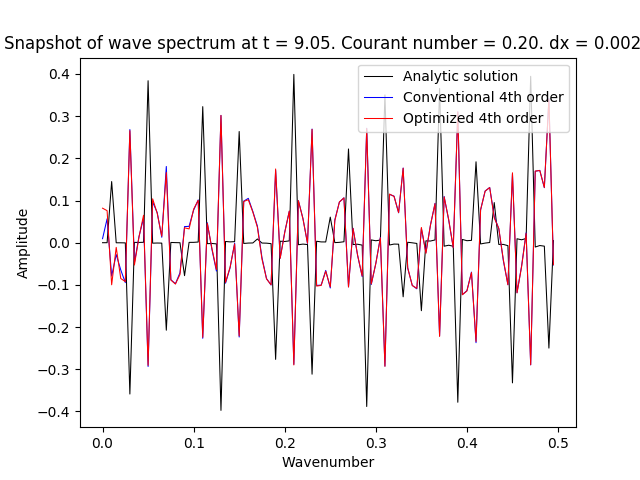

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


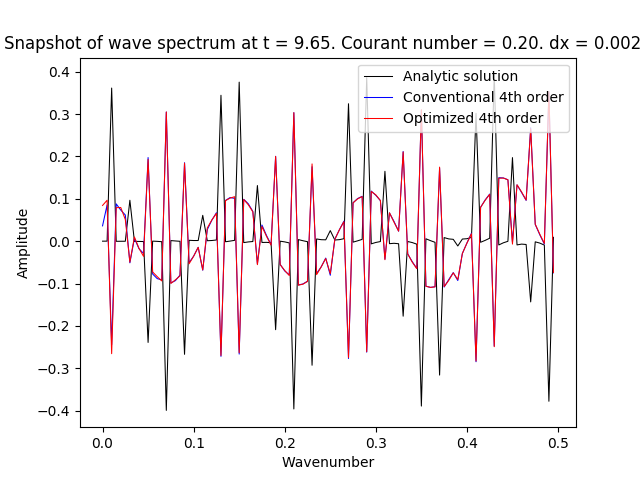

<IPython.core.display.Javascript object>


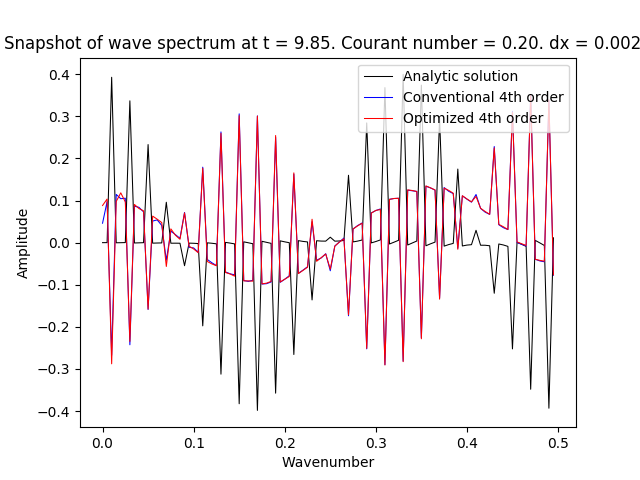

<IPython.core.display.Javascript object>


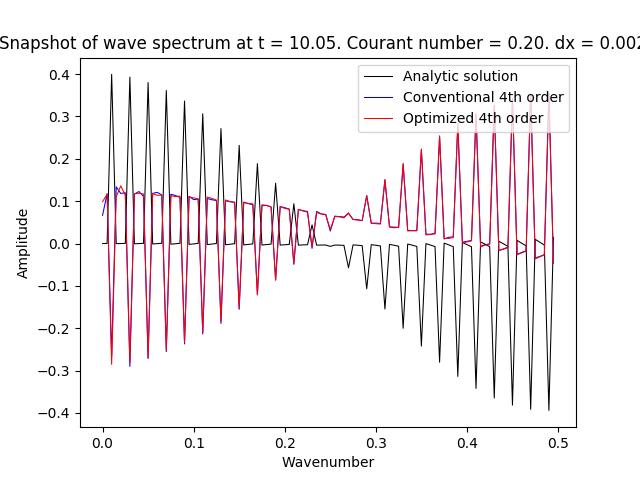

<IPython.core.display.Javascript object>


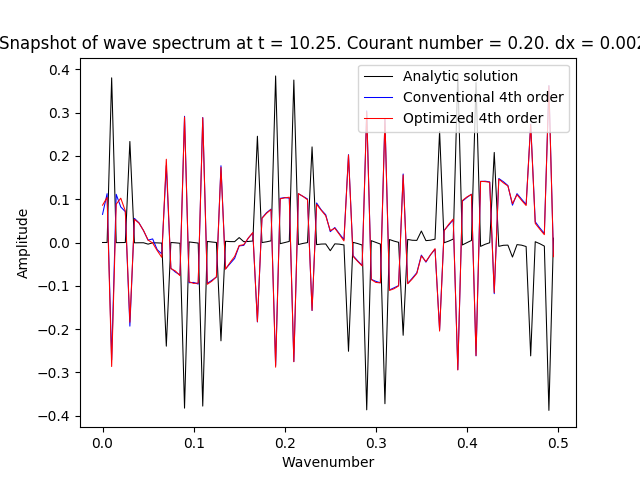

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


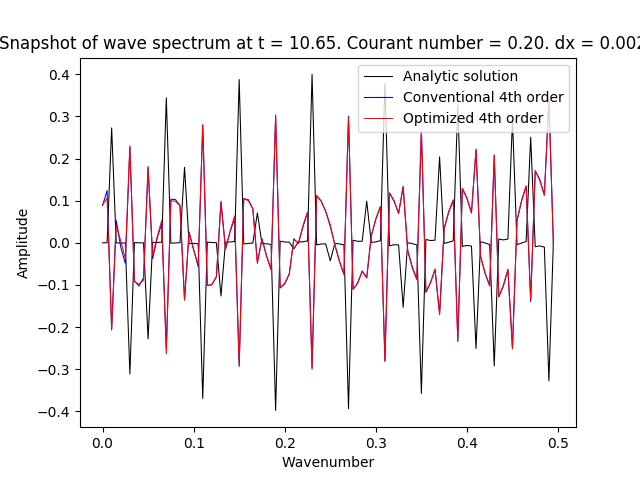

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


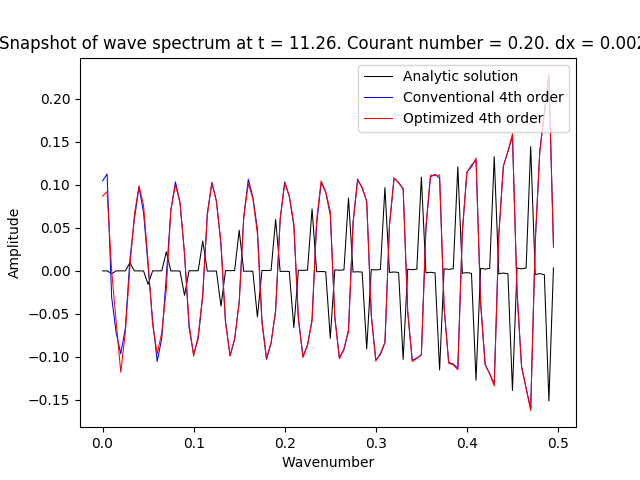

<IPython.core.display.Javascript object>


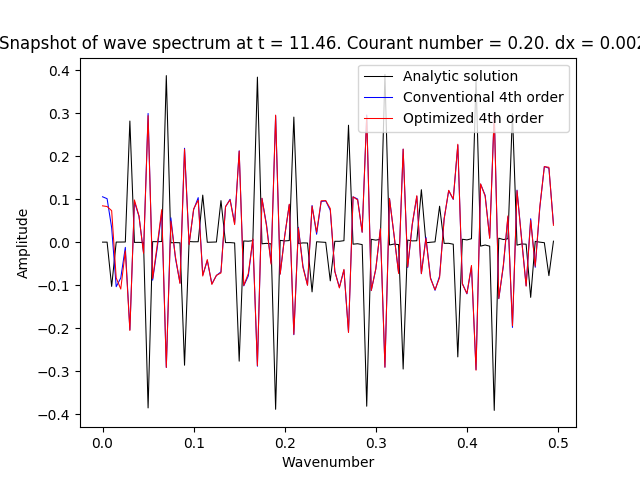

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


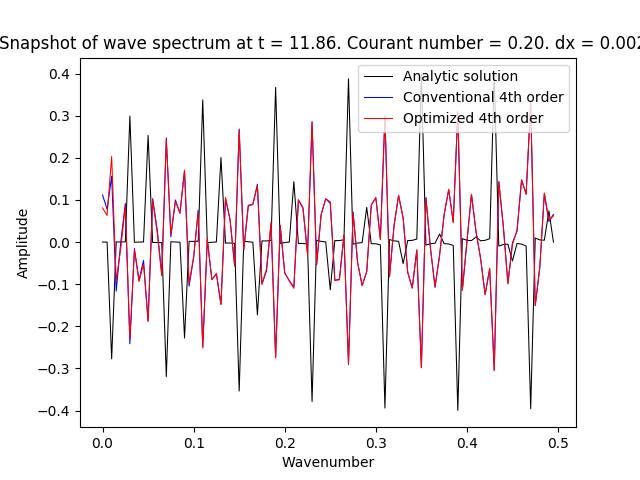

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


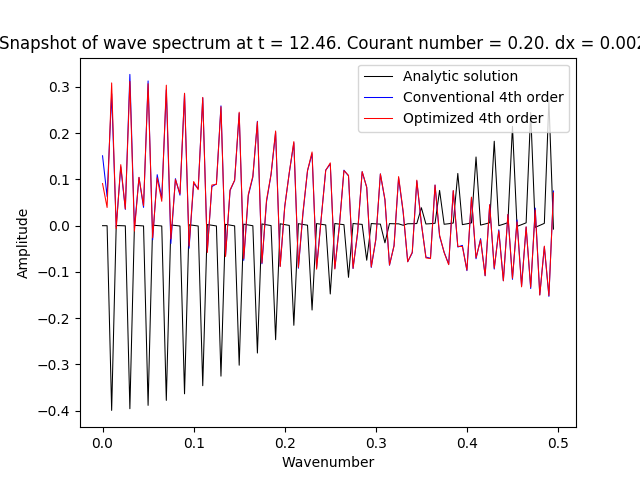

<IPython.core.display.Javascript object>


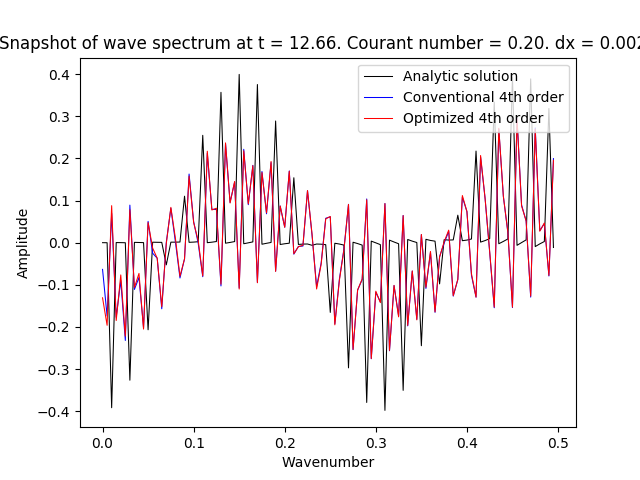

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


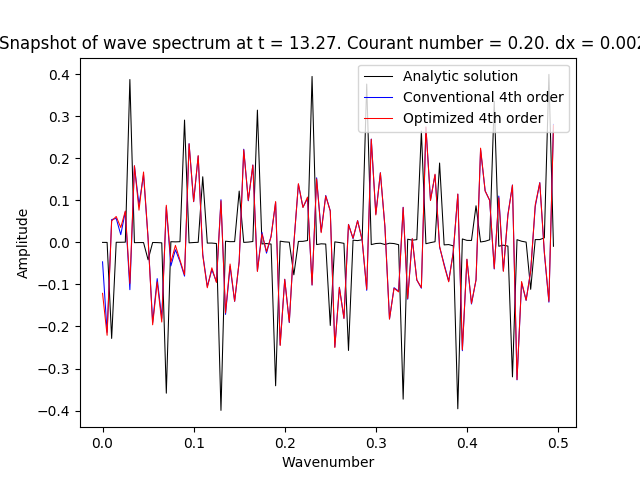

<IPython.core.display.Javascript object>


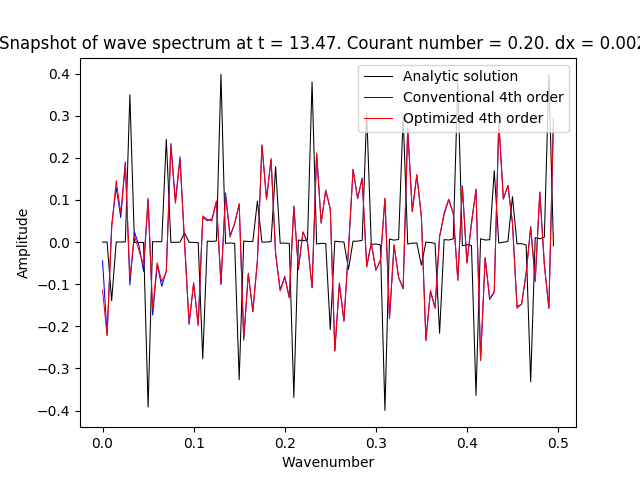

<IPython.core.display.Javascript object>


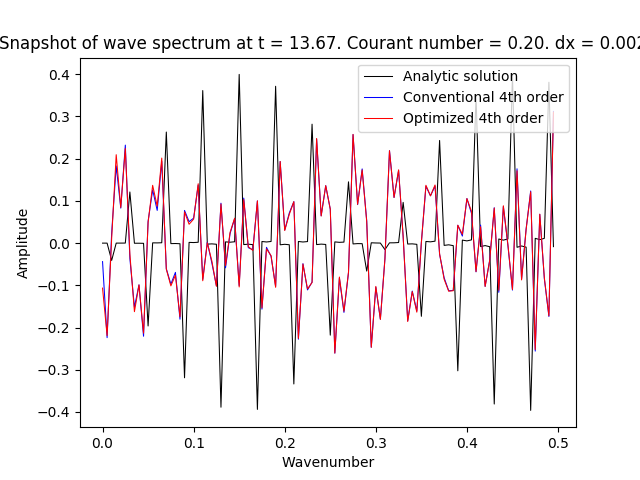

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


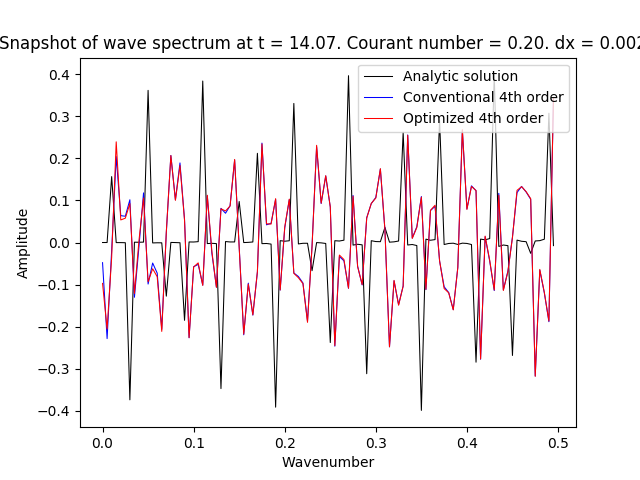

<IPython.core.display.Javascript object>


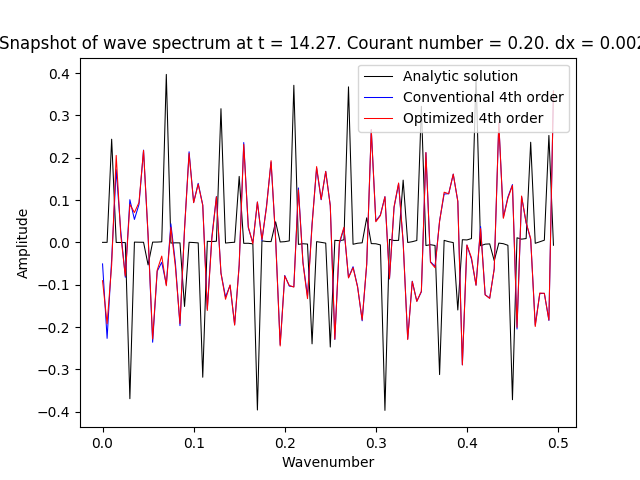

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


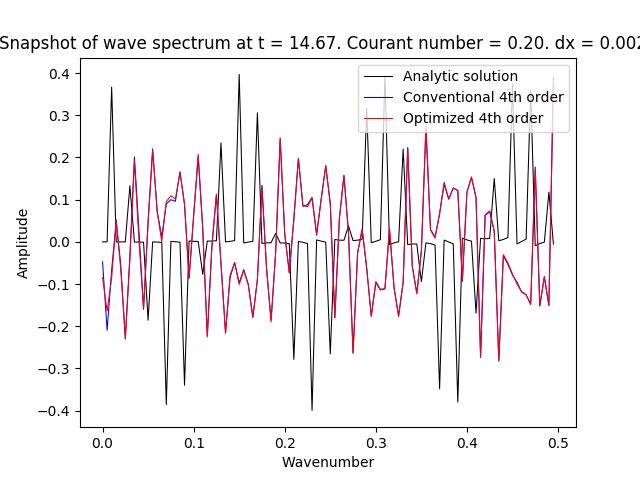

<IPython.core.display.Javascript object>


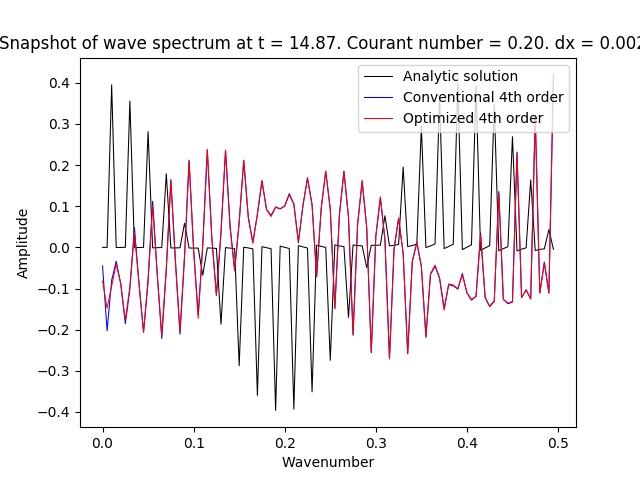

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


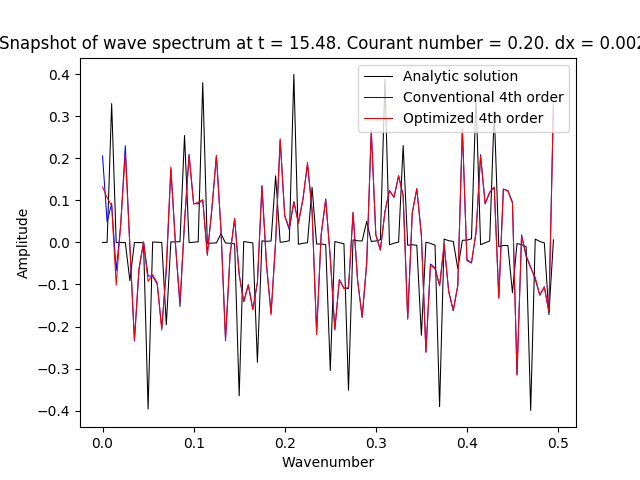

<IPython.core.display.Javascript object>


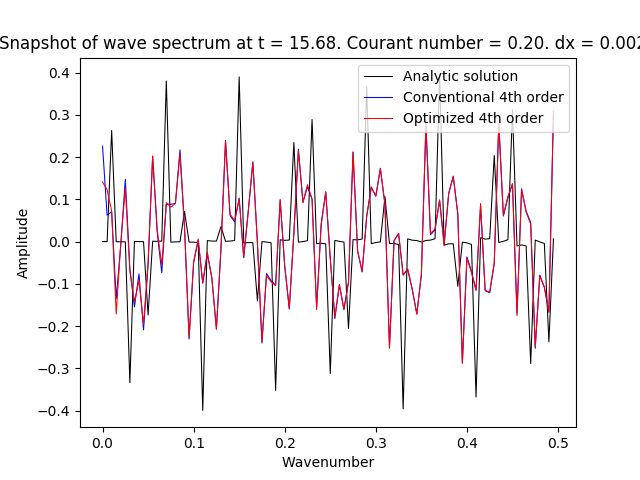

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


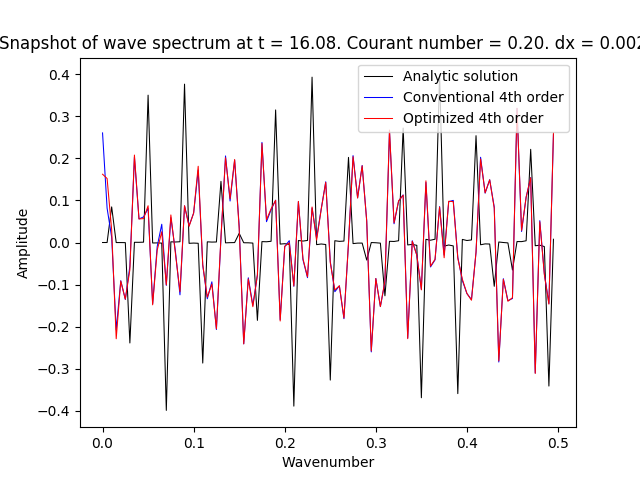

<IPython.core.display.Javascript object>


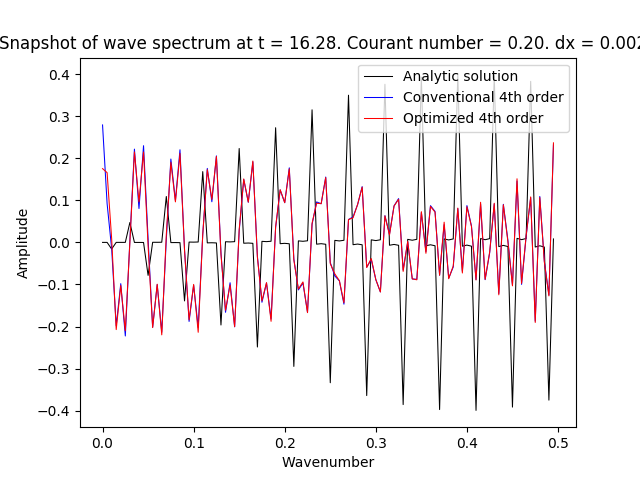

<IPython.core.display.Javascript object>


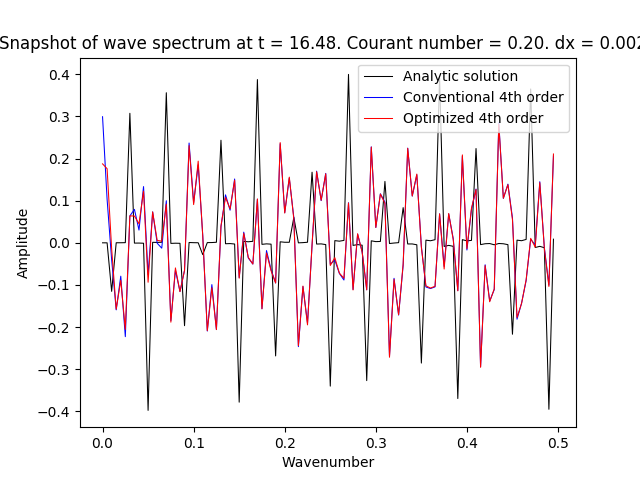

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


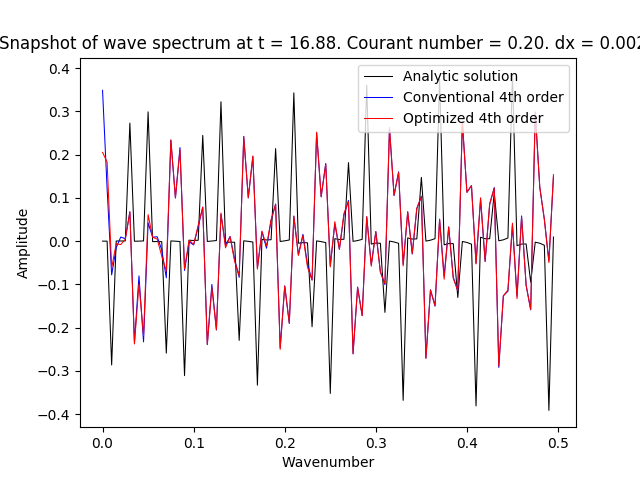

<IPython.core.display.Javascript object>


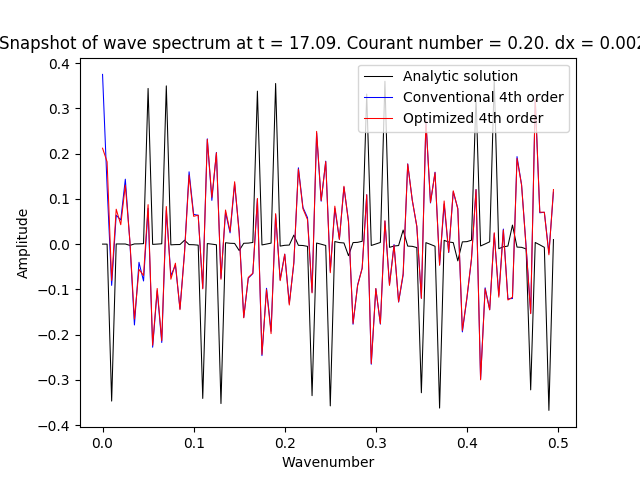

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


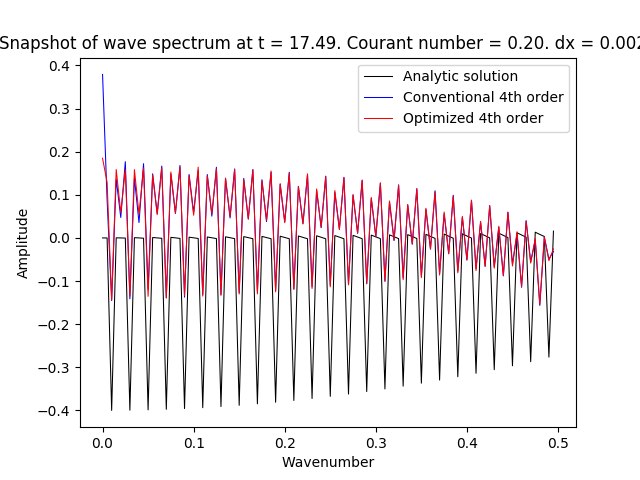

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


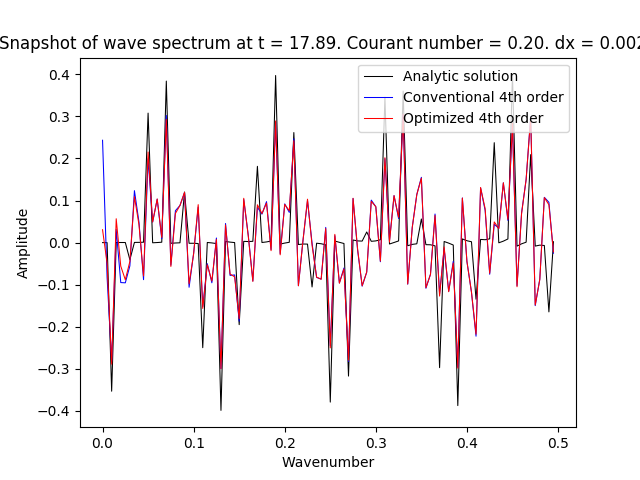

<IPython.core.display.Javascript object>


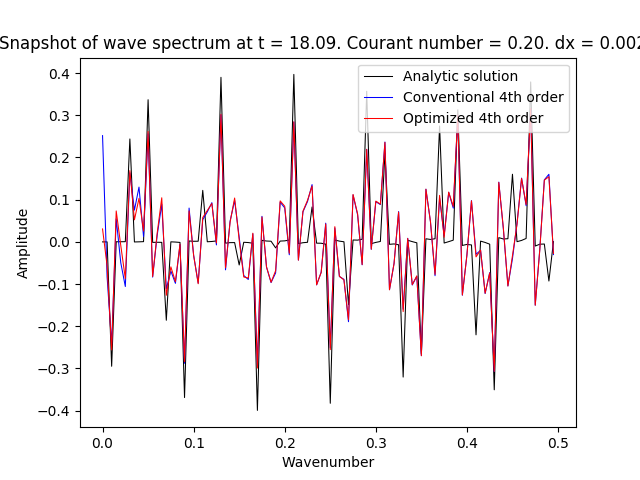

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


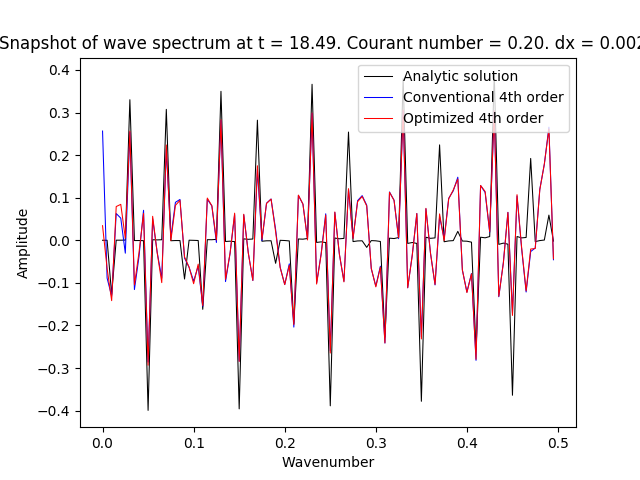

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


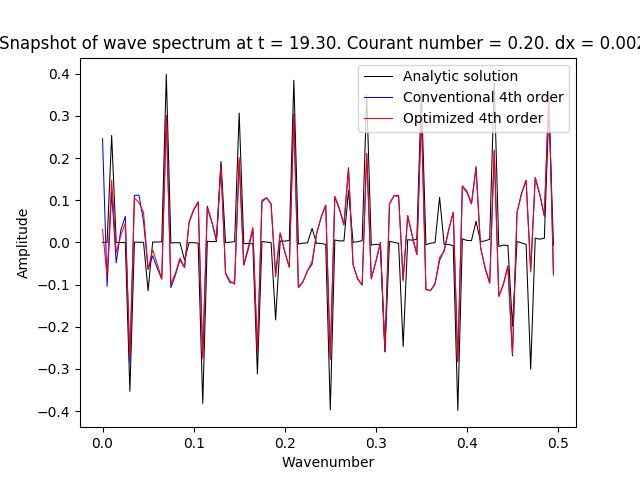

<IPython.core.display.Javascript object>


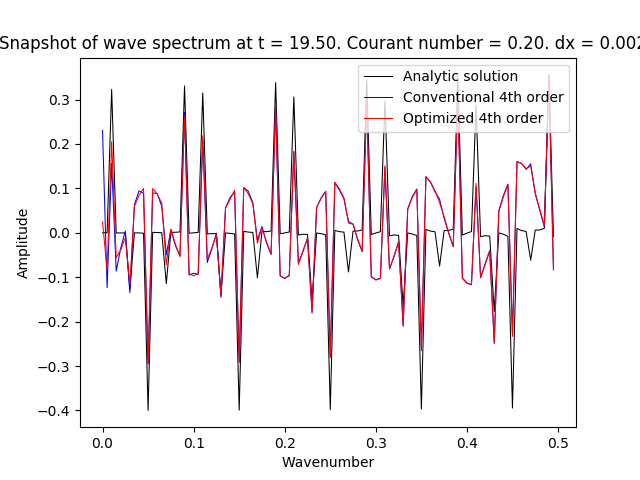

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


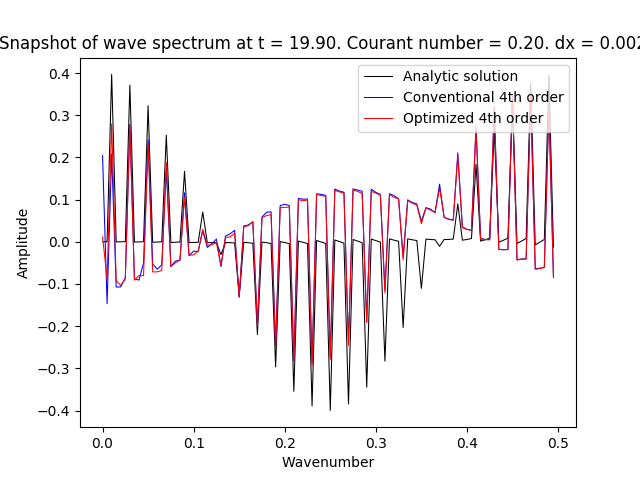

<IPython.core.display.Javascript object>


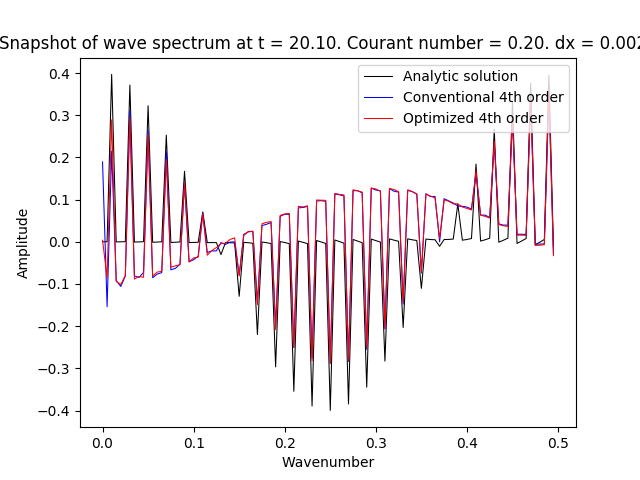

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


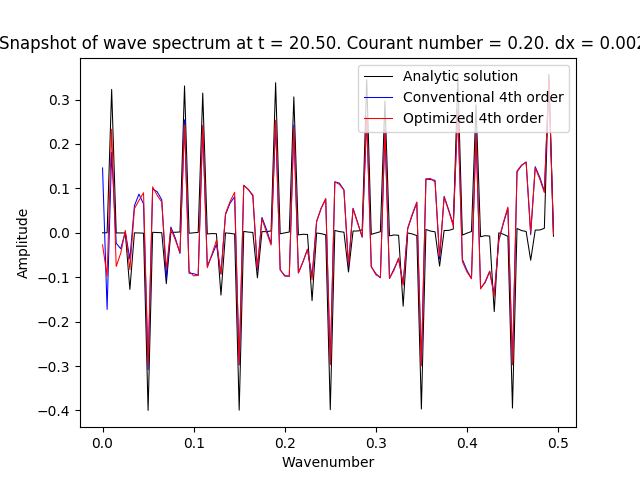

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


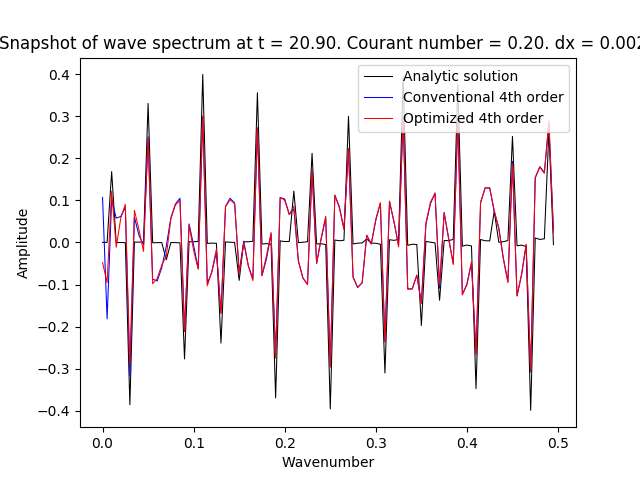

<IPython.core.display.Javascript object>


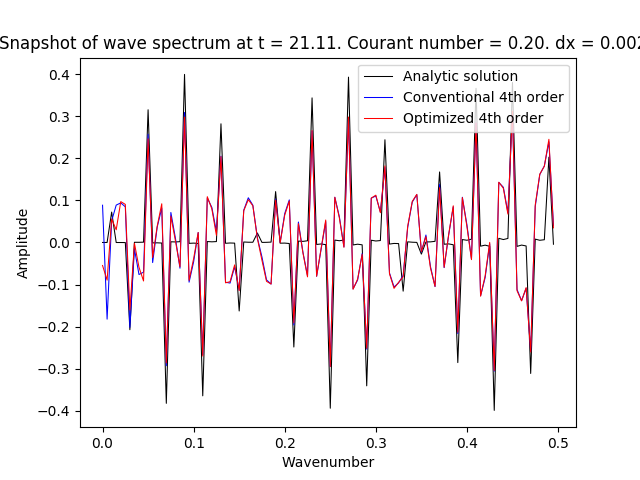

<IPython.core.display.Javascript object>


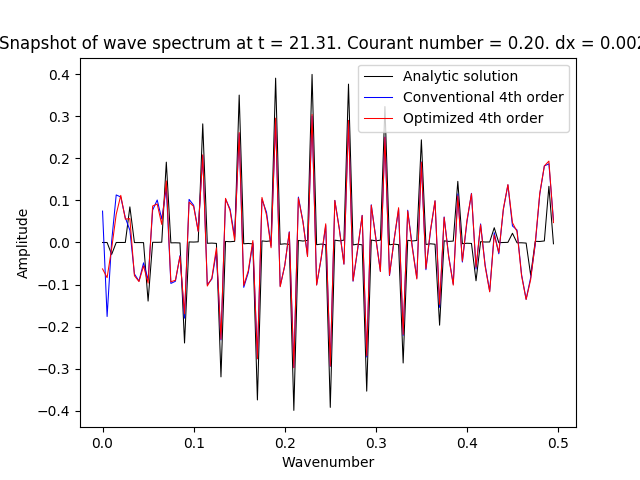

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


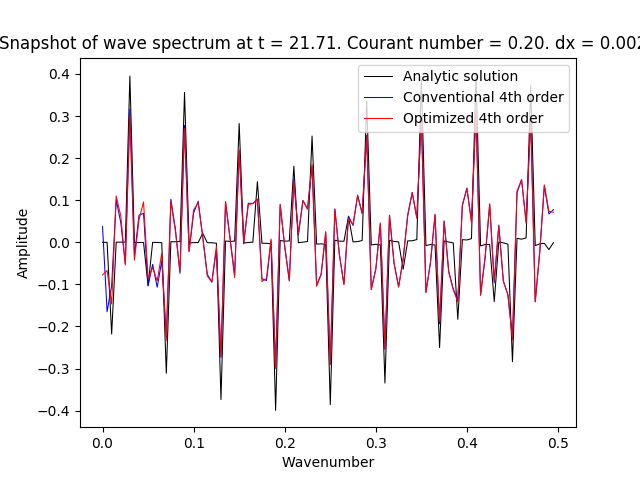

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


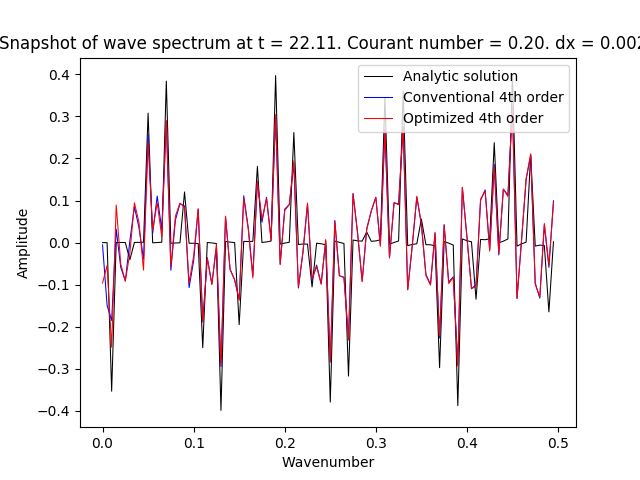

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


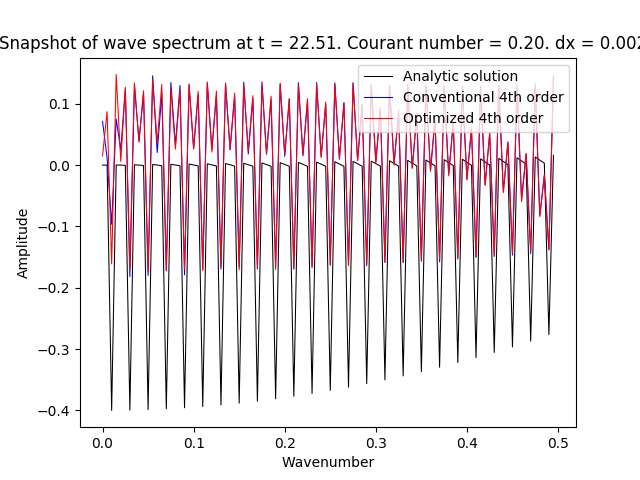

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


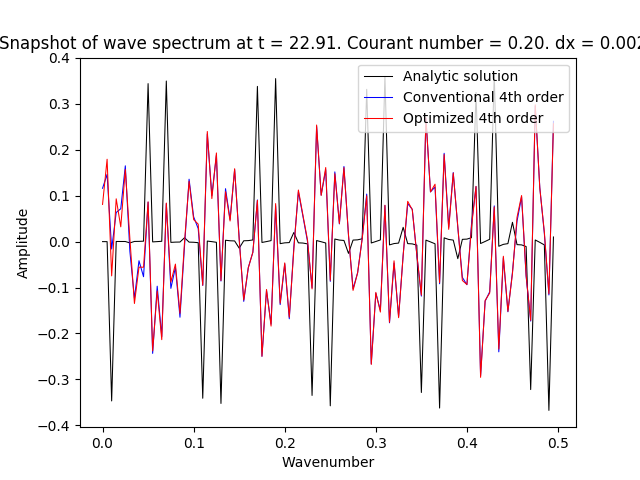

<IPython.core.display.Javascript object>


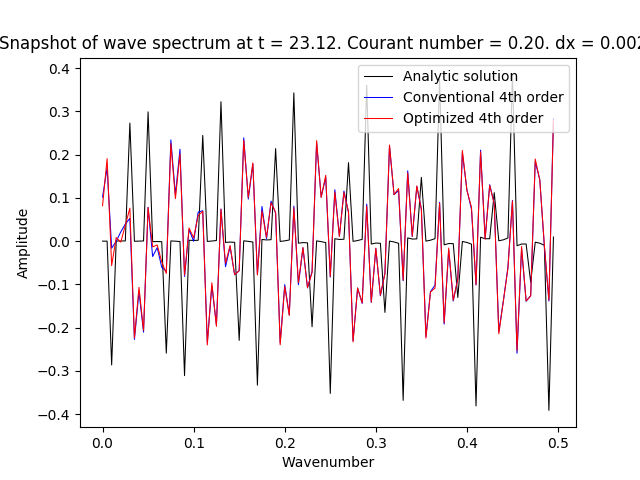

<IPython.core.display.Javascript object>


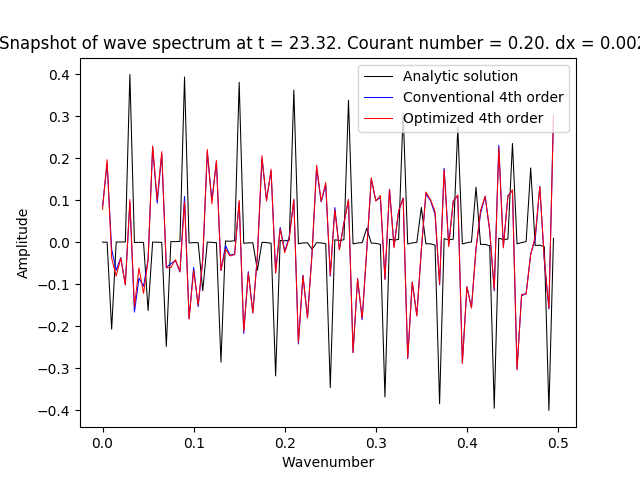

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


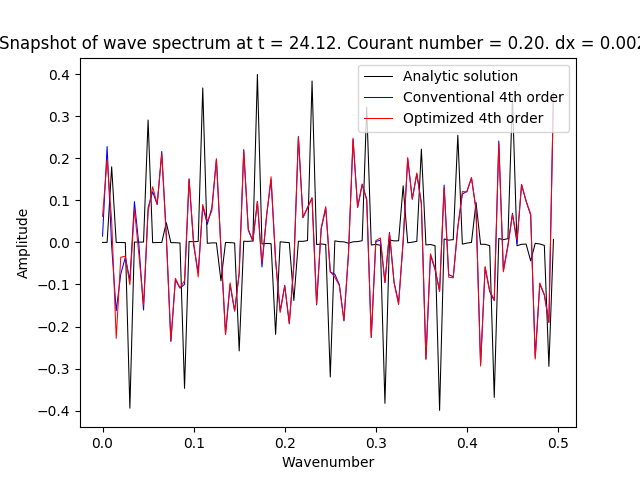

<IPython.core.display.Javascript object>


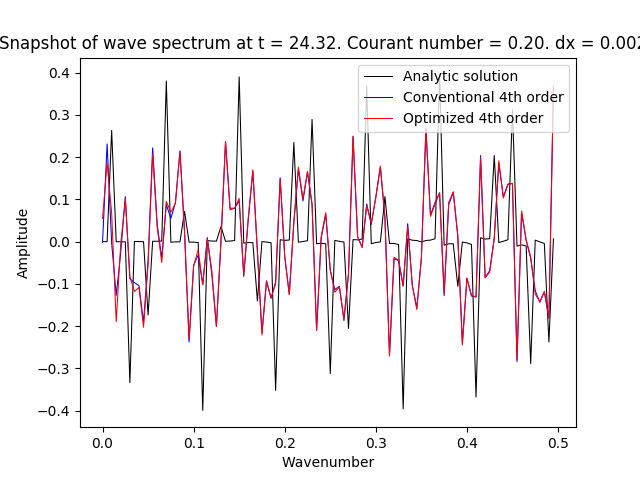

<IPython.core.display.Javascript object>


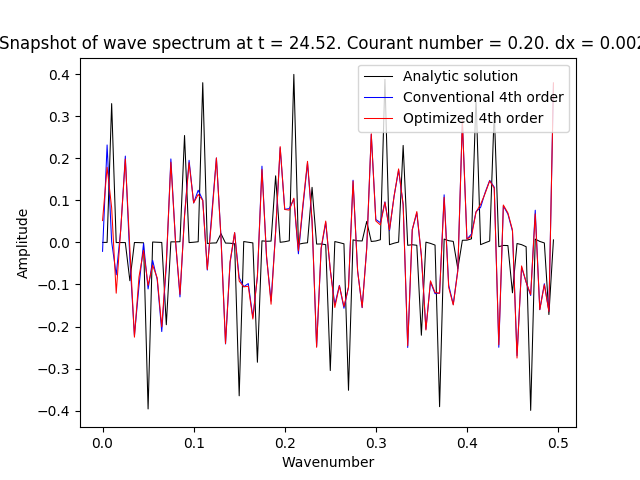

<IPython.core.display.Javascript object>


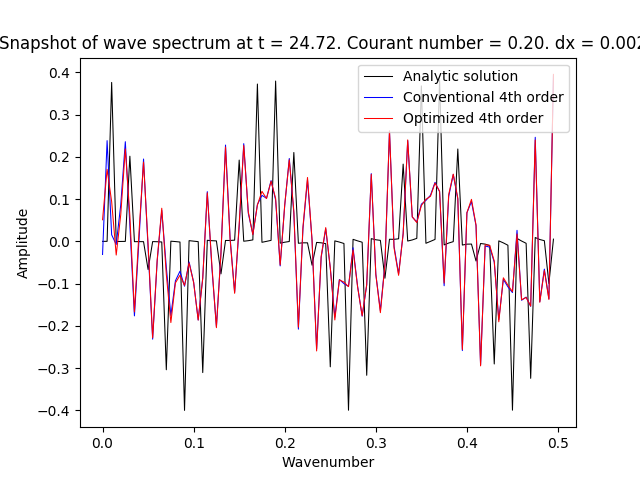

<IPython.core.display.Javascript object>


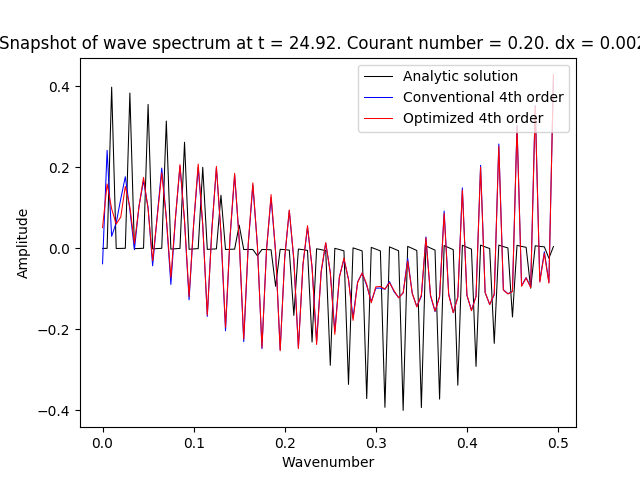

<IPython.core.display.Javascript object>


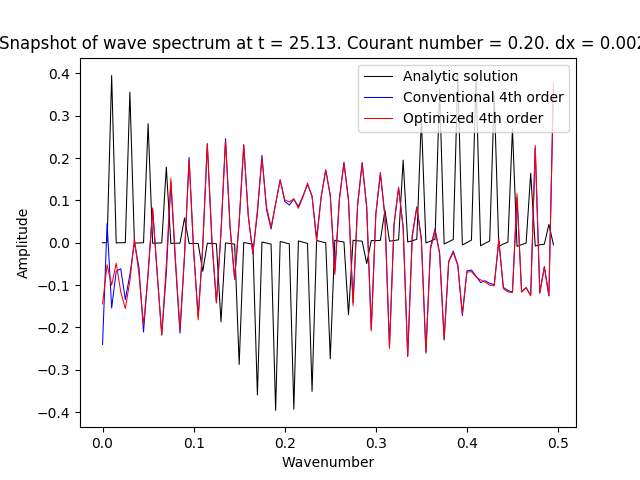

<IPython.core.display.Javascript object>


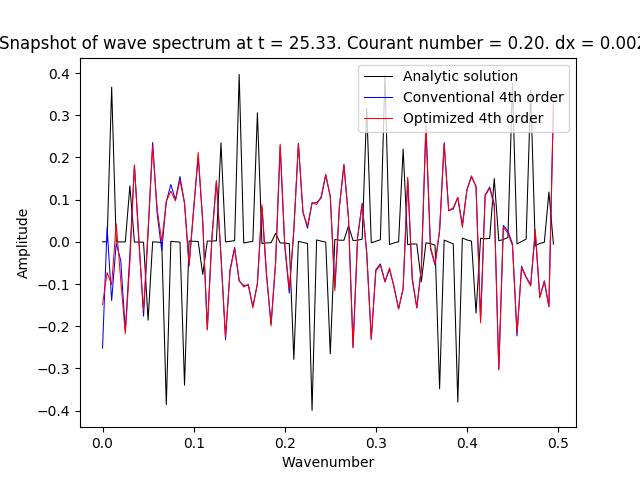

<IPython.core.display.Javascript object>


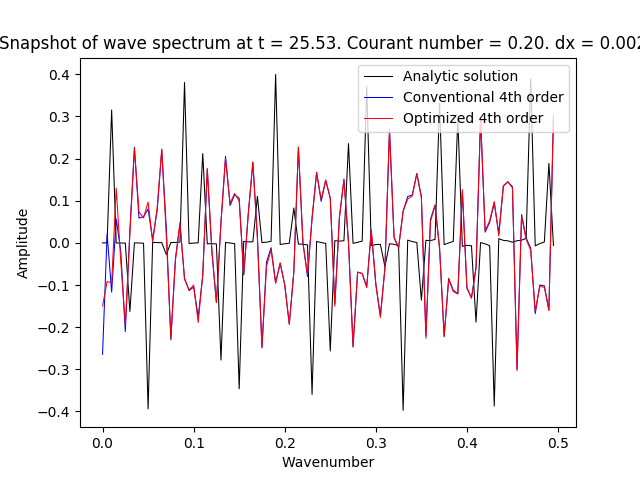

<IPython.core.display.Javascript object>


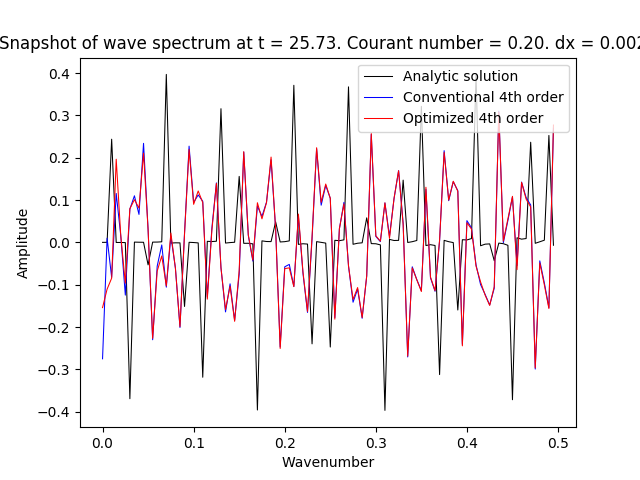

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


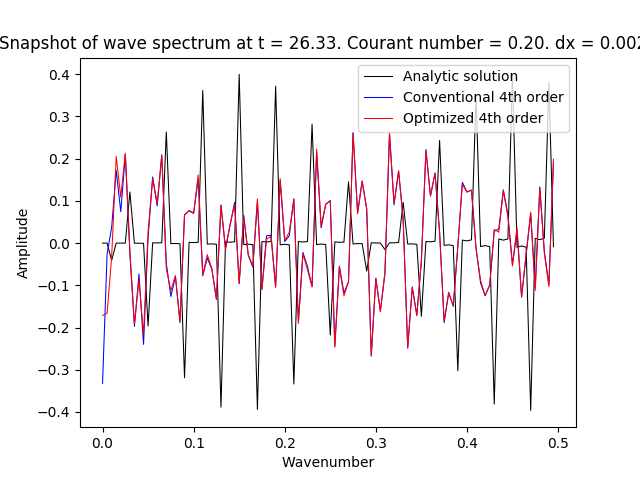

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


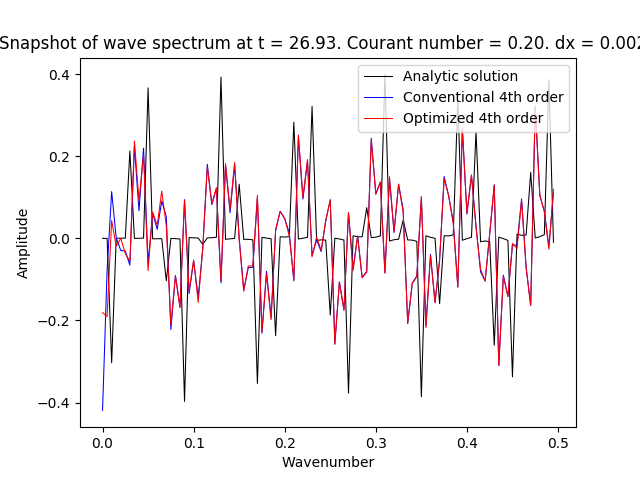

<IPython.core.display.Javascript object>


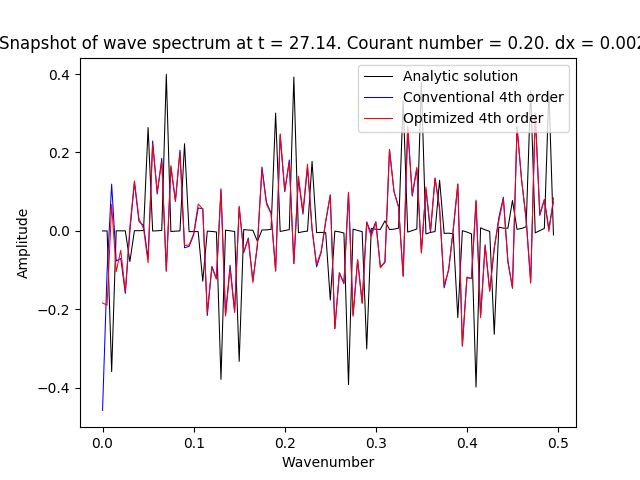

<IPython.core.display.Javascript object>


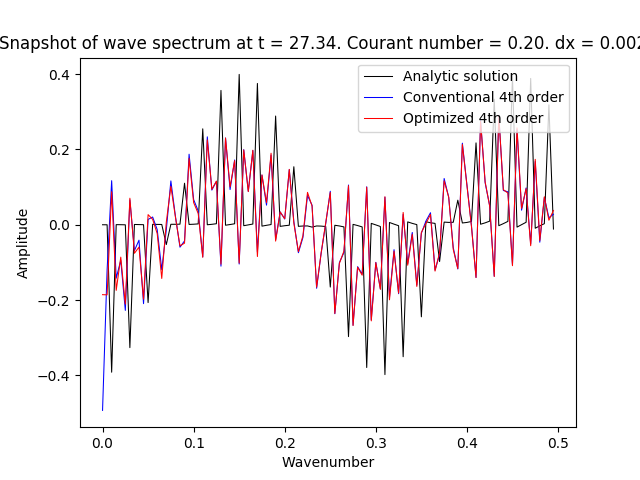

<IPython.core.display.Javascript object>


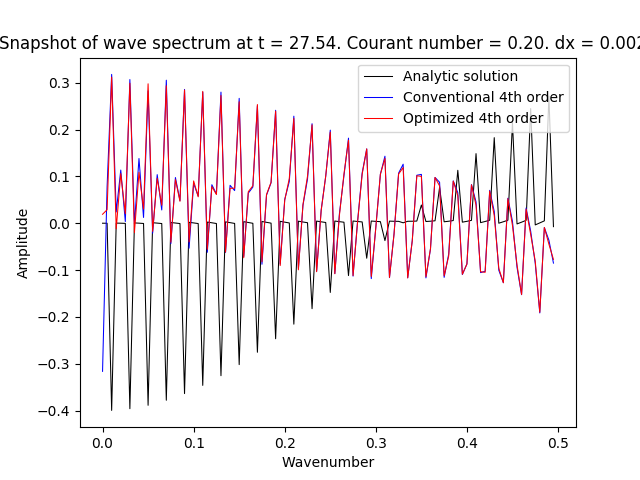

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


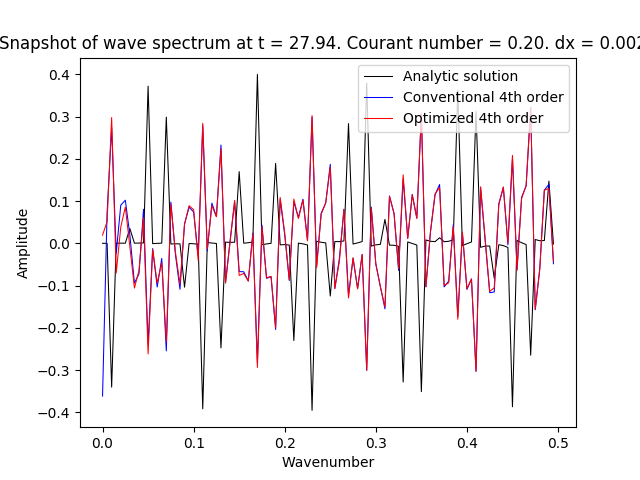

<IPython.core.display.Javascript object>


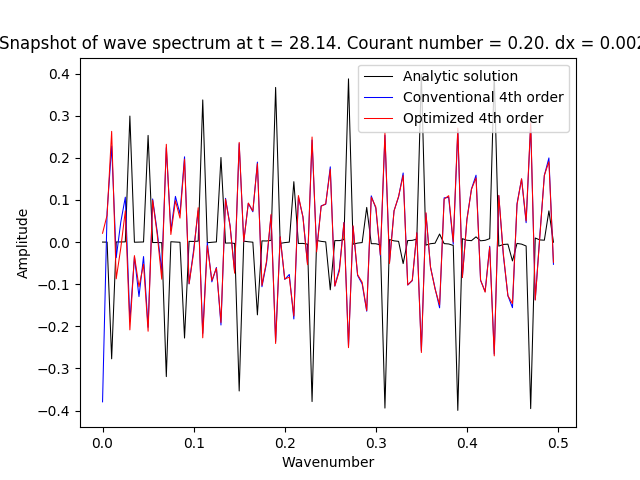

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


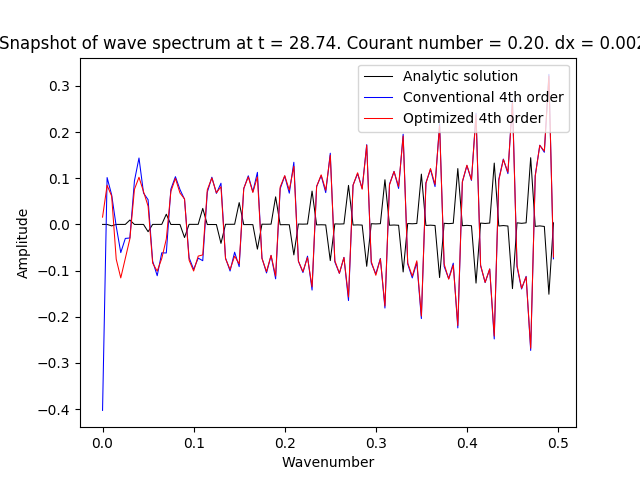

<IPython.core.display.Javascript object>


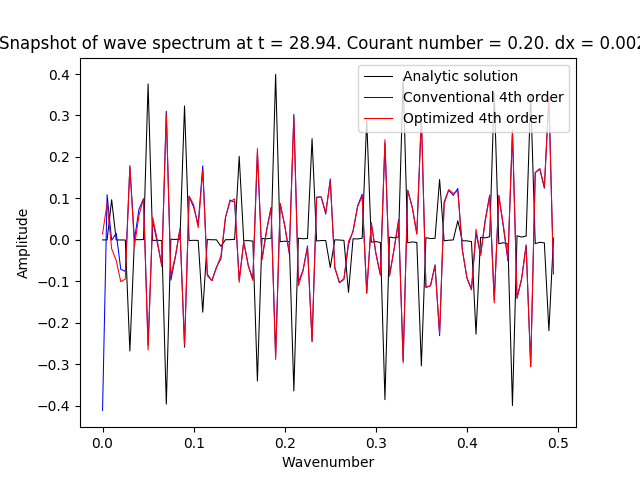

<IPython.core.display.Javascript object>


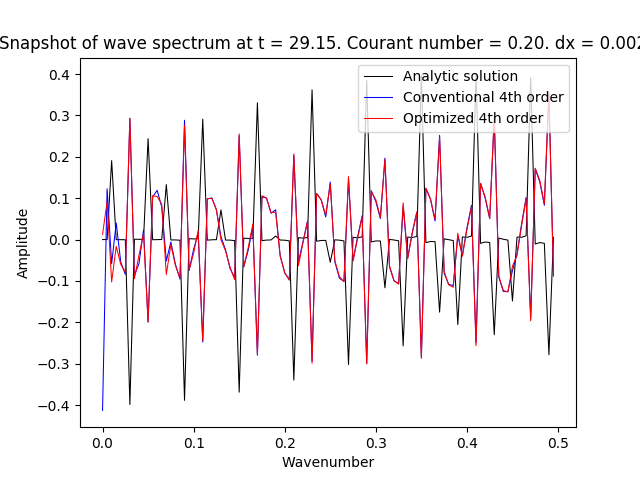

<IPython.core.display.Javascript object>


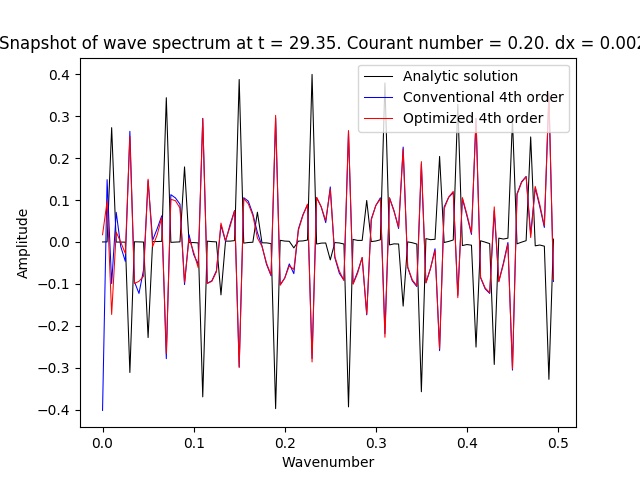

<IPython.core.display.Javascript object>


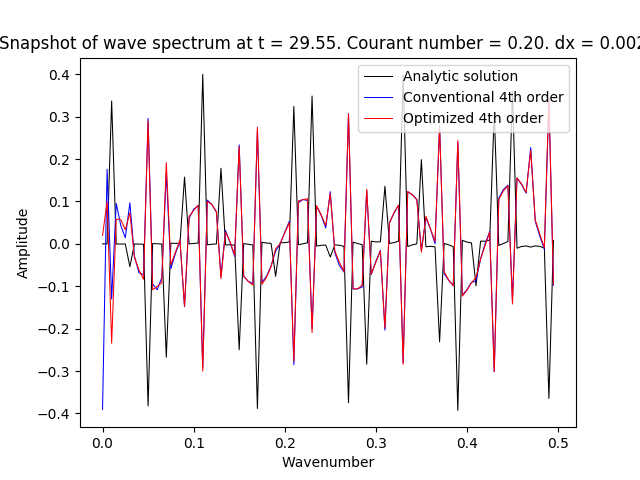

<IPython.core.display.Javascript object>


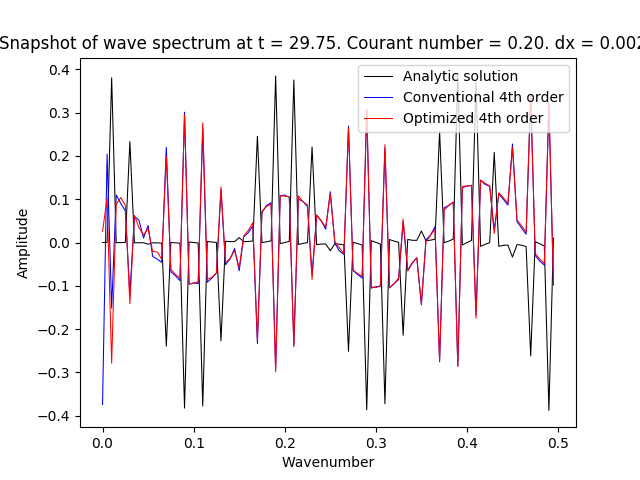

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


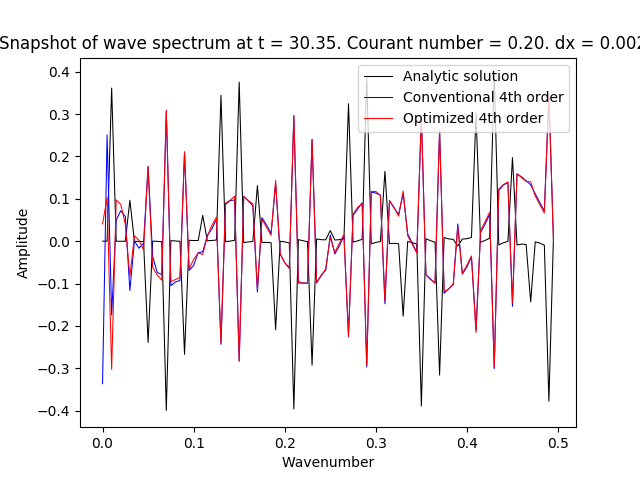

<IPython.core.display.Javascript object>


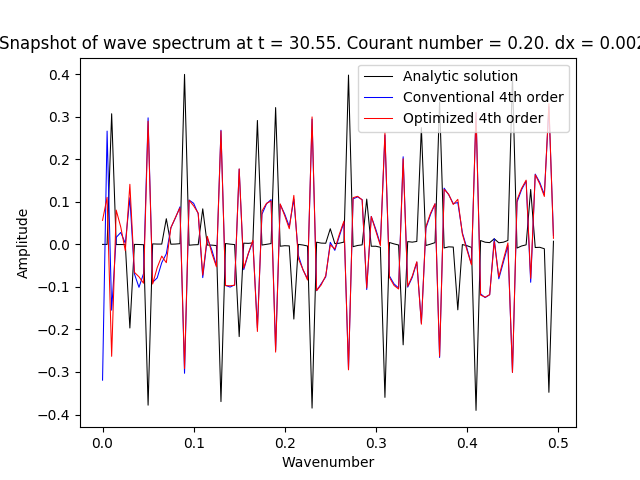

<IPython.core.display.Javascript object>


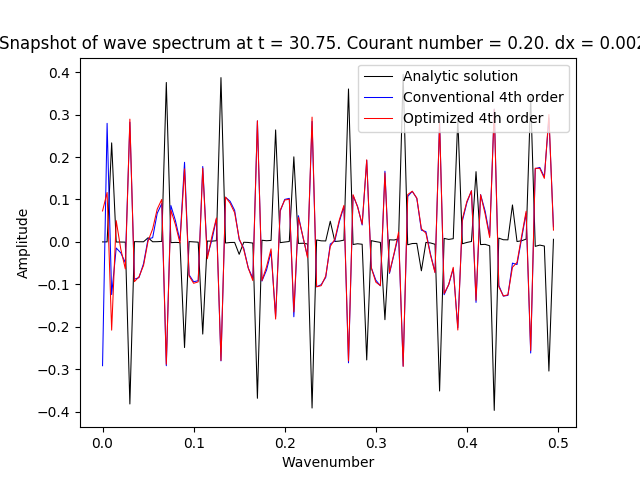

<IPython.core.display.Javascript object>


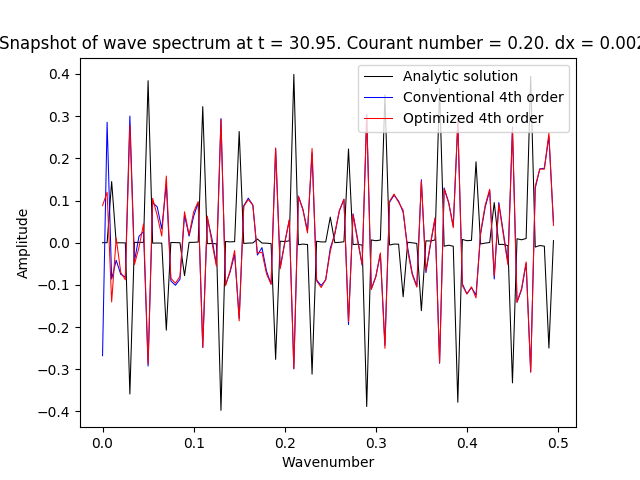

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


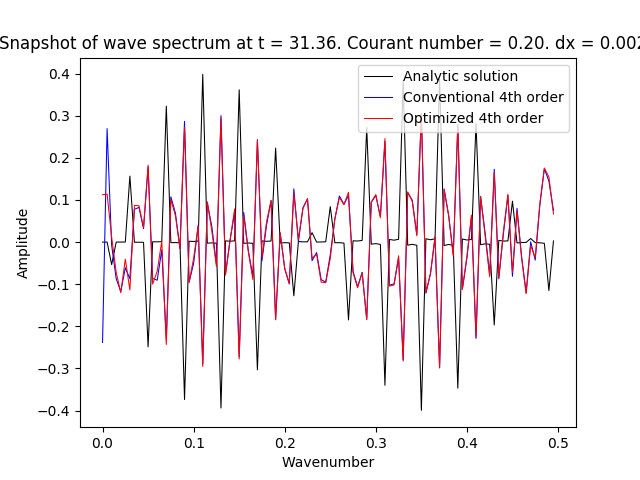

<IPython.core.display.Javascript object>


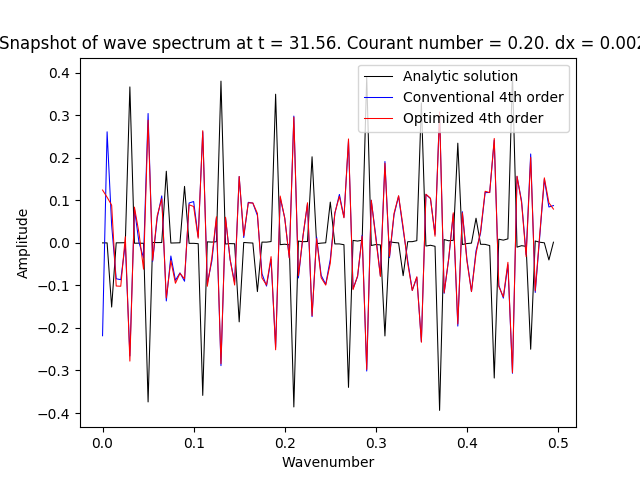

<IPython.core.display.Javascript object>


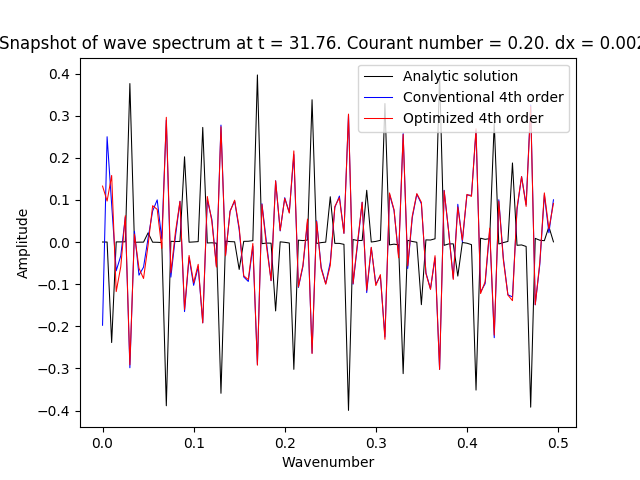

<IPython.core.display.Javascript object>


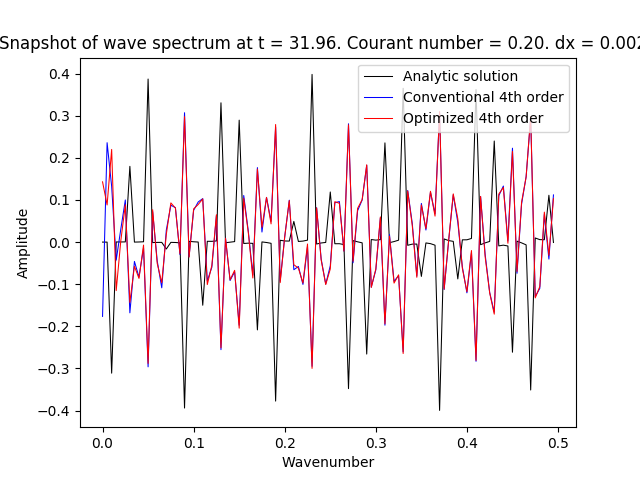

<IPython.core.display.Javascript object>


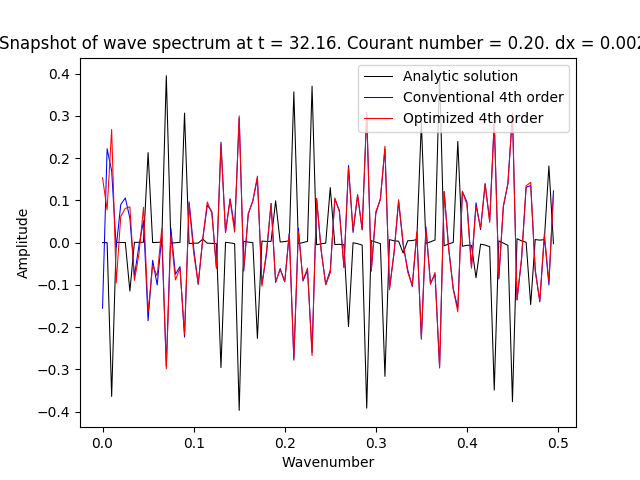

<IPython.core.display.Javascript object>


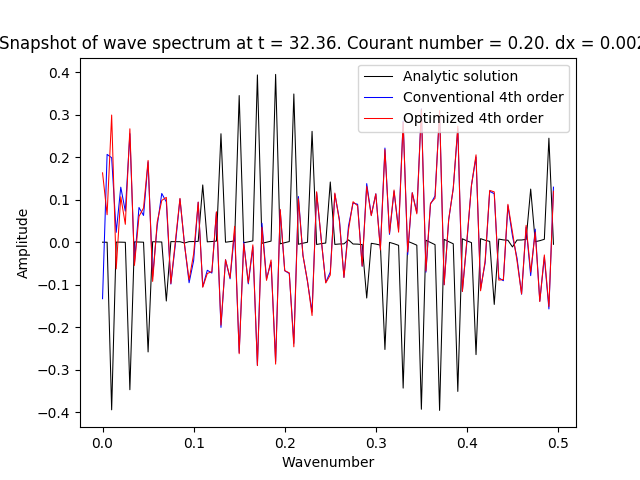

<IPython.core.display.Javascript object>


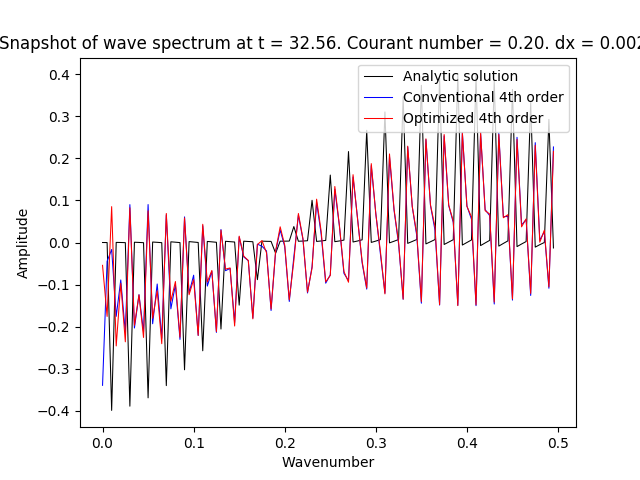

<IPython.core.display.Javascript object>


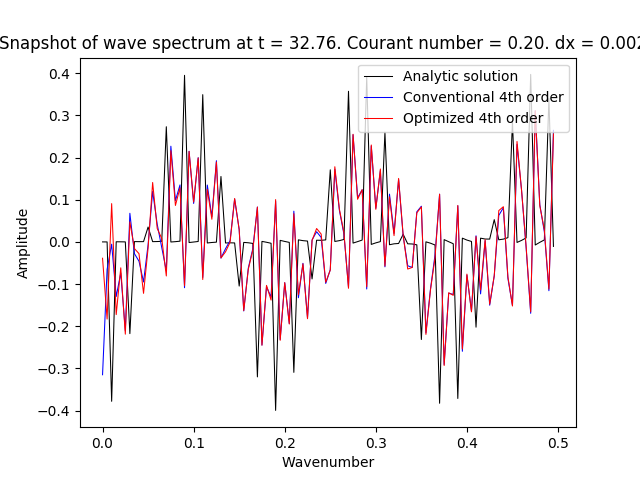

<IPython.core.display.Javascript object>


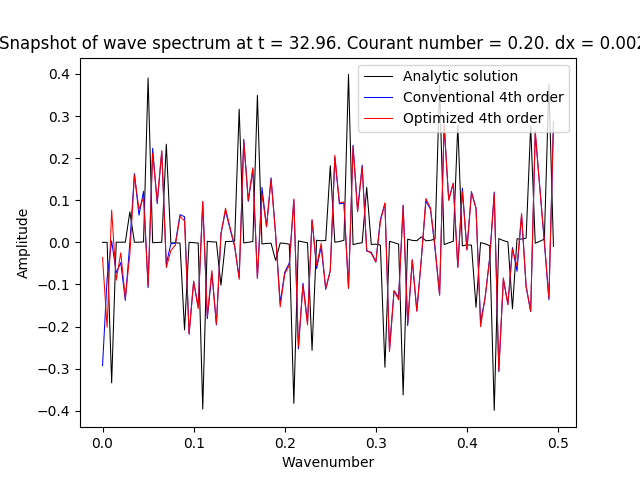

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


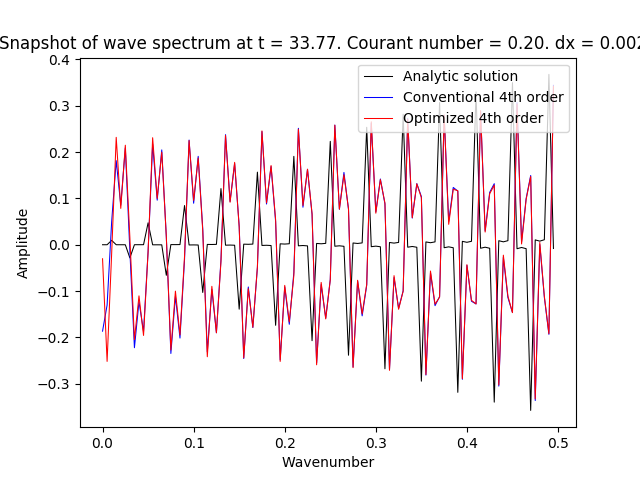

<IPython.core.display.Javascript object>


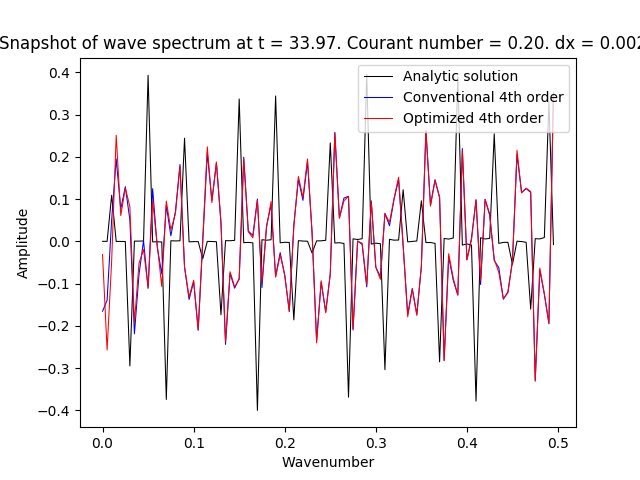

<IPython.core.display.Javascript object>


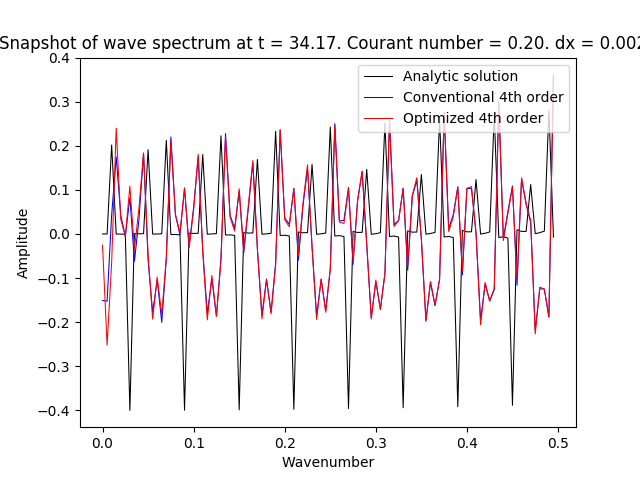

<IPython.core.display.Javascript object>


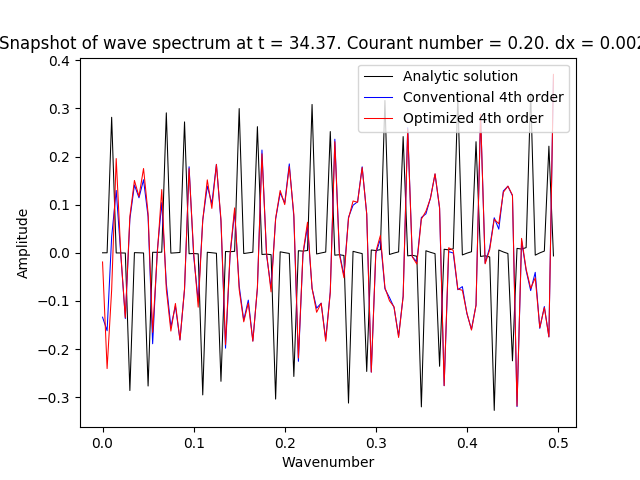

<IPython.core.display.Javascript object>


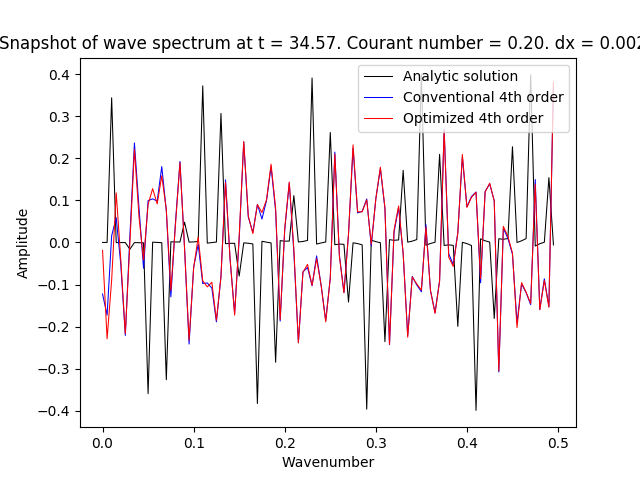

<IPython.core.display.Javascript object>


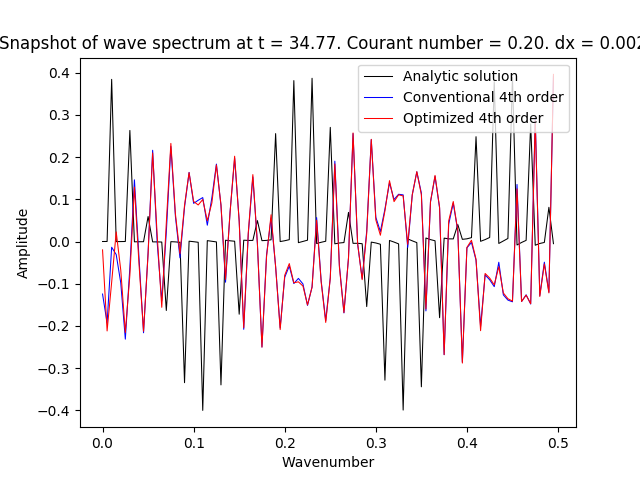

<IPython.core.display.Javascript object>


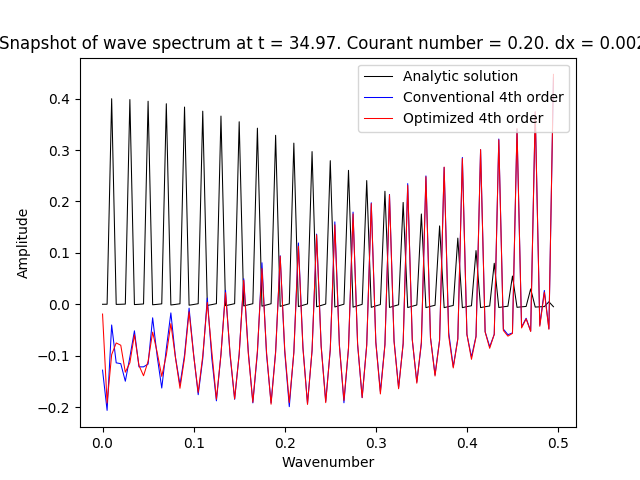

<IPython.core.display.Javascript object>


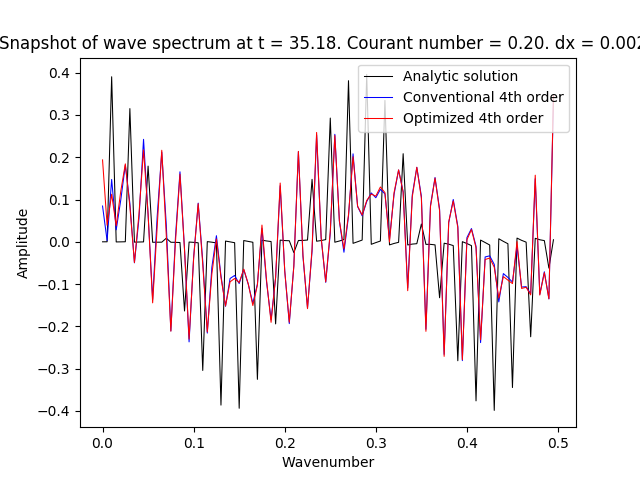

<IPython.core.display.Javascript object>


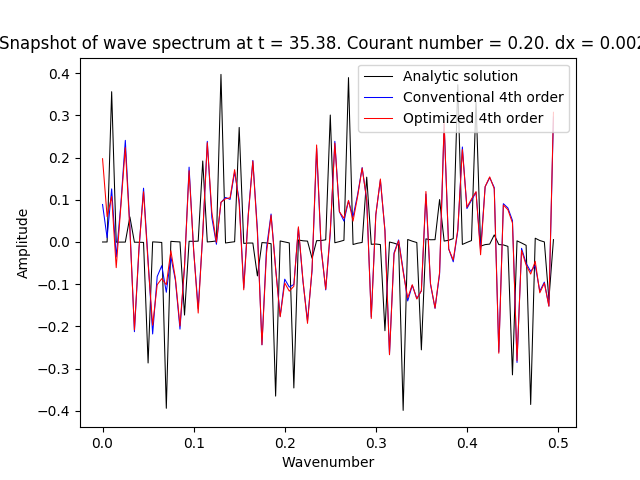

<IPython.core.display.Javascript object>


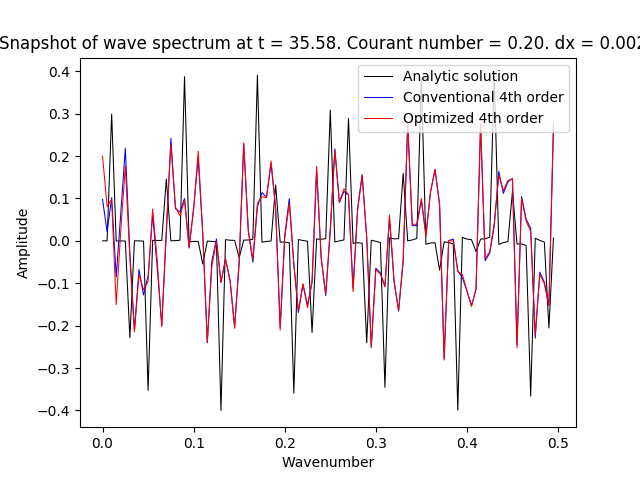

<IPython.core.display.Javascript object>


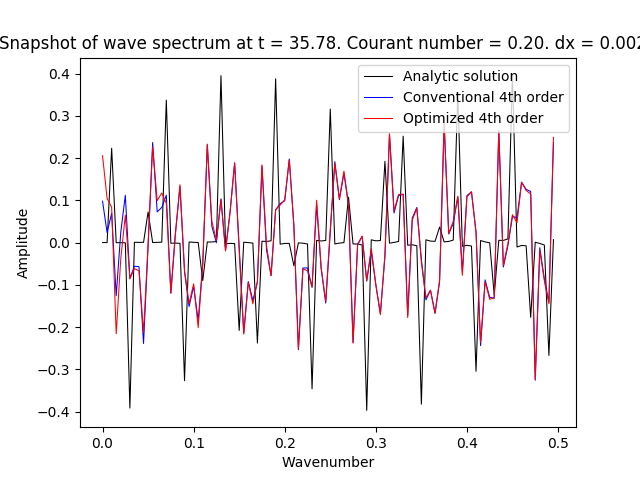

<IPython.core.display.Javascript object>


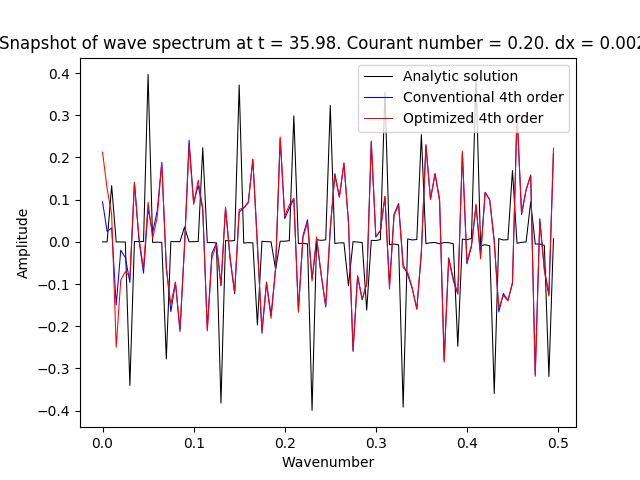

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


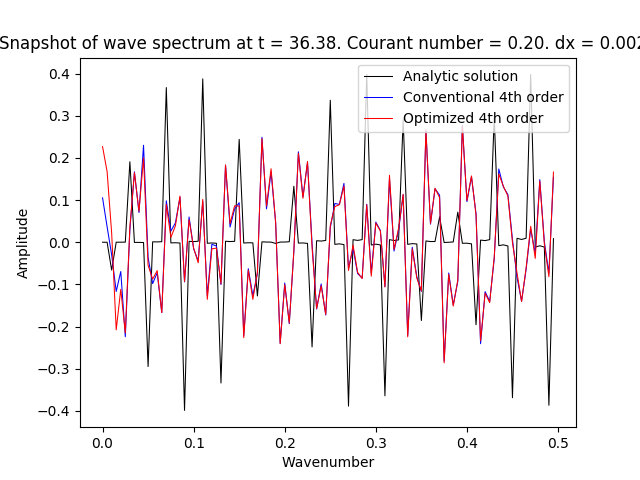

<IPython.core.display.Javascript object>


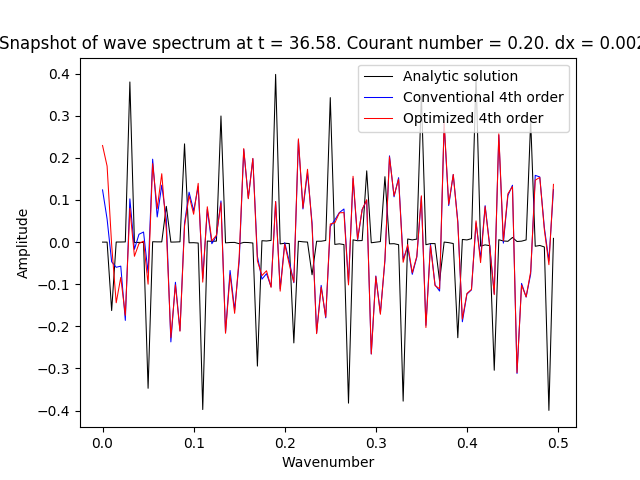

<IPython.core.display.Javascript object>


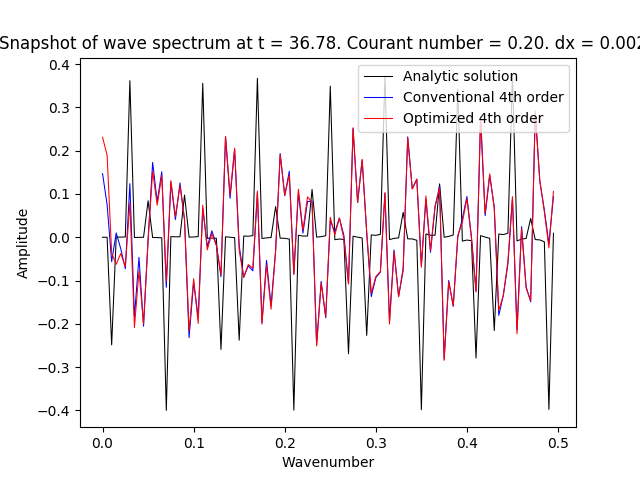

<IPython.core.display.Javascript object>


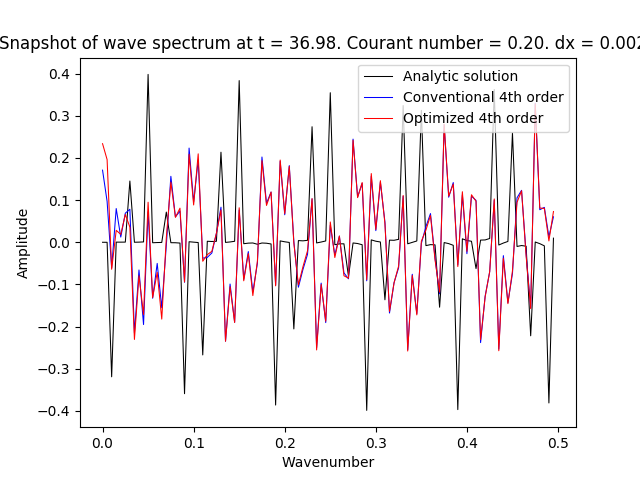

<IPython.core.display.Javascript object>


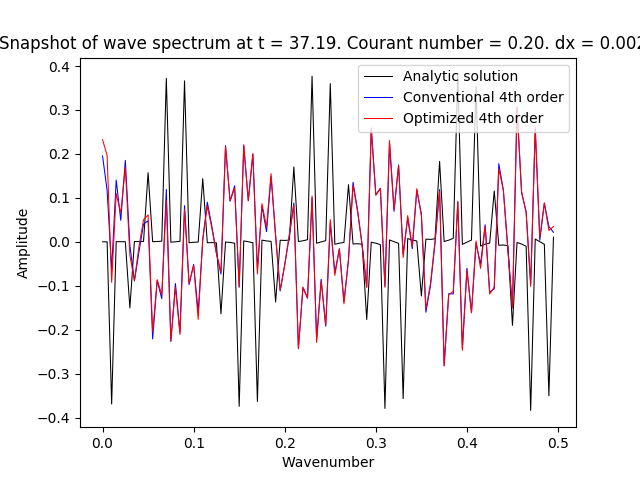

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


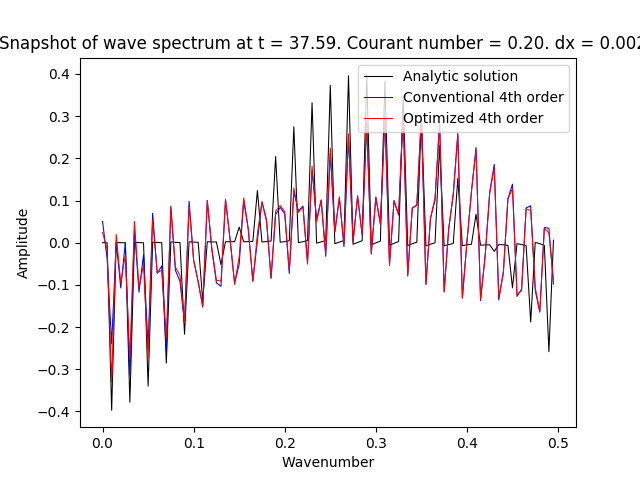

<IPython.core.display.Javascript object>


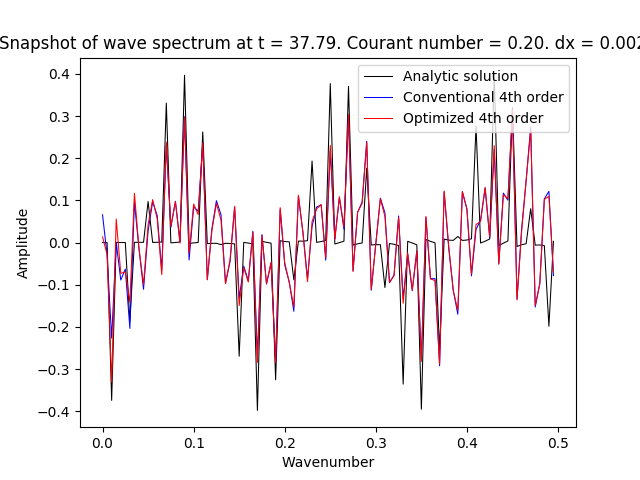

<IPython.core.display.Javascript object>


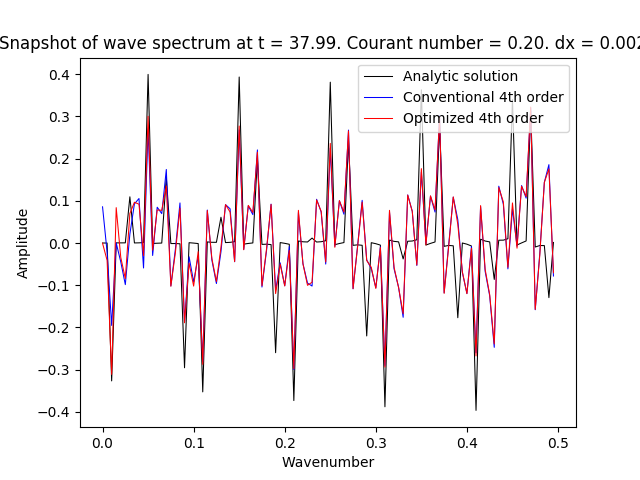

<IPython.core.display.Javascript object>


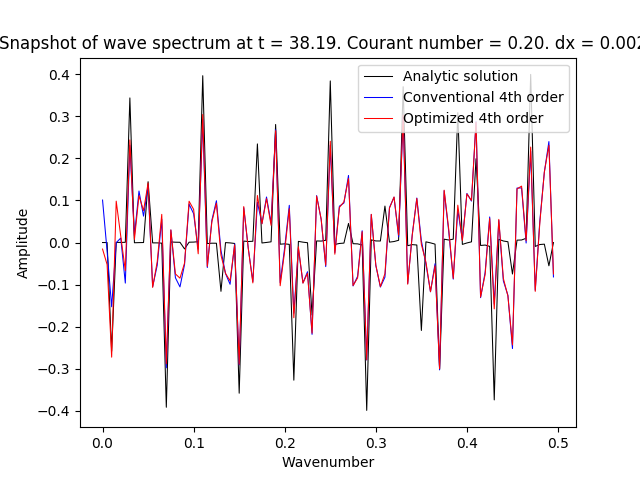

<IPython.core.display.Javascript object>


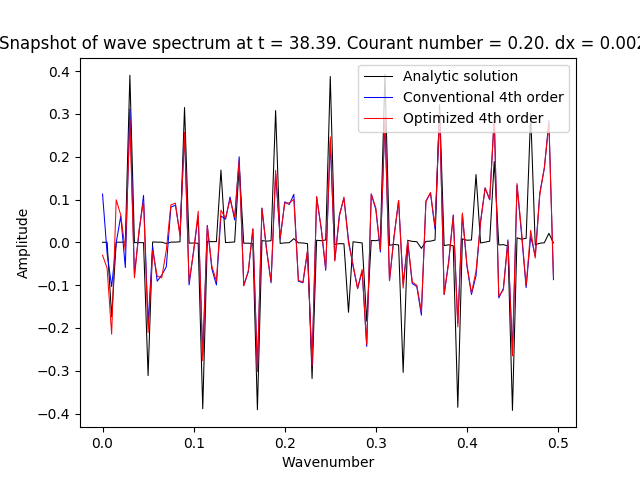

<IPython.core.display.Javascript object>


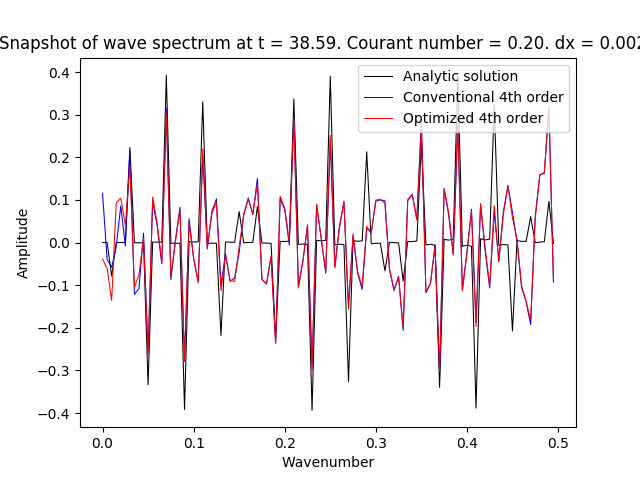

<IPython.core.display.Javascript object>


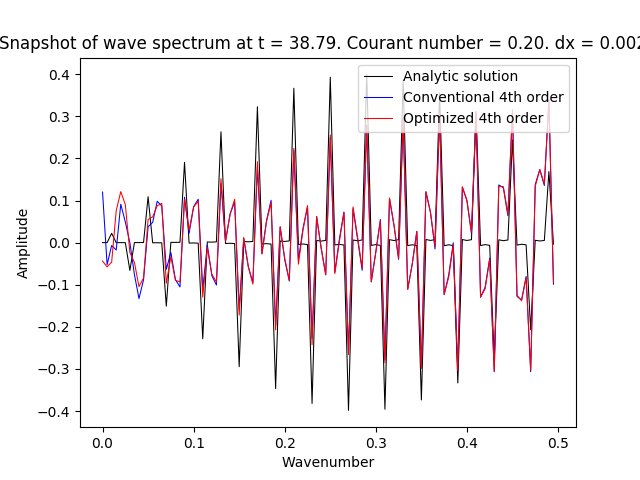

<IPython.core.display.Javascript object>


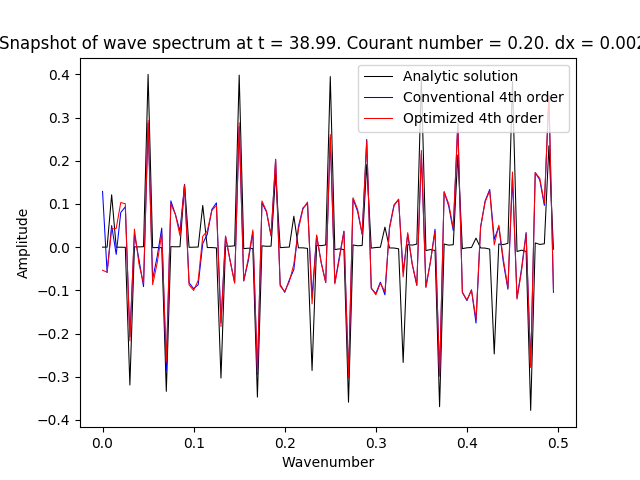

<IPython.core.display.Javascript object>


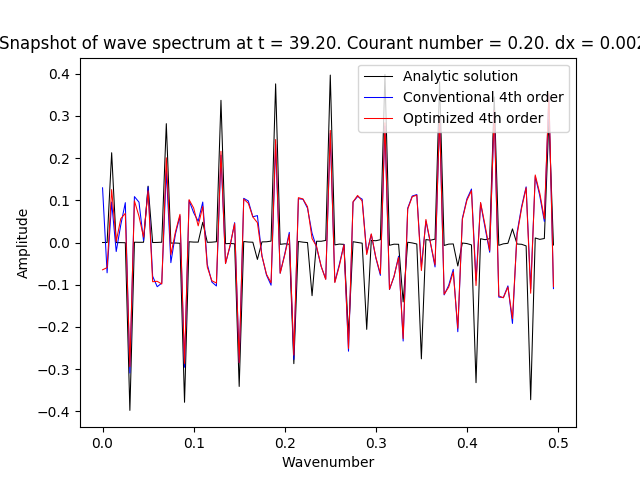

<IPython.core.display.Javascript object>


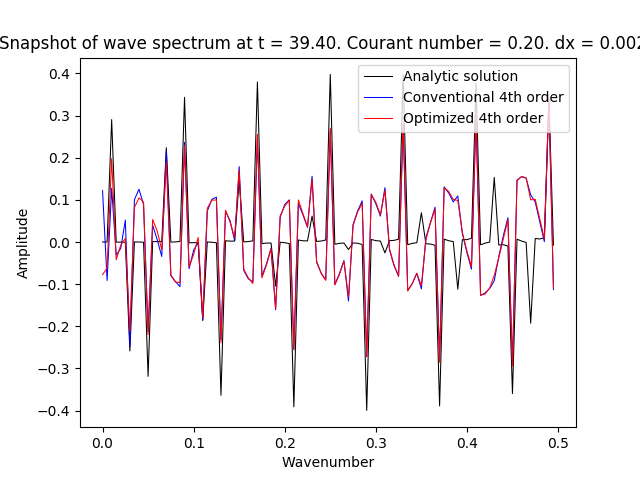

<IPython.core.display.Javascript object>


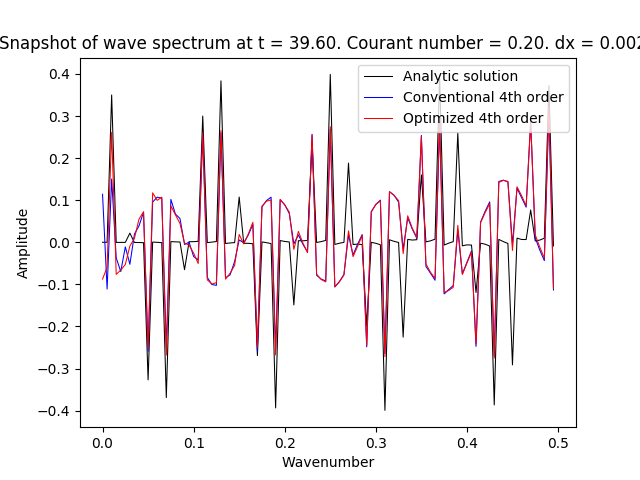

<IPython.core.display.Javascript object>


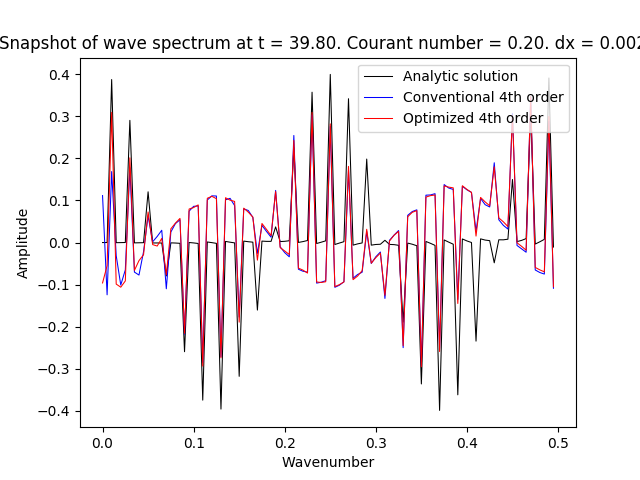

<IPython.core.display.Javascript object>


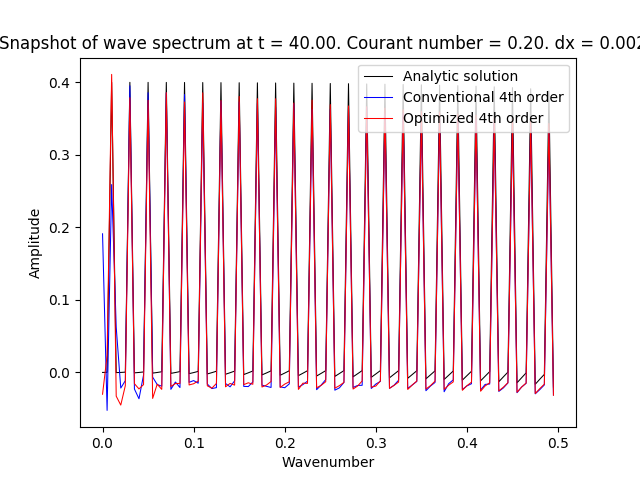

In [13]:
#Plot spectrums at each multiple of L/2
from numpy.fft import rfft
f_vals = linspace(0, L, (l/2+1))

fig = plt.figure()
plt.plot(f_vals[:100], rfft(0.1*u(x_vals, 0))[:100], 'k-', 
            label='Analytic solution', linewidth=0.75)

plt.plot(f_vals[:100], rfft(u_dev.data[1])[:100], 'b-', 
            label='Conventional 4th order', linewidth=0.75)

plt.plot(f_vals[:100], rfft(u_opt.data[1])[:100], 'r-', 
            label='Optimized 4th order', linewidth=0.75)
plt.title("Snapshot of wave spectrum at t = 0. Courant number = %.2f. dx = %.4f" % (dt/(L/(shape[0]-1)), L/l))
plt.xlabel("x")
plt.ylabel("u")
plt.legend(loc=1)
plt.savefig("Figures/Dx_0.0025/Spectrum_Snapshots/time0.00.png", dpi=200)
plt.show()

for i in linspace(0, t_end, t_end*5.):
    if i == 0:
        continue
    fig = plt.figure()
    plt.plot(f_vals[:100], rfft(0.1*u(x_vals, float(i)))[:100], 'k-', 
            label='Analytic solution', linewidth=0.75)

    plt.plot(f_vals[:100], rfft(u_dev.data[int(i*u_dev.data.shape[0]/t_end)-1])[:100], 'b-', 
            label='Conventional 4th order', linewidth=0.75)

    plt.plot(f_vals[:100], rfft(u_opt.data[int(i*u_dev.data.shape[0]/t_end)-1])[:100], 'r-', 
            label='Optimized 4th order', linewidth=0.75)
    plt.title("Snapshot of wave spectrum at t = %.2f. Courant number = %.2f. dx = %.4f" % (float(i), dt/(L/(shape[0]-1)), L/l))
    plt.xlabel("Wavenumber")
    plt.ylabel("Amplitude")
    plt.legend(loc=1)
    plt.savefig("Figures/Dx_0.0025/Spectrum_Snapshots/time%.2f.png" % (i), dpi=200)
    plt.show()

/home/ed/.local/lib/python3.6/site-packages/ipykernel/__main__.py:8: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.


<IPython.core.display.Javascript object>


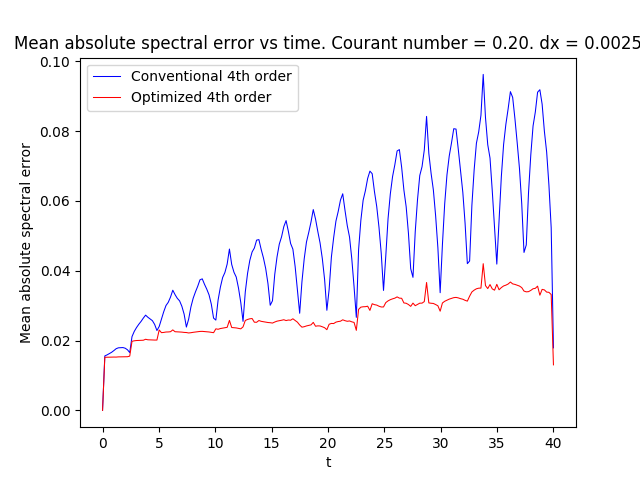

In [15]:
# Plot mean absolute frequency error vs time
from numpy import mean

time_list = [0]
err_dev_list = [mean(abs(rfft(0.1*u(x_vals, 0))-rfft(u_dev.data[1])))]
err_opt_list = [mean(abs(rfft(0.1*u(x_vals, 0))-rfft(u_opt.data[1])))]

for i in linspace(0, t_end, t_end*5.):
    if i == 0:
        continue
    time_list.append(i)
    err_dev_list.append(mean(abs(rfft(0.1*u(x_vals, float(i)))-rfft(u_dev.data[int(i*u_dev.data.shape[0]/t_end)-1]))))
    err_opt_list.append(mean(abs(rfft(0.1*u(x_vals, float(i)))-rfft(u_opt.data[int(i*u_opt.data.shape[0]/t_end)-1]))))
    
fig = plt.figure()
plt.plot(time_list, err_dev_list, 'b-', 
            label='Conventional 4th order', linewidth=0.75)

plt.plot(time_list, err_opt_list, 'r-', 
            label='Optimized 4th order', linewidth=0.75)
plt.title("Mean absolute spectral error vs time. Courant number = %.2f. dx = %.4f" % (dt/(L/(shape[0]-1)), L/l))
plt.xlabel("t")
plt.ylabel("Mean absolute spectral error")
plt.legend(loc=0)
plt.savefig("Figures/Dx_0.0025/mean_absolute_spectral_error", dpi=200)
plt.show()

In [17]:
print("Mean absolute error at t_end for conventional", mean(abs(0.1*u(x_vals, t_end)-u_dev.data[-2])))
print("Mean absolute error at t_end for optimized", mean(abs(0.1*u(x_vals, t_end)-u_opt.data[-2])))

Mean absolute error at t_end for conventional 0.0017125195438465791
Mean absolute error at t_end for optimized 0.00029089357249693784
